<h1 style='color:white; background:#50A8E3; border:0'><center>Acea Smart Water: Full EDA & Prediction</center></h1>


**The Acea Group is one of the leading Italian multiutility operators. Listed on the Italian Stock Exchange since 1999, the company manages and develops water and electricity networks and environmental services. Acea is the foremost Italian operator in the water services sector supplying 9 million inhabitants in Lazio, Tuscany, Umbria, Molise, Campania.**

**This competition uses nine different datasets, completely independent and not linked to each other. Each dataset can represent a different kind of waterbody. As each waterbody is different from the other, the related features as well are different from each other.**

<a id="section-start"></a>

<h2 style='color:white; background:#50A8E3; border:0'><center>Here you'll find:</center></h2>

* EDA
* Some ideas for predictions
* Predictions


1. [**Loading and a first look at the data**](#section-one) <br>
2. [**EDA**](#section-two) <br>
 [...Aquifer_Doganella](#section-three) <br>
 [...Aquifer_Auser](#section-four) <br>
 [...Water_Spring_Amiata](#section-five) <br>
 [...Lake_Bilancino](#section-six) <br>
 [...Water_Spring_Madonna_di_Canneto](#section-seven) <br>
 [...Aquifer_Luco](#section-eight) <br>
 [...Aquifer_Petrignano](#section-nine) <br>
 [...Water_Spring_Lupa](#section-ten) <br>
 [...River_Arno](#section-eleven) <br>
3. [**Feature overview and prediction**](#section-twelve) <br>
 [...River Arno (features)](#section-thirteen) <br>
 [...**River Arno (prediction)**](#section-1) <br>
 
 [...Lake Bilancino (features)](#section-fourteen) <br>
 [...**Lake Bilancino (prediction)**](#section-2) <br>
 
 [...Aquifer Petrignano (features)](#section-fifteen) <br>
 [...**Aquifer Petrignano (prediction)**](#section-3) <br>
 
 [...Aquifer Auser (features)](#section-nineteen) <br>
 [...**Aquifer Auser (prediction)**](#section-4) <br>
 
 [...Aquifer Doganella (features)](#section-twenty) <br>
 [...**Aquifer Doganella (prediction)**](#section-5) <br>
 
 [...Aquifer Luco (features)](#section-twentyone) <br>
 [...**Aquifer Luco (prediction)**](#section-6) <br>
 
 [...Water Spring Madonna di Canneto (features)](#section-sixteen) <br>
 [...**Water Spring Madonna di Canneto (prediction)**](#section-7) <br>
 
 [...Water Spring Lupa (features)](#section-seventeen) <br>
 [...**Water Spring Lupa (prediction)**](#section-8) <br>
 
 [...Water Spring Amiata (features)](#section-eighteen) <br>
 [...**Water Spring Amiata (prediction)**](#section-9) <br>

In [1]:
# loading packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import seaborn as sns
plt.rcParams['figure.dpi'] = 300

import matplotlib.dates as mdates

from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor

# ignoring warnings
import warnings
warnings.simplefilter("ignore")

In [3]:
#if work on local machine then
# !pip install kaggle
# !mkdir .kaggle 
# !cp D:\Cloud\hari@dasarpai-msi\config\kaggle.json .kaggle
#place kaggle.json in c:\users\hari\.kaggle folder 

# Download the ACEA Water Prediction competition dataset
!kaggle competitions download -c acea-water-prediction




  0%|          | 0.00/780k [00:00<?, ?B/s]
100%|██████████| 780k/780k [00:01<00:00, 580kB/s]
100%|██████████| 780k/780k [00:01<00:00, 579kB/s]


In [17]:
!unzip acea-water-prediction -d data/

Archive:  acea-water-prediction.zip
  inflating: data/Aquifer_Auser.csv  
  inflating: data/Aquifer_Doganella.csv  
  inflating: data/Aquifer_Luco.csv   
  inflating: data/Aquifer_Petrignano.csv  
  inflating: data/Lake_Bilancino.csv  
  inflating: data/River_Arno.csv     
  inflating: data/Water_Spring_Amiata.csv  
  inflating: data/Water_Spring_Lupa.csv  
  inflating: data/Water_Spring_Madonna_di_Canneto.csv  
  inflating: data/datasets_description.ods  
  inflating: data/datasets_description.xlsx  


<a id="section-one"></a>
<h1 style='color:white; background:#50A8E3; border:0'><center>Loading and a first look at the data</center></h1>

[**Back to the table of contents**](#section-start)

In [12]:
!pwd

/d/github/DAI-Projects/Climate/Acea-Water-Body-Analysis-and-Prediction


In [20]:
# path = r'./data/acea-water-prediction'
path = r'./data'

In [21]:
Aquifer_Doganella = pd.read_csv(path + '/Aquifer_Doganella.csv', index_col = 'Date')
Aquifer_Auser = pd.read_csv(path + '/Aquifer_Auser.csv', index_col = 'Date')
Water_Spring_Amiata = pd.read_csv(path + '/Water_Spring_Amiata.csv', index_col = 'Date')
Lake_Bilancino = pd.read_csv(path + '/Lake_Bilancino.csv', index_col = 'Date')
Water_Spring_Madonna_di_Canneto = pd.read_csv(path + '/Water_Spring_Madonna_di_Canneto.csv', index_col = 'Date')
Aquifer_Luco = pd.read_csv(path + '/Aquifer_Luco.csv', index_col = 'Date')
Aquifer_Petrignano = pd.read_csv(path + '/Aquifer_Petrignano.csv', index_col = 'Date')
Water_Spring_Lupa = pd.read_csv(path + '/Water_Spring_Lupa.csv', index_col = 'Date')
River_Arno = pd.read_csv(path + '/River_Arno.csv', index_col = 'Date')

print('Datasets shape:')
print('*'*30)
print('Aquifer_Doganella: {}'.format(Aquifer_Doganella.shape))
print('Aquifer_Auser: {}'.format(Aquifer_Auser.shape))
print('Water_Spring_Amiata: {}'.format(Water_Spring_Amiata.shape))
print('Lake_Bilancino: {}'.format(Lake_Bilancino.shape))
print('Water_Spring_Madonna_di_Canneto: {}'.format(Water_Spring_Madonna_di_Canneto.shape))
print('Aquifer_Luco: {}'.format(Aquifer_Luco.shape))
print('Aquifer_Petrignano: {}'.format(Aquifer_Petrignano.shape))
print('Water_Spring_Lupa: {}'.format(Water_Spring_Lupa.shape))
print('River_Arno: {}'.format(River_Arno.shape))

Datasets shape:
******************************
Aquifer_Doganella: (6026, 21)
Aquifer_Auser: (8154, 26)
Water_Spring_Amiata: (7487, 15)
Lake_Bilancino: (6603, 8)
Water_Spring_Madonna_di_Canneto: (3113, 3)
Aquifer_Luco: (7487, 21)
Aquifer_Petrignano: (5223, 7)
Water_Spring_Lupa: (4199, 2)
River_Arno: (8217, 16)


In [22]:
datasets = [Aquifer_Doganella, Aquifer_Auser, Water_Spring_Amiata,
            Lake_Bilancino, Water_Spring_Madonna_di_Canneto, Aquifer_Luco,
            Aquifer_Petrignano, Water_Spring_Lupa, River_Arno]

datasets_names = ['Aquifer_Doganella', 'Aquifer_Auser', 'Water_Spring_Amiata',
                'Lake_Bilancino', 'Water_Spring_Madonna_di_Canneto', 'Aquifer_Luco',
                'Aquifer_Petrignano', 'Water_Spring_Lupa', 'River_Arno']

In [23]:
print('Datasets dtypes:')
print('*'*30)
for i in range(len(datasets)):
    print('{}: \n{}'.format(datasets_names[i], datasets[i].dtypes.value_counts()))
    print('-'*20)

Datasets dtypes:
******************************
Aquifer_Doganella: 
float64    21
Name: count, dtype: int64
--------------------
Aquifer_Auser: 
float64    26
Name: count, dtype: int64
--------------------
Water_Spring_Amiata: 
float64    15
Name: count, dtype: int64
--------------------
Lake_Bilancino: 
float64    8
Name: count, dtype: int64
--------------------
Water_Spring_Madonna_di_Canneto: 
float64    3
Name: count, dtype: int64
--------------------
Aquifer_Luco: 
float64    21
Name: count, dtype: int64
--------------------
Aquifer_Petrignano: 
float64    7
Name: count, dtype: int64
--------------------
Water_Spring_Lupa: 
float64    2
Name: count, dtype: int64
--------------------
River_Arno: 
float64    16
Name: count, dtype: int64
--------------------


<a id="section-two"></a>
<h1 style='color:white; background:#50A8E3; border:0'><center>EDA</center></h1>

[**Back to the table of contents**](#section-start)

In [24]:
def bar_plot(x, y, title, palette_len, xlim = None, ylim = None, 
             xticklabels = None, yticklabels = None, 
             top_visible = False, right_visible = False, 
             bottom_visible = True, left_visible = False,
             xlabel = None, ylabel = None, figsize = (10, 4),
             axis_grid = 'y'):
    fig, ax = plt.subplots(figsize = figsize)
    plt.title(title, size = 15, fontweight = 'bold', fontfamily = 'serif')

    for i in ['top', 'right', 'bottom', 'left']:
        ax.spines[i].set_color('black')
    
    ax.spines['top'].set_visible(top_visible)
    ax.spines['right'].set_visible(right_visible)
    ax.spines['bottom'].set_visible(bottom_visible)
    ax.spines['left'].set_visible(left_visible)

    sns.barplot(x = x, y = y, edgecolor = 'black', ax = ax,
                palette = reversed(sns.color_palette("viridis", len(palette_len))))
    ax.set_xlim(xlim)
    ax.set_ylim(ylim)    
    ax.set_xticklabels(xticklabels, fontfamily = 'serif')
    ax.set_yticklabels(yticklabels, fontfamily = 'serif')
    plt.xlabel(xlabel, fontfamily = 'serif')
    plt.ylabel(ylabel, fontfamily = 'serif')
    ax.grid(axis = axis_grid, linestyle = '--', alpha = 0.9)
    plt.show()

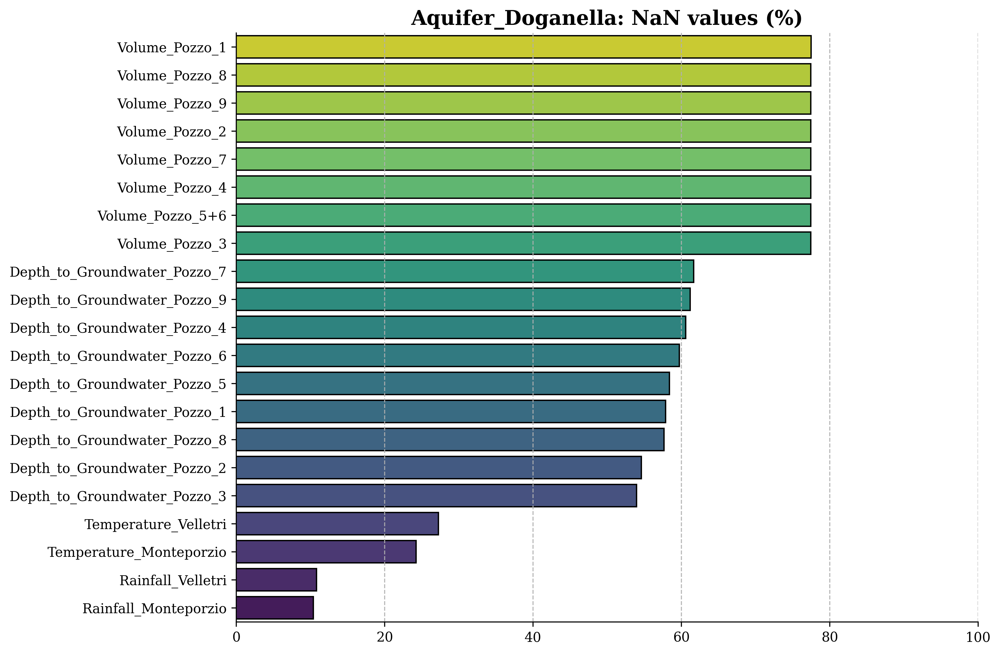

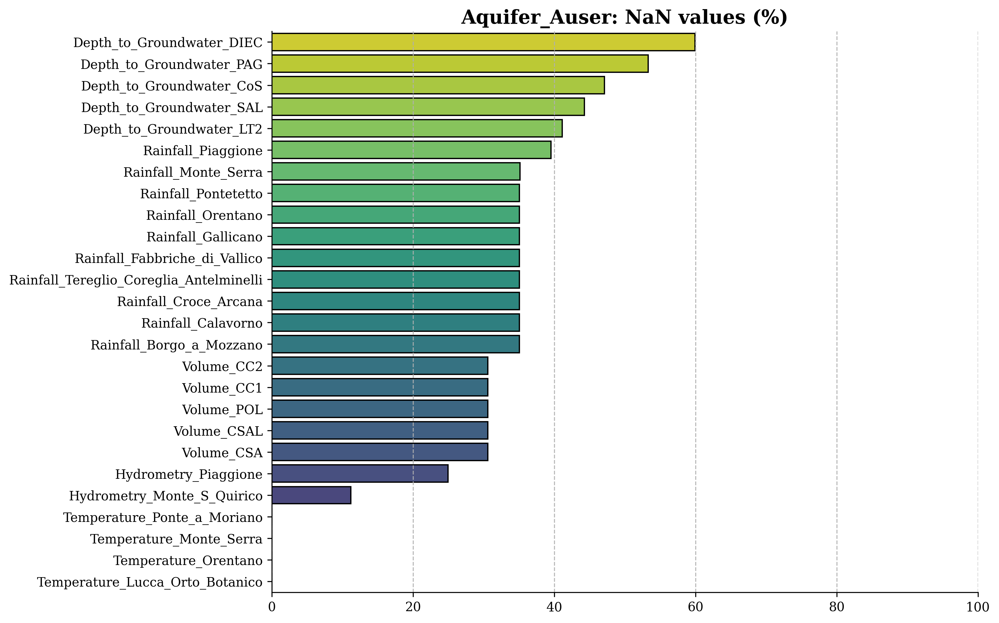

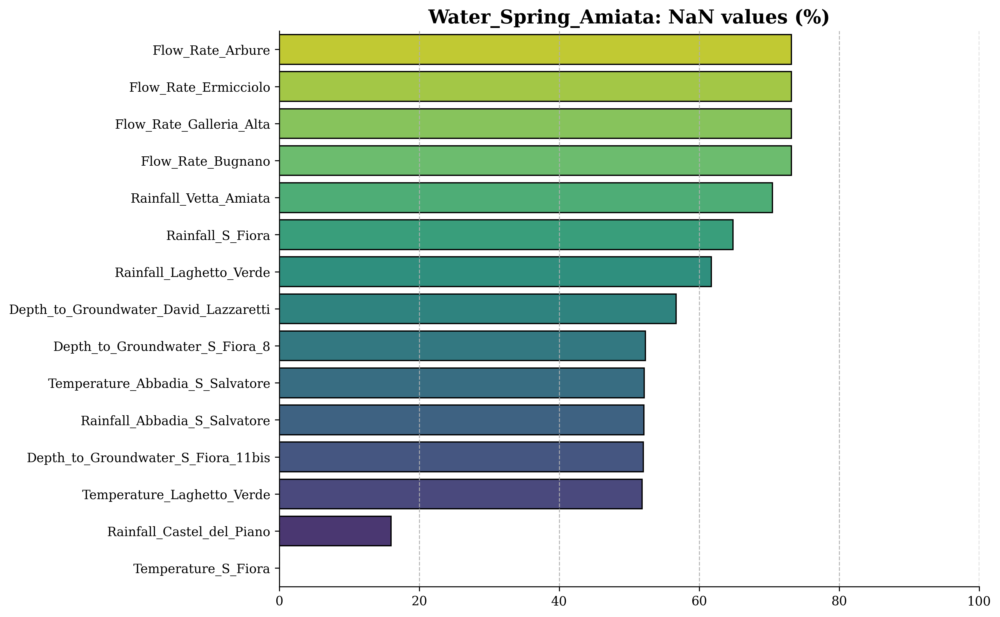

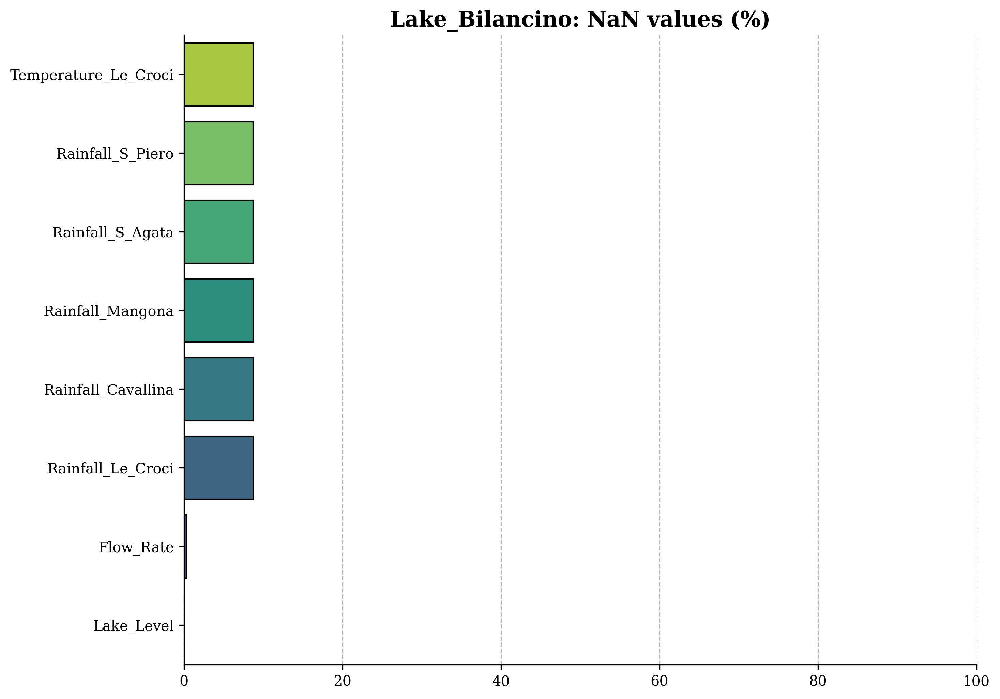

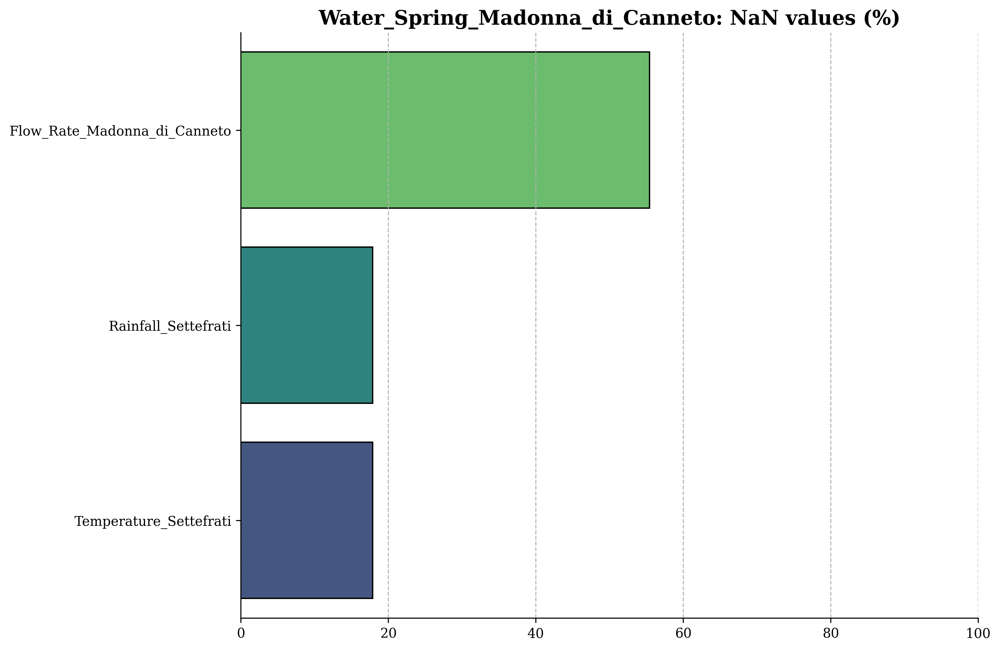

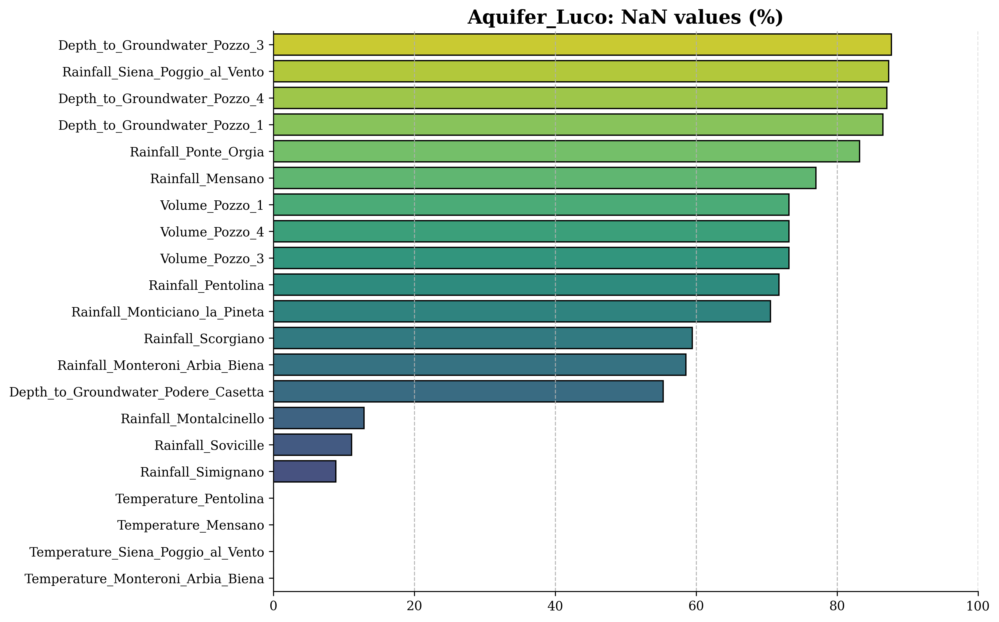

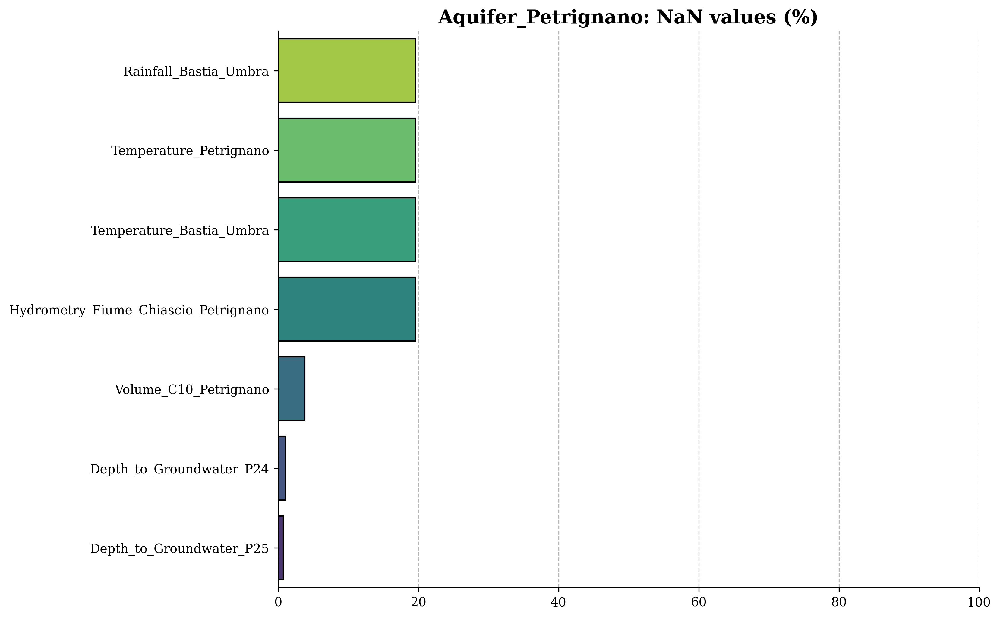

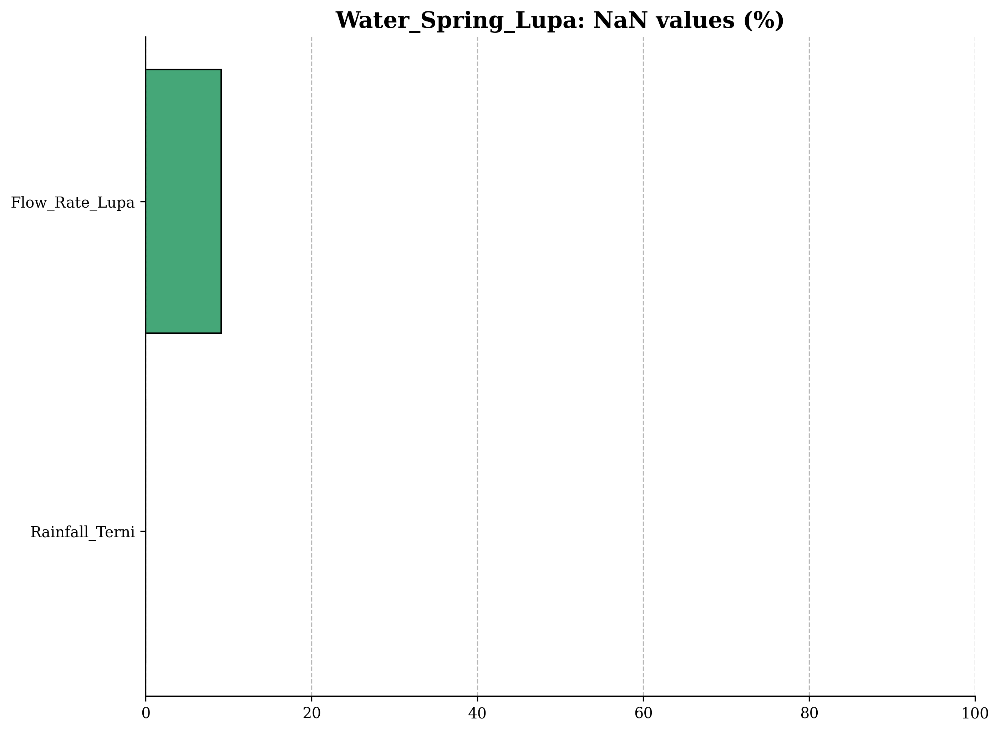

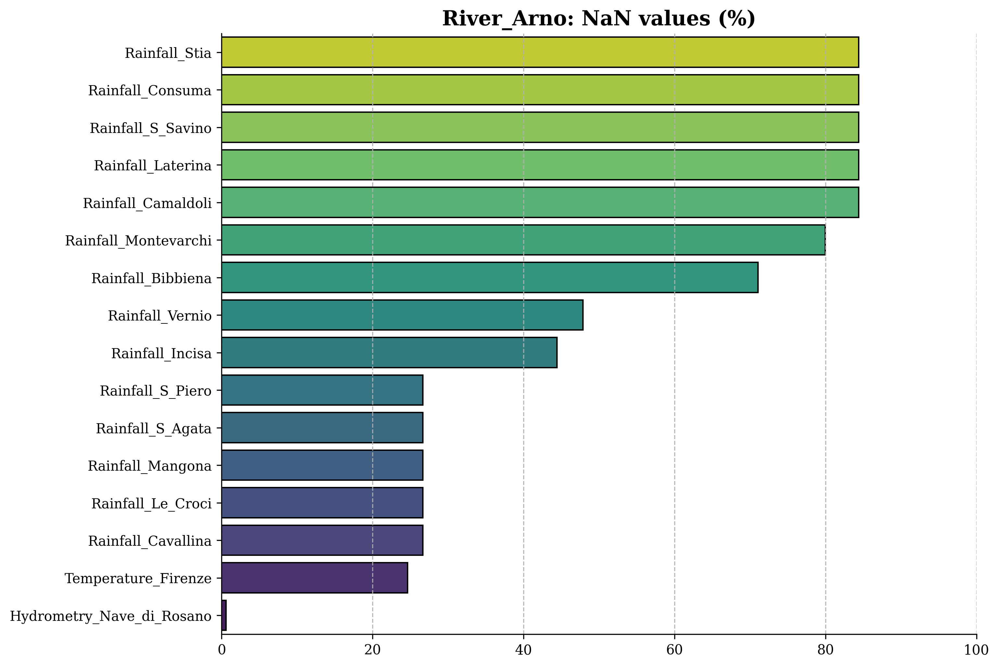

In [25]:
for i in range(len(datasets)):
    NaN_values = (datasets[i].isnull().sum() / len(datasets[i]) * 100).sort_values(ascending = False)
    bar_plot(x = NaN_values, 
             y = NaN_values.index,
             title = '{}: NaN values (%)'.format(datasets_names[i]),
             palette_len = NaN_values.index, 
             xlim = (0, 100), 
             xticklabels = range(0, 101, 20),
             yticklabels = NaN_values.index,
             left_visible = True,
             figsize = (10, 8), axis_grid = 'x')

In [26]:
def line_plot(data, y, title, color,
              top_visible = False, right_visible = False, 
              bottom_visible = True, left_visible = False,
              ylabel = None, figsize = (10, 4), axis_grid = 'y'):
    fig, ax = plt.subplots(figsize = figsize)
    plt.title(title, size = 15, fontweight = 'bold', fontfamily = 'serif')

    for i in ['top', 'right', 'bottom', 'left']:
        ax.spines[i].set_color('black')
    
    ax.spines['top'].set_visible(top_visible)
    ax.spines['right'].set_visible(right_visible)
    ax.spines['bottom'].set_visible(bottom_visible)
    ax.spines['left'].set_visible(left_visible)
    
    sns.lineplot(x = range(len(data[y])), y = data[y], dashes = False, 
                 color = color, linewidth = .5)
    ax.xaxis.set_major_locator(plt.MaxNLocator(20))
    
    ax.set_xticks([])
    plt.xticks(rotation = 90)
    plt.xlabel('')
    plt.ylabel(ylabel, fontfamily = 'serif')
    ax.grid(axis = axis_grid, linestyle = '--', alpha = 0.9)
    plt.show()

def corr_plot(data,
              top_visible = False, right_visible = False, 
              bottom_visible = True, left_visible = False,
              ylabel = None, figsize = (15, 11), axis_grid = 'y'):
    fig, ax = plt.subplots(figsize = figsize)
    plt.title('Correlations (Pearson)', size = 15, fontweight = 'bold', fontfamily = 'serif')
    
    mask = np.triu(np.ones_like(data.corr(), dtype = bool))
    sns.heatmap(round(data.corr(), 2), mask = mask, cmap = 'viridis', annot = True)
    plt.show()
    
def columns_viz(data, color):
    for i in range(len(data.columns)):
        line_plot(data = data, y = data.columns[i],
                  color = color,
                  title = '{} dynamics'.format(data.columns[i]),
                  bottom_visible = False, figsize = (10, 2))

![](https://storage.cloud.google.com/kaggle-media/competitions/Acea/Screen%20Shot%202020-12-02%20at%2012.40.17%20PM.png)

### Aquifer ([Wikipedia](https://en.wikipedia.org/wiki/Aquifer))

An aquifer is an underground layer of water-bearing permeable rock, rock fractures or unconsolidated materials (gravel, sand, or silt).

![](https://upload.wikimedia.org/wikipedia/commons/thumb/0/04/Aquifer_en.svg/465px-Aquifer_en.svg.png)

### Spring ([Wikipedia](https://en.wikipedia.org/wiki/Spring_%28hydrology%29))

A spring is a point at which water flows from an aquifer to the Earth's surface. It is a component of the hydrosphere.

### River ([Wikipedia](https://en.wikipedia.org/wiki/River))

A river is a natural flowing watercourse, usually freshwater, flowing towards an ocean, sea, lake or another river. In some cases a river flows into the ground and becomes dry at the end of its course without reaching another body of water.

### Lake ([Wikipedia](https://en.wikipedia.org/wiki/Lake))

A lake is an area filled with water, localized in a basin, surrounded by land, apart from any river or other outlet that serves to feed or drain the lake.

<a id="section-three"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Doganella</center></h2>

[**Back to the table of contents**](#section-start)

Description: The wells field Doganella is fed by two underground aquifers not fed by rivers or lakes but fed by meteoric infiltration. The upper aquifer is a water table with a thickness of about 30m. The lower aquifer is a semi-confined artesian aquifer with a thickness of 50m and is located inside lavas and tufa products. These aquifers are accessed through wells called Well 1, ..., Well 9. Approximately 80% of the drainage volumes come from the artesian aquifer. The aquifer levels are influenced by the following parameters: rainfall, humidity, subsoil, temperatures and drainage volumes.

In [27]:
datasets[0].head()

,Rainfall_Monteporzio,Rainfall_Velletri,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_2,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Depth_to_Groundwater_Pozzo_5,Depth_to_Groundwater_Pozzo_6,Depth_to_Groundwater_Pozzo_7,Depth_to_Groundwater_Pozzo_8,...,Volume_Pozzo_1,Volume_Pozzo_2,Volume_Pozzo_3,Volume_Pozzo_4,Volume_Pozzo_5+6,Volume_Pozzo_7,Volume_Pozzo_8,Volume_Pozzo_9,Temperature_Monteporzio,Temperature_Velletri
Date,,,,,,,,,,,,,,,,,,,,,
01/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.30,8.60
02/01/2004,0.2,0.8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.70,6.25
03/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.40,9.80
04/01/2004,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.35,5.95
05/01/2004,0.2,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.60,5.85


In [28]:
print('The earliest date: \t%s' %datasets[0].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[0].index.values[[0, -1]][1])

The earliest date: 	01/01/2004
The latest date: 	30/06/2020


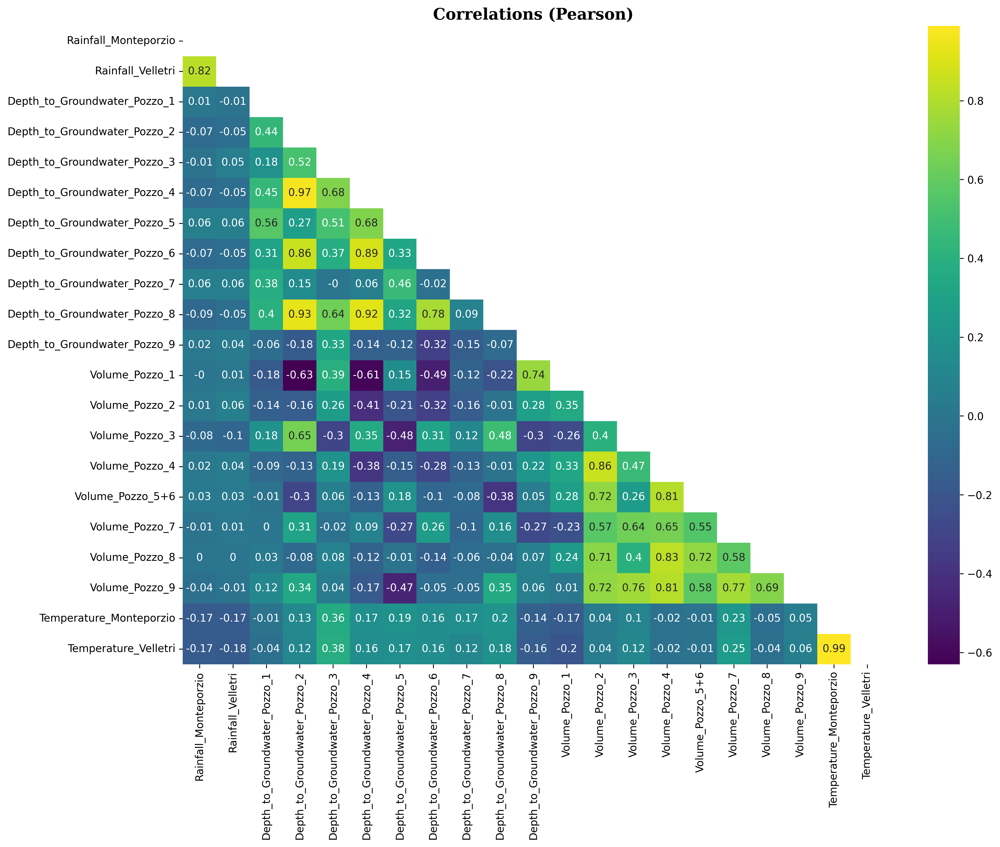

In [29]:
corr_plot(datasets[0])

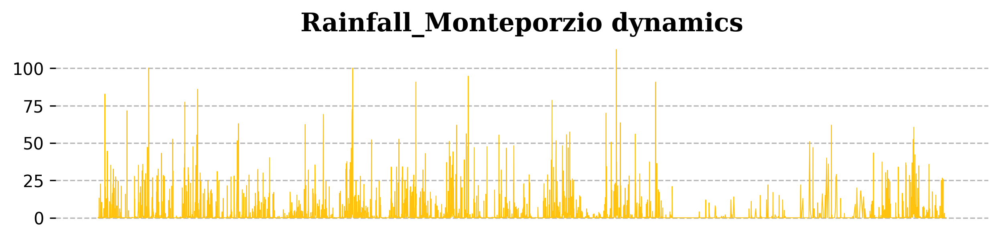

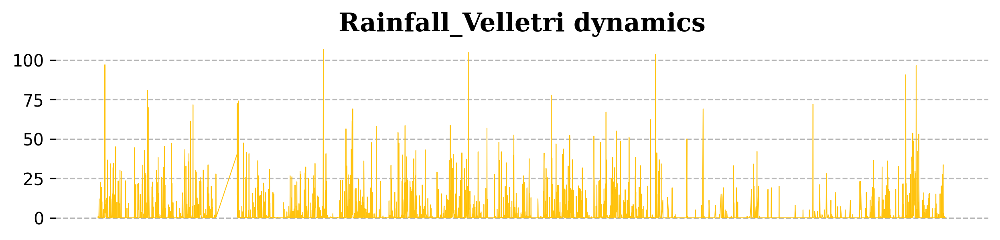

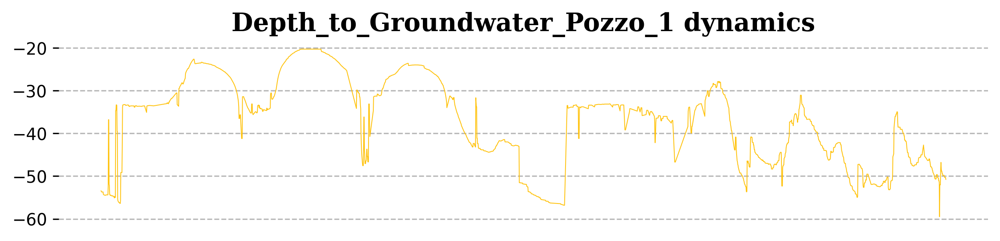

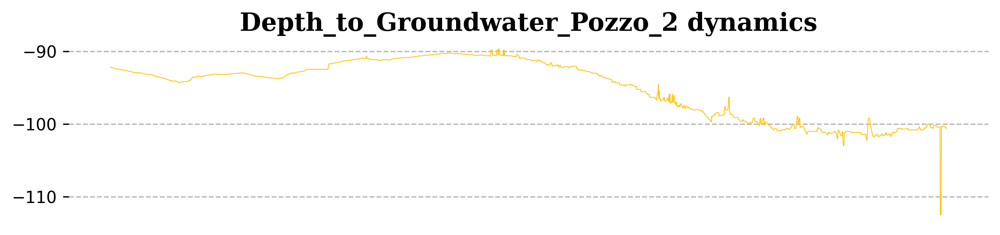

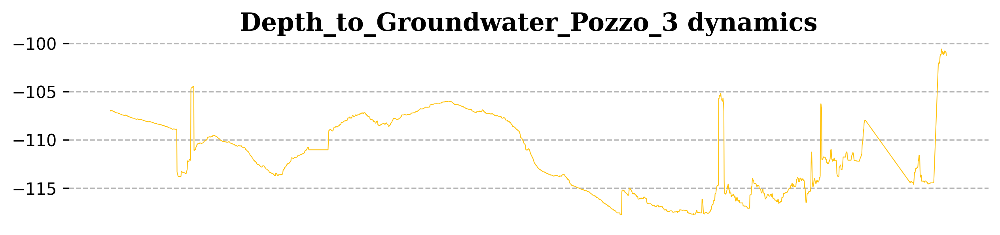

...

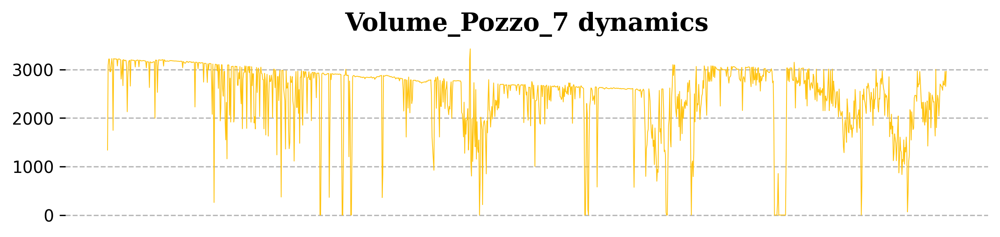

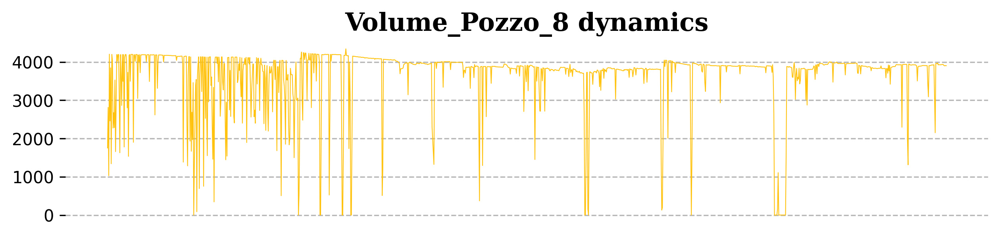

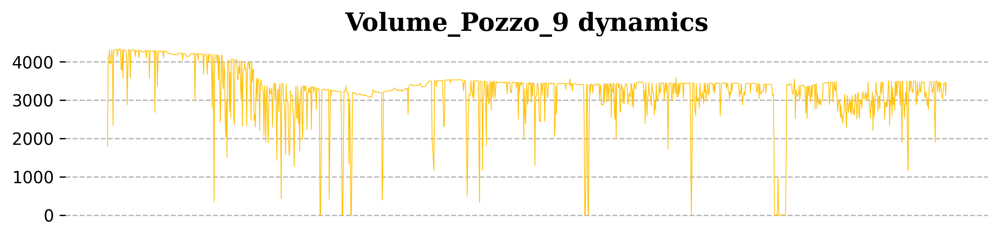

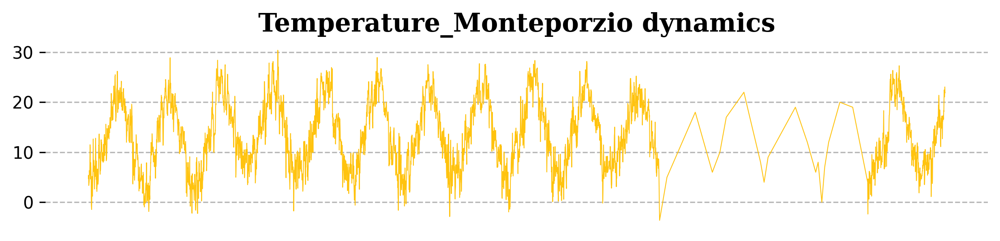

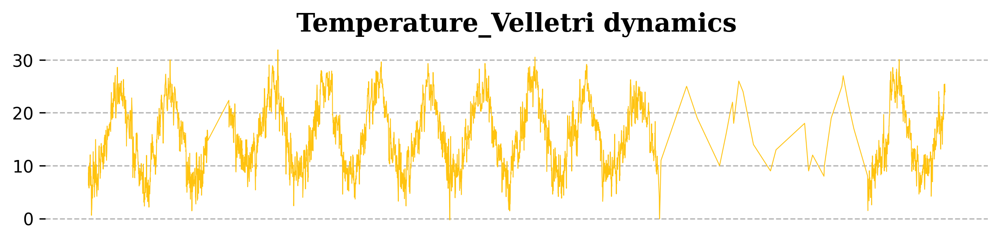

In [30]:
columns_viz(datasets[0], color = '#FFC30F')

<a id="section-four"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Auser</center></h2>

[**Back to the table of contents**](#section-start)

Description: This waterbody consists of two subsystems, called NORTH and SOUTH, where the former partly influences the behavior of the latter. Indeed, the north subsystem is a water table (or unconfined) aquifer while the south subsystem is an artesian (or confined) groundwater.

The levels of the NORTH sector are represented by the values of the SAL, PAG, CoS and DIEC wells, while the levels of the SOUTH sector by the LT2 well.

In [31]:
datasets[1].head()

,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,...,Temperature_Monte_Serra,Temperature_Ponte_a_Moriano,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Volume_CSA,Volume_CSAL,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione
Date,,,,,,,,,,,,,,,,,,,,,
05/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
06/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,10.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN
07/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,9.2,0.0,10.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
08/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.4,0.0,13.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN
09/03/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.4,0.0,12.85,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [32]:
print('The earliest date: \t%s' %datasets[1].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[1].index.values[[0, -1]][1])

The earliest date: 	05/03/1998
The latest date: 	30/06/2020


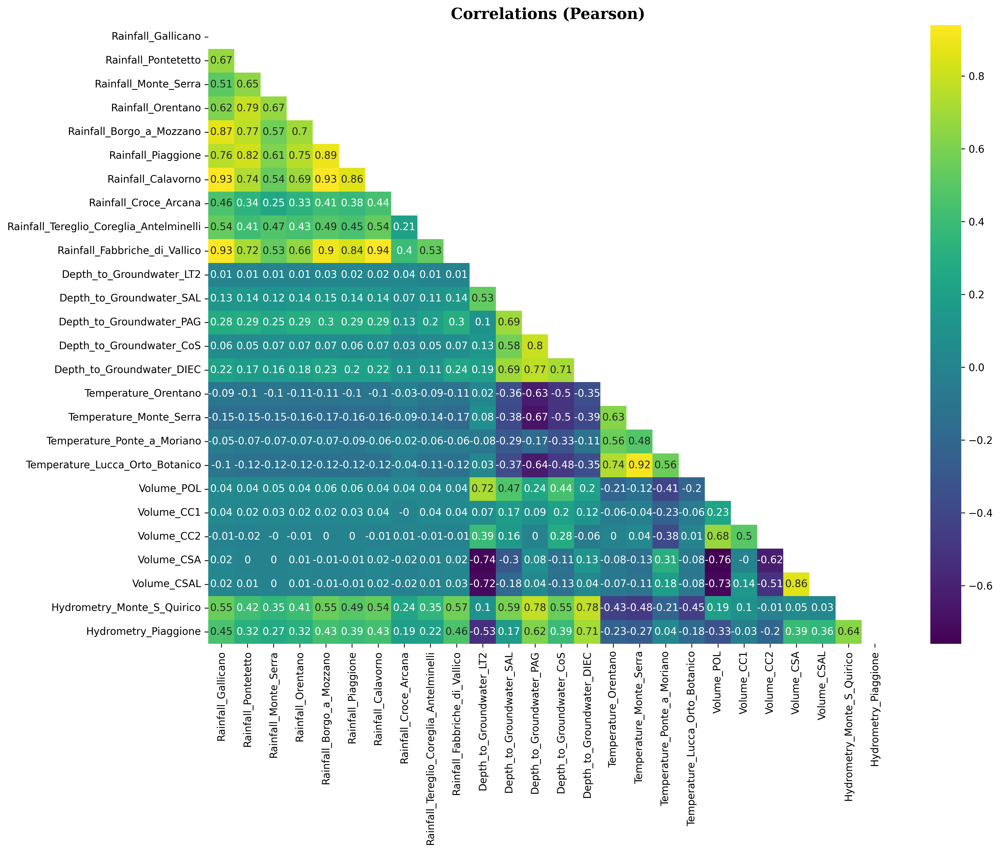

In [33]:
corr_plot(datasets[1])

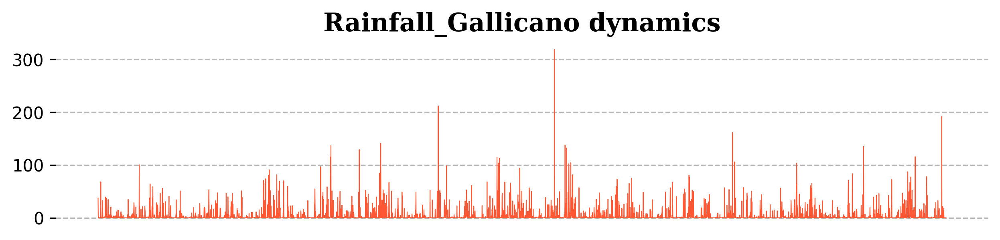

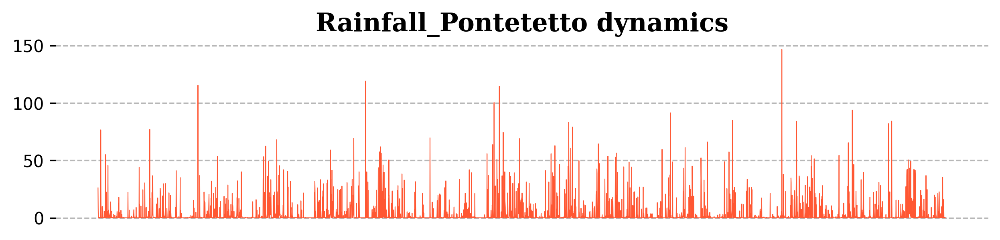

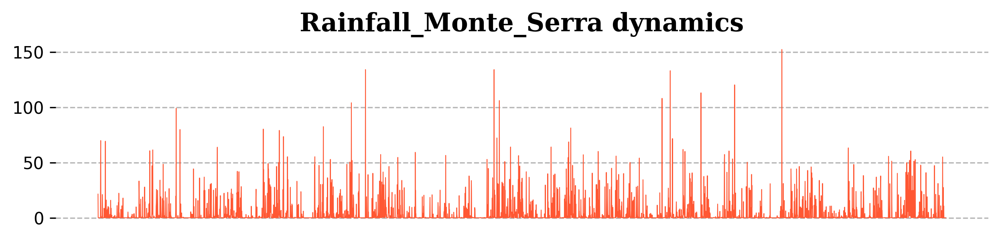

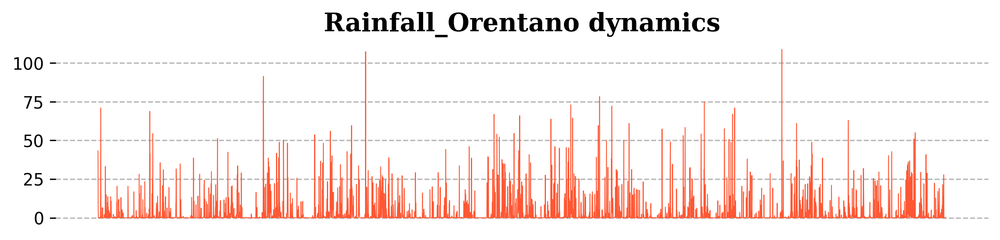

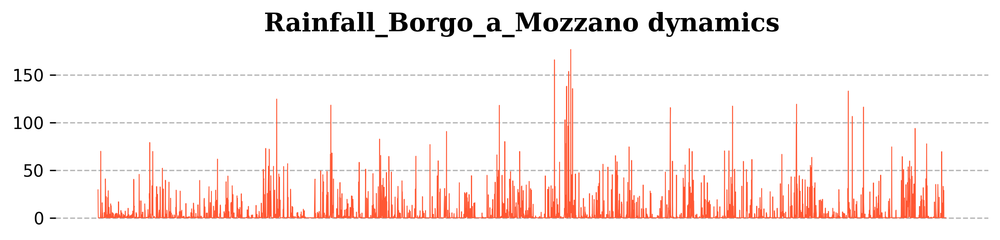

...

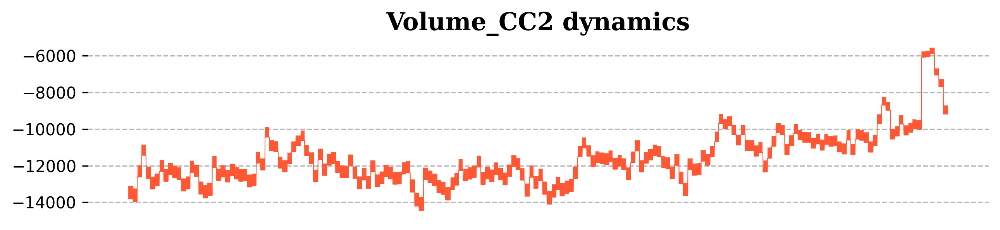

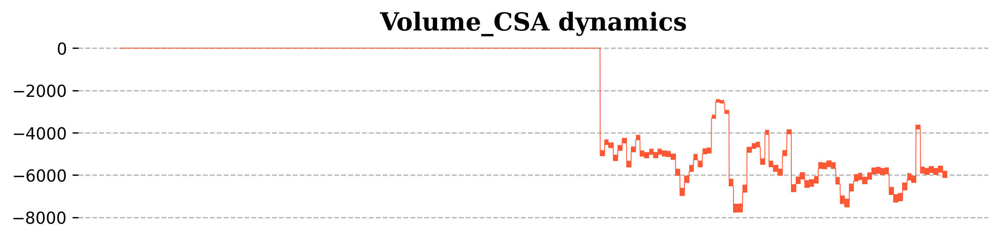

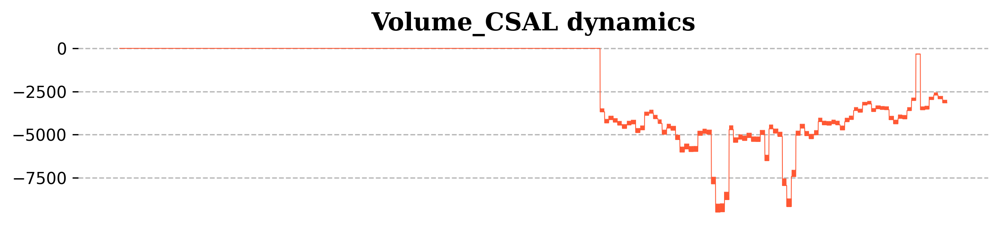

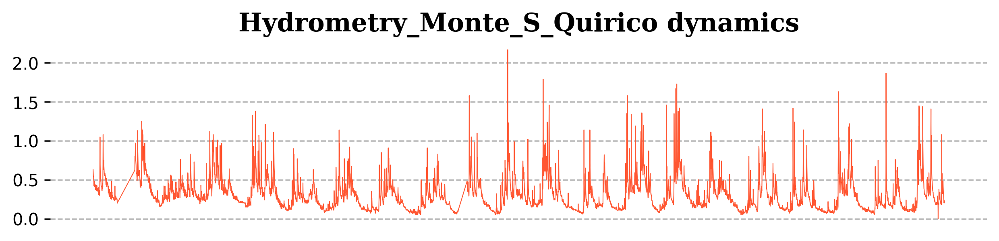

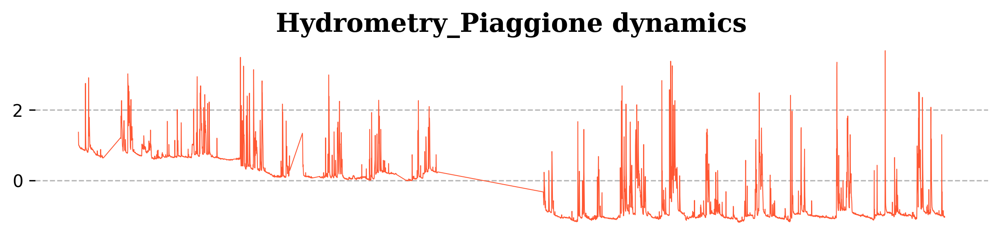

In [34]:
columns_viz(datasets[1], color = '#FF5733')

<a id="section-five"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Amiata</center></h2>

[**Back to the table of contents**](#section-start)

Description: The Amiata waterbody is composed of a volcanic aquifer not fed by rivers or lakes but fed by meteoric infiltration. This aquifer is accessed through Ermicciolo, Arbure, Bugnano and Galleria Alta water springs. The levels and volumes of the four sources are influenced by the parameters: rainfall, depth to groundwater, hydrometry, temperatures and drainage volumes.

In [35]:
datasets[2].head()

,Rainfall_Castel_del_Piano,Rainfall_Abbadia_S_Salvatore,Rainfall_S_Fiora,Rainfall_Laghetto_Verde,Rainfall_Vetta_Amiata,Depth_to_Groundwater_S_Fiora_8,Depth_to_Groundwater_S_Fiora_11bis,Depth_to_Groundwater_David_Lazzaretti,Temperature_Abbadia_S_Salvatore,Temperature_S_Fiora,Temperature_Laghetto_Verde,Flow_Rate_Bugnano,Flow_Rate_Arbure,Flow_Rate_Ermicciolo,Flow_Rate_Galleria_Alta
Date,,,,,,,,,,,,,,,
01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.15,NaN,NaN,NaN,NaN,NaN
02/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.55,NaN,NaN,NaN,NaN,NaN
03/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.70,NaN,NaN,NaN,NaN,NaN
04/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.00,NaN,NaN,NaN,NaN,NaN
05/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.60,NaN,NaN,NaN,NaN,NaN


In [36]:
print('The earliest date: \t%s' %datasets[2].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[2].index.values[[0, -1]][1])

The earliest date: 	01/01/2000
The latest date: 	30/06/2020


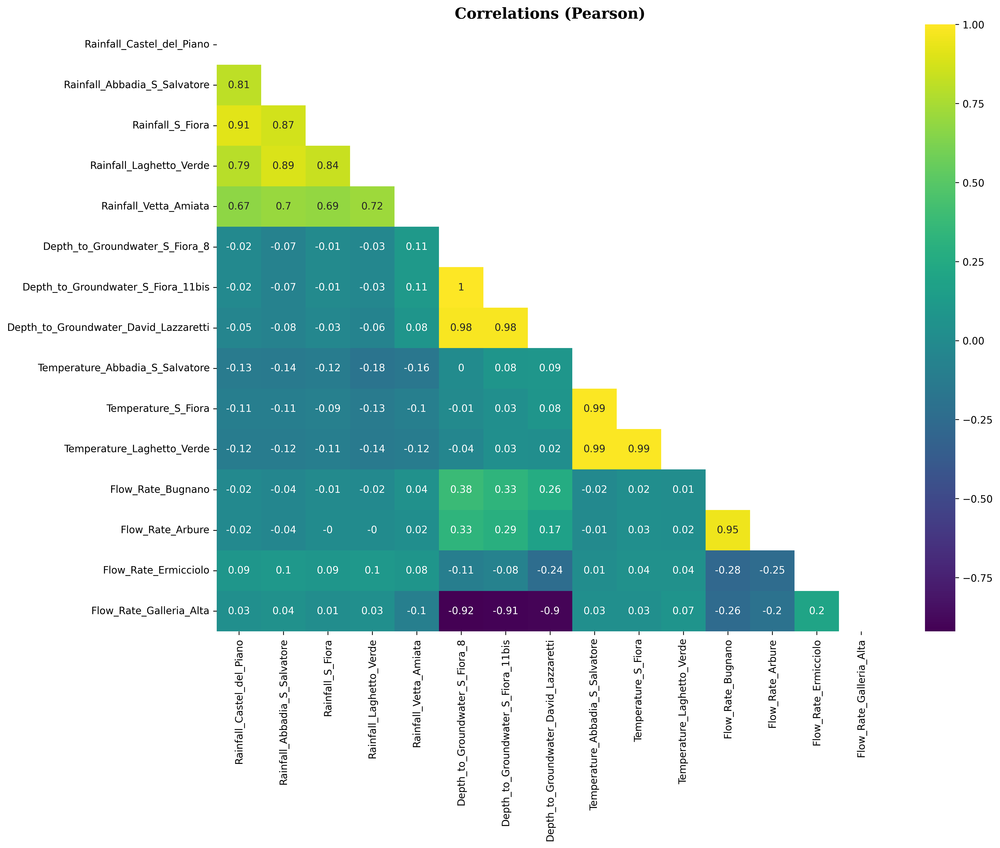

In [37]:
corr_plot(datasets[2])

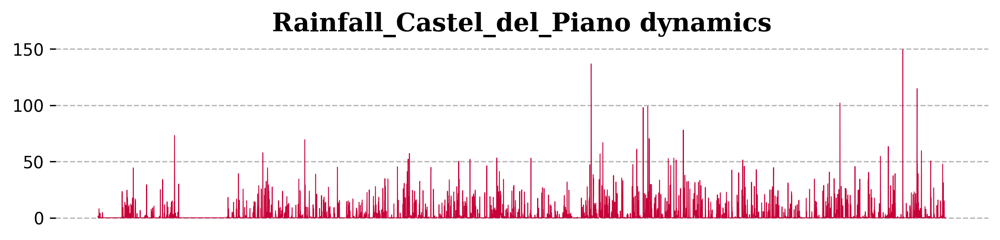

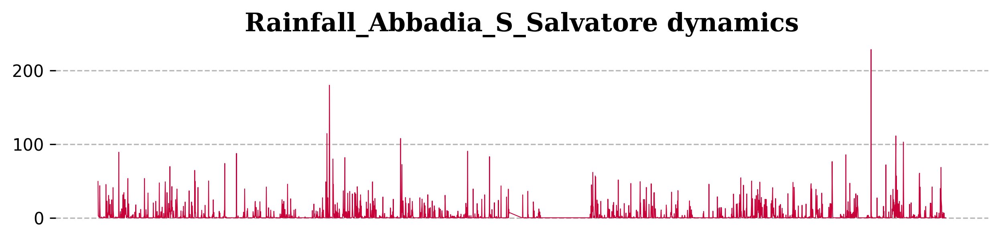

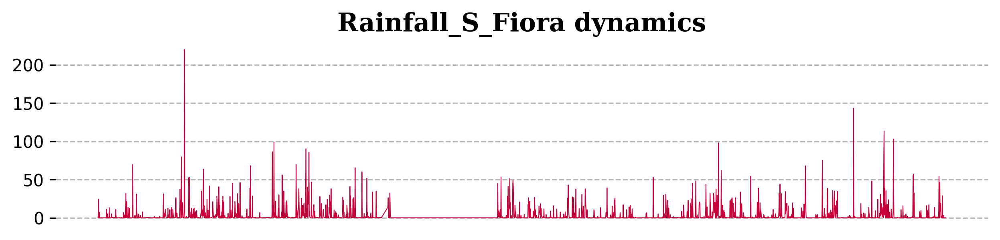

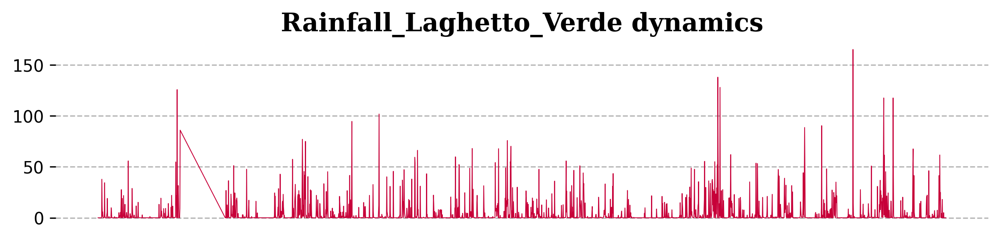

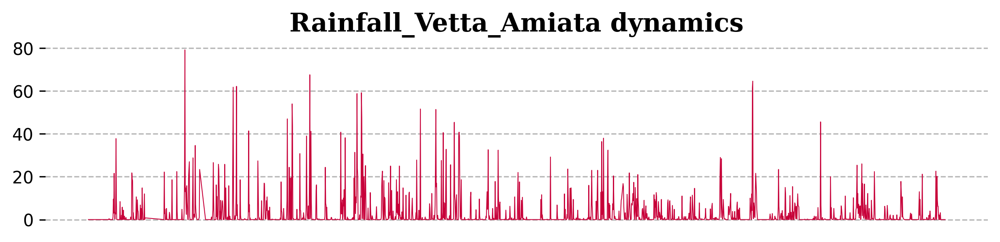

...

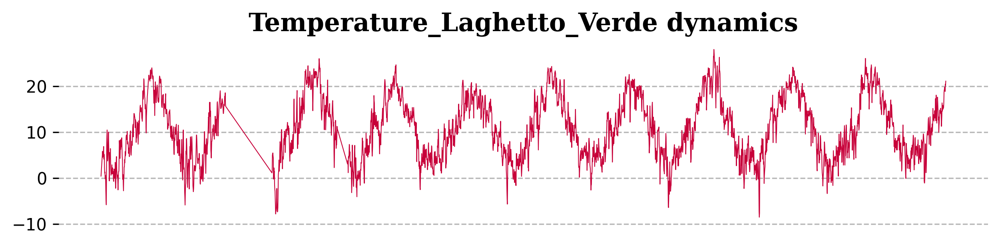

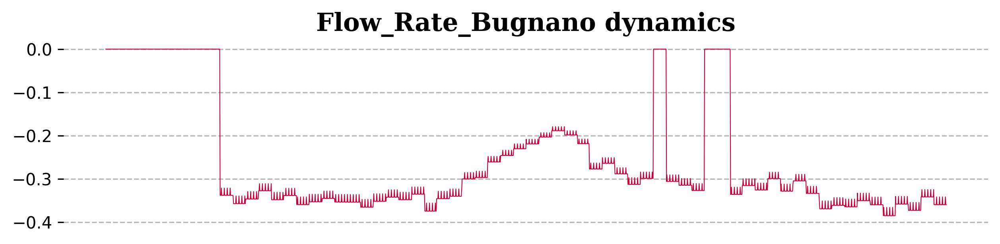

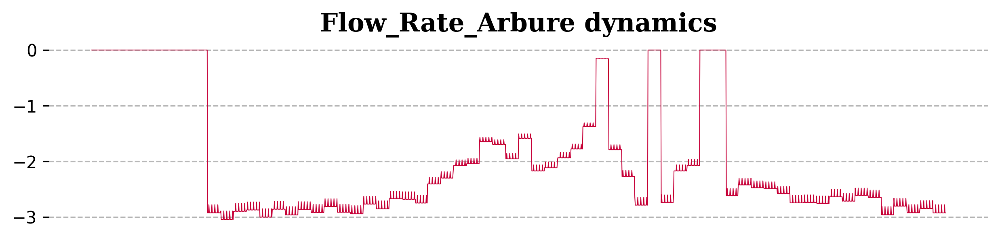

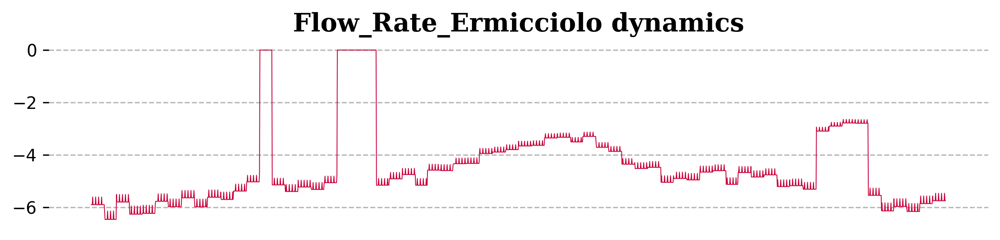

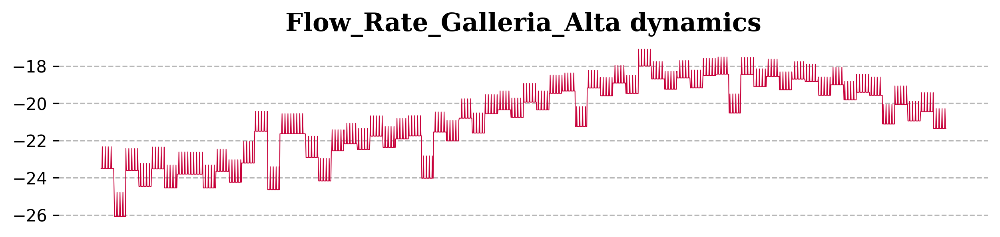

In [38]:
columns_viz(datasets[2], color = '#C70039')

<a id="section-six"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Lake Bilancino</center></h2> 

[**Back to the table of contents**](#section-start)

Description: Bilancino lake is an artificial lake located in the municipality of Barberino di Mugello (about 50 km from Florence). It is used to refill the Arno river during the summer months. Indeed, during the winter months, the lake is filled up and then, during the summer months, the water of the lake is poured into the Arno river.

In [39]:
datasets[3].head()

,Rainfall_S_Piero,Rainfall_Mangona,Rainfall_S_Agata,Rainfall_Cavallina,Rainfall_Le_Croci,Temperature_Le_Croci,Lake_Level,Flow_Rate
Date,,,,,,,,
03/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
04/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
05/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
06/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.43,0.31
07/06/2002,NaN,NaN,NaN,NaN,NaN,NaN,249.44,0.31


In [40]:
print('The earliest date: \t%s' %datasets[3].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[3].index.values[[0, -1]][1])

The earliest date: 	03/06/2002
The latest date: 	30/06/2020


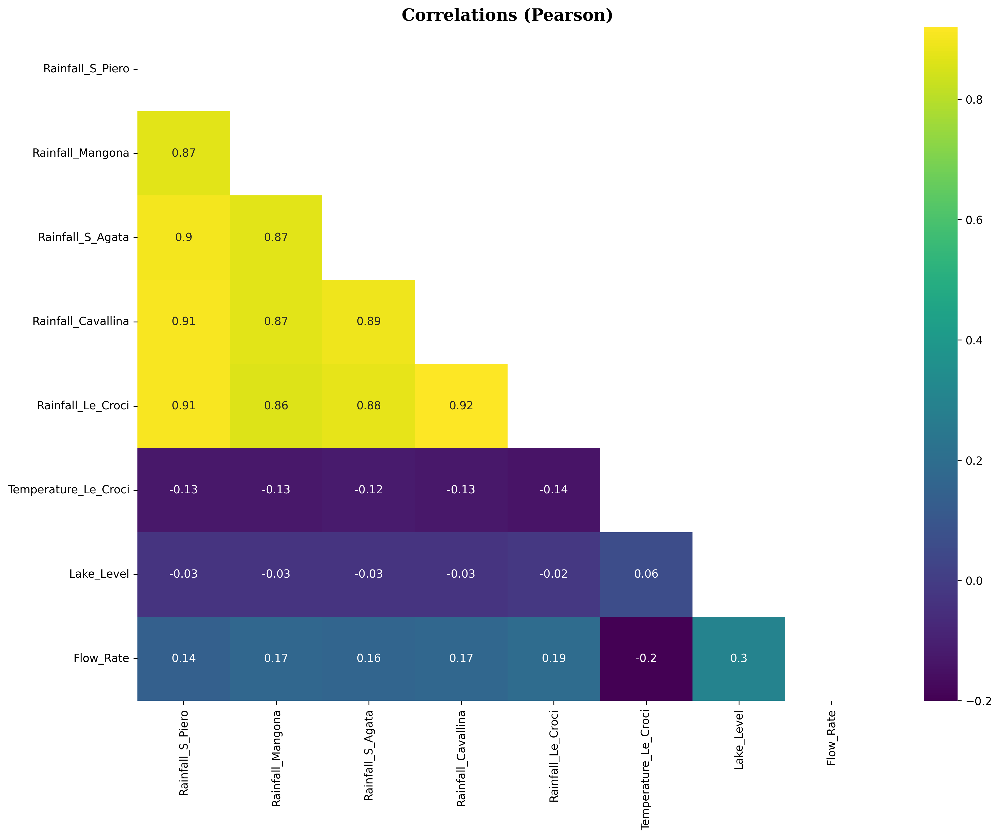

In [41]:
corr_plot(datasets[3])

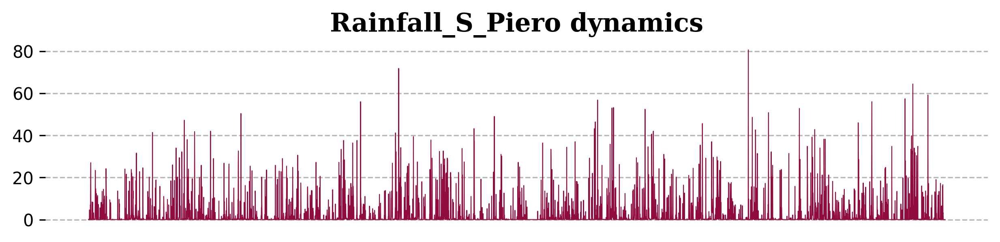

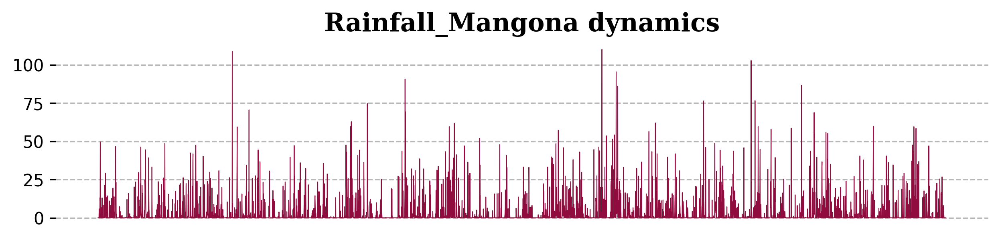

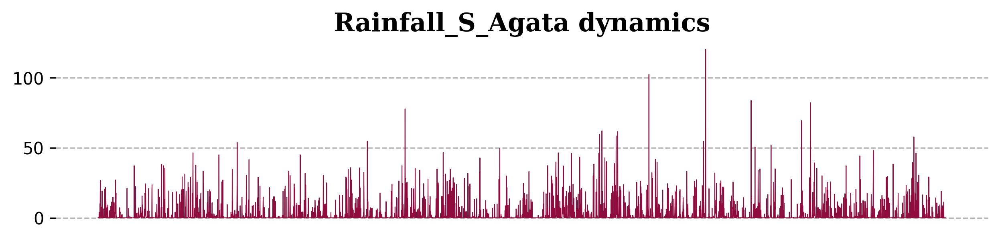

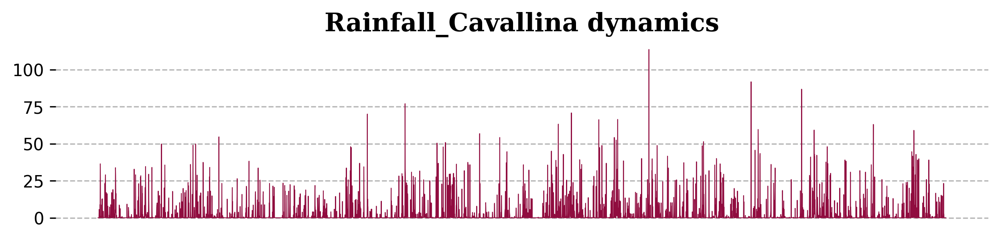

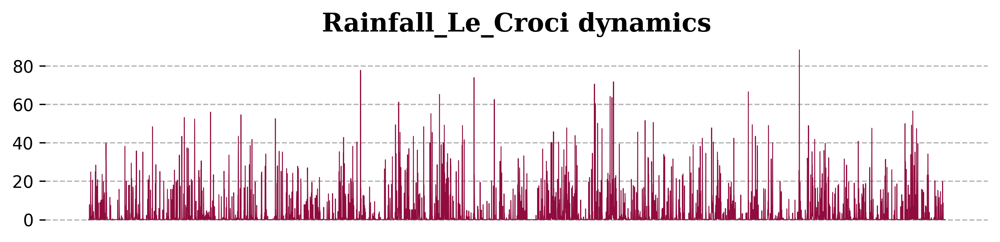

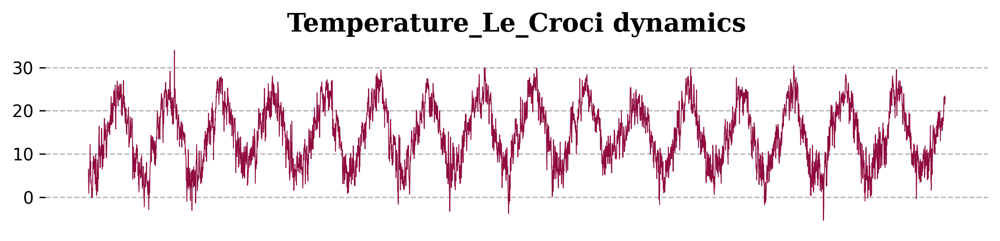

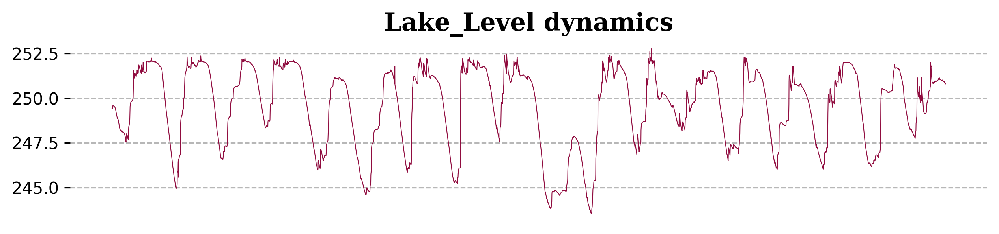

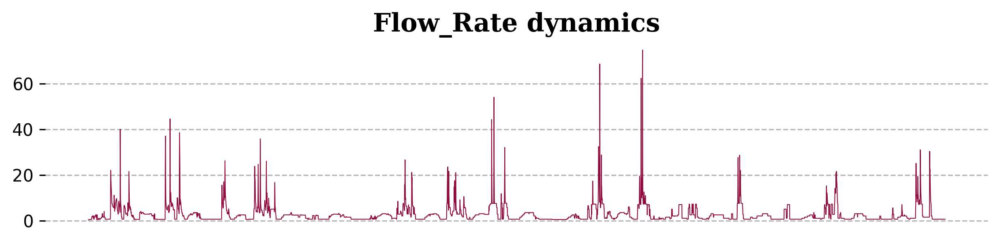

In [42]:
columns_viz(datasets[3], color = '#900C3F')

<a id="section-seven"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Madonna di Canneto</center></h2>

[**Back to the table of contents**](#section-start)

Description: The Madonna di Canneto spring is situated at an altitude of 1010m above sea level in the Canneto valley. It does not consist of an aquifer and its source is supplied by the water catchment area of the river Melfa.

In [43]:
datasets[4].head()

,Rainfall_Settefrati,Temperature_Settefrati,Flow_Rate_Madonna_di_Canneto
Date,,,
01/01/2012,0.0,5.25,NaN
02/01/2012,5.6,6.65,NaN
03/01/2012,10.0,8.85,NaN
04/01/2012,0.0,6.75,NaN
05/01/2012,1.0,5.55,NaN


In [44]:
print('The earliest date: \t%s' %datasets[4].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[4].index.dropna().values[[0, -1]][1])

The earliest date: 	01/01/2012
The latest date: 	30/06/2020


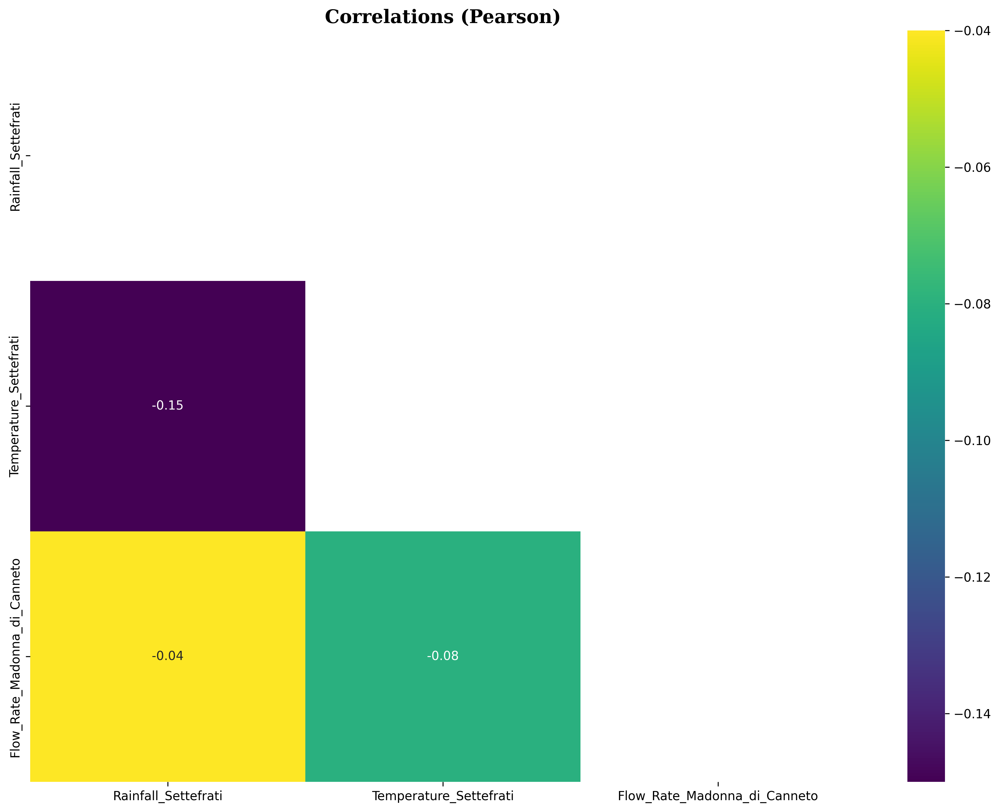

In [45]:
corr_plot(datasets[4])

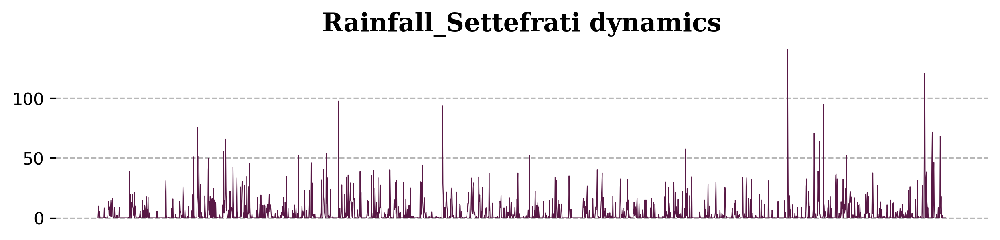

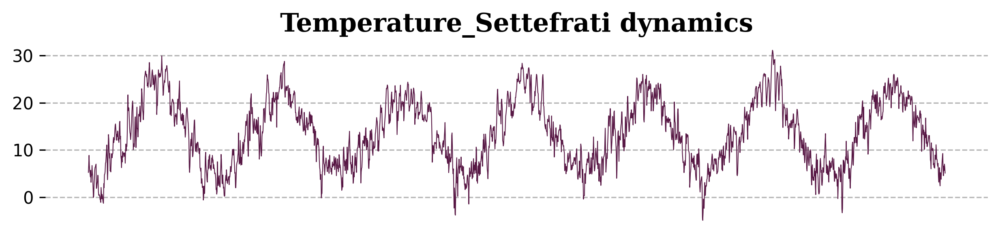

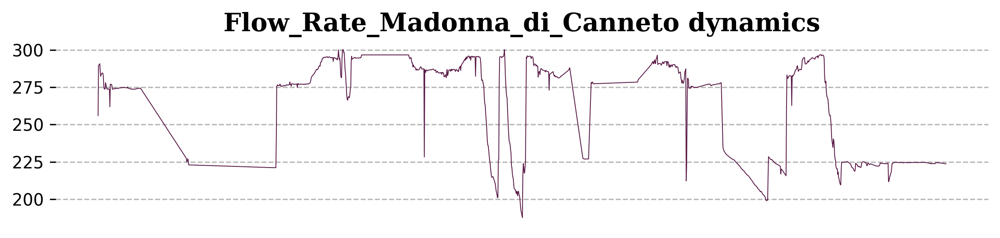

In [46]:
columns_viz(datasets[4], color = '#581845')

<a id="section-eight"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Luco</center></h2>

[**Back to the table of contents**](#section-start)

Description: The Luco wells field is fed by an underground aquifer. This aquifer not fed by rivers or lakes but by meteoric infiltration at the extremes of the impermeable sedimentary layers. Such aquifer is accessed through wells called Well 1, Well 3 and Well 4 and is influenced by the following parameters: rainfall, depth to groundwater, temperature and drainage volumes.

In [47]:
datasets[5].head()

,Rainfall_Simignano,Rainfall_Siena_Poggio_al_Vento,Rainfall_Mensano,Rainfall_Montalcinello,Rainfall_Monticiano_la_Pineta,Rainfall_Sovicille,Rainfall_Ponte_Orgia,Rainfall_Scorgiano,Rainfall_Pentolina,Rainfall_Monteroni_Arbia_Biena,...,Depth_to_Groundwater_Pozzo_1,Depth_to_Groundwater_Pozzo_3,Depth_to_Groundwater_Pozzo_4,Temperature_Siena_Poggio_al_Vento,Temperature_Mensano,Temperature_Pentolina,Temperature_Monteroni_Arbia_Biena,Volume_Pozzo_1,Volume_Pozzo_3,Volume_Pozzo_4
Date,,,,,,,,,,,,,,,,,,,,,
01/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,5.50,0.80,NaN,NaN,NaN
02/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,6.20,3.25,NaN,NaN,NaN
03/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.25,0.95,NaN,NaN,NaN
04/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.00,4.20,NaN,NaN,NaN
05/01/2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,0.0,0.0,7.90,6.55,NaN,NaN,NaN


In [48]:
print('The earliest date: \t%s' %datasets[5].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[5].index.values[[0, -1]][1])

The earliest date: 	01/01/2000
The latest date: 	30/06/2020


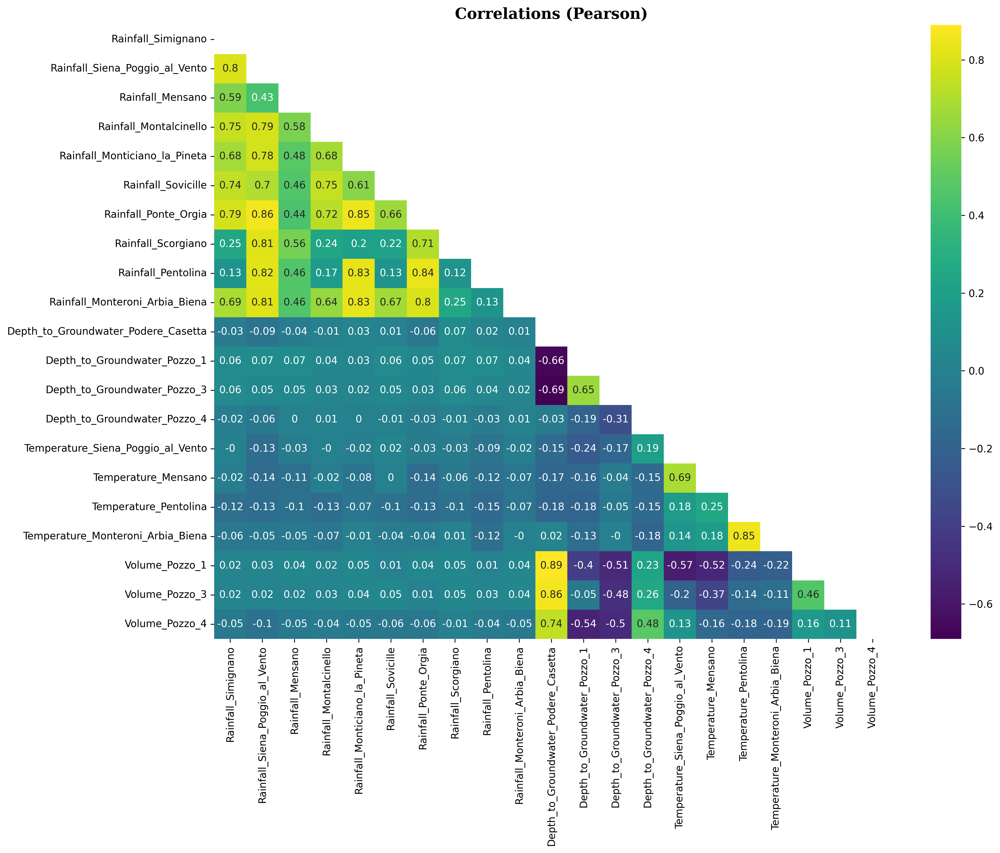

In [49]:
corr_plot(datasets[5])

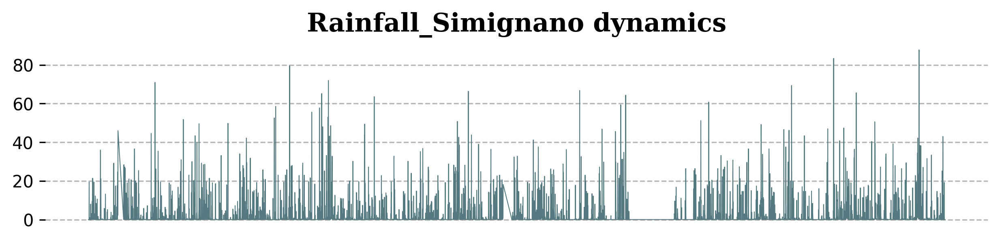

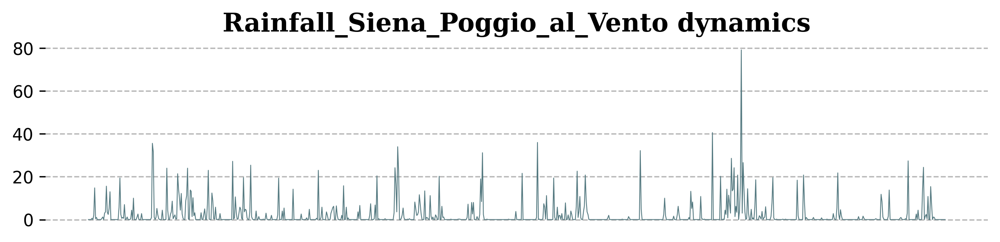

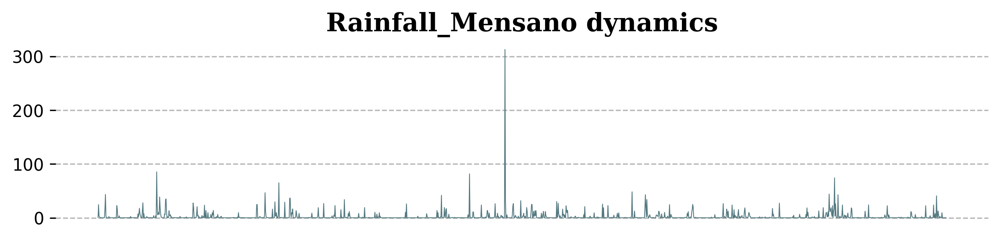

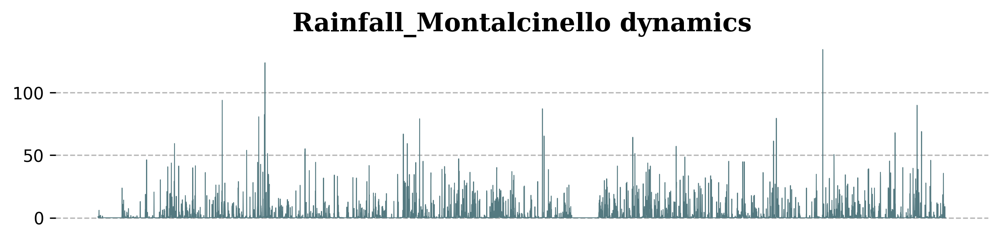

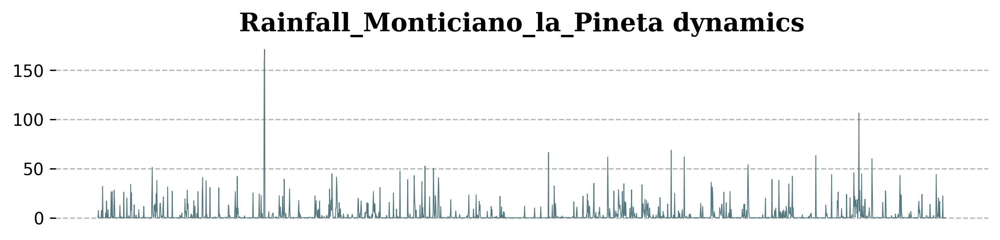

...

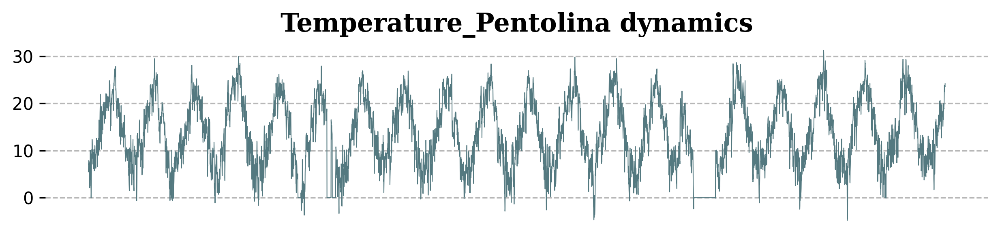

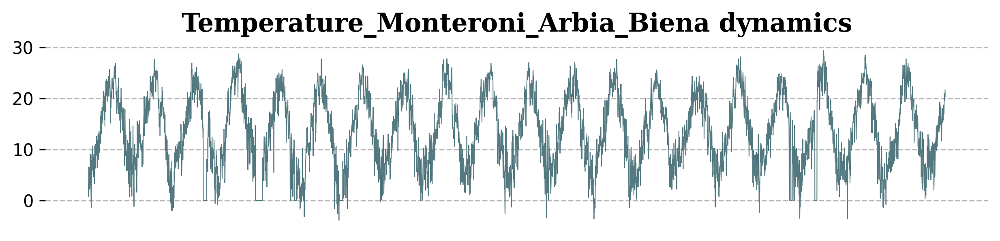

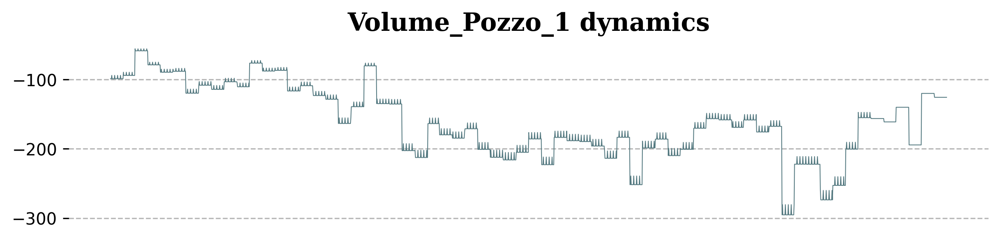

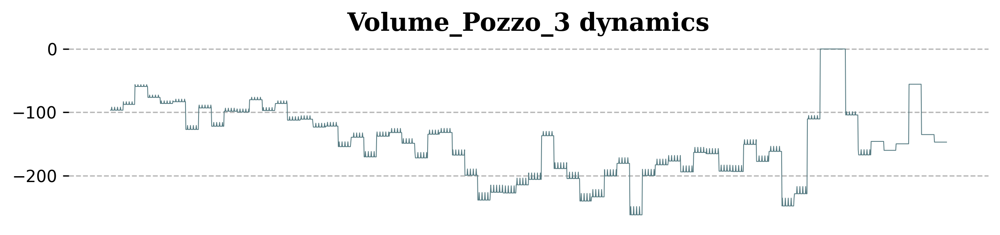

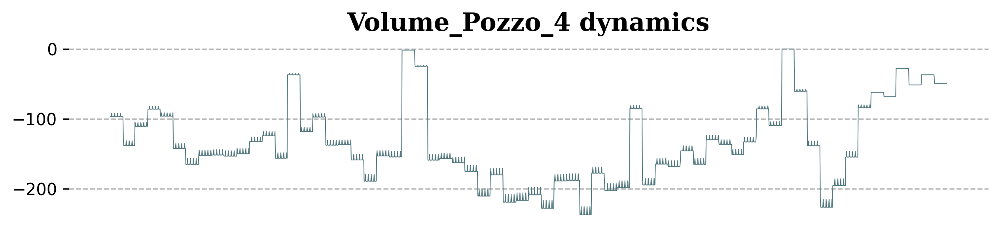

In [50]:
columns_viz(datasets[5], color = '#547980')

<a id="section-nine"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Petrignano</center></h2>

[**Back to the table of contents**](#section-start)

Description: The wells field of the alluvial plain between Ospedalicchio di Bastia Umbra and Petrignano is fed by three underground aquifers separated by low permeability septa. The aquifer can be considered a water table groundwater and is also fed by the Chiascio river. The groundwater levels are influenced by the following parameters: rainfall, depth to groundwater, temperatures and drainage volumes, level of the Chiascio river.

In [51]:
datasets[6].head()

,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
Date,,,,,,,
14/03/2006,NaN,-22.48,-22.18,NaN,NaN,NaN,NaN
15/03/2006,NaN,-22.38,-22.14,NaN,NaN,NaN,NaN
16/03/2006,NaN,-22.25,-22.04,NaN,NaN,NaN,NaN
17/03/2006,NaN,-22.38,-22.04,NaN,NaN,NaN,NaN
18/03/2006,NaN,-22.60,-22.04,NaN,NaN,NaN,NaN


In [52]:
print('The earliest date: \t%s' %datasets[6].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[6].index.values[[0, -1]][1])

The earliest date: 	14/03/2006
The latest date: 	30/06/2020


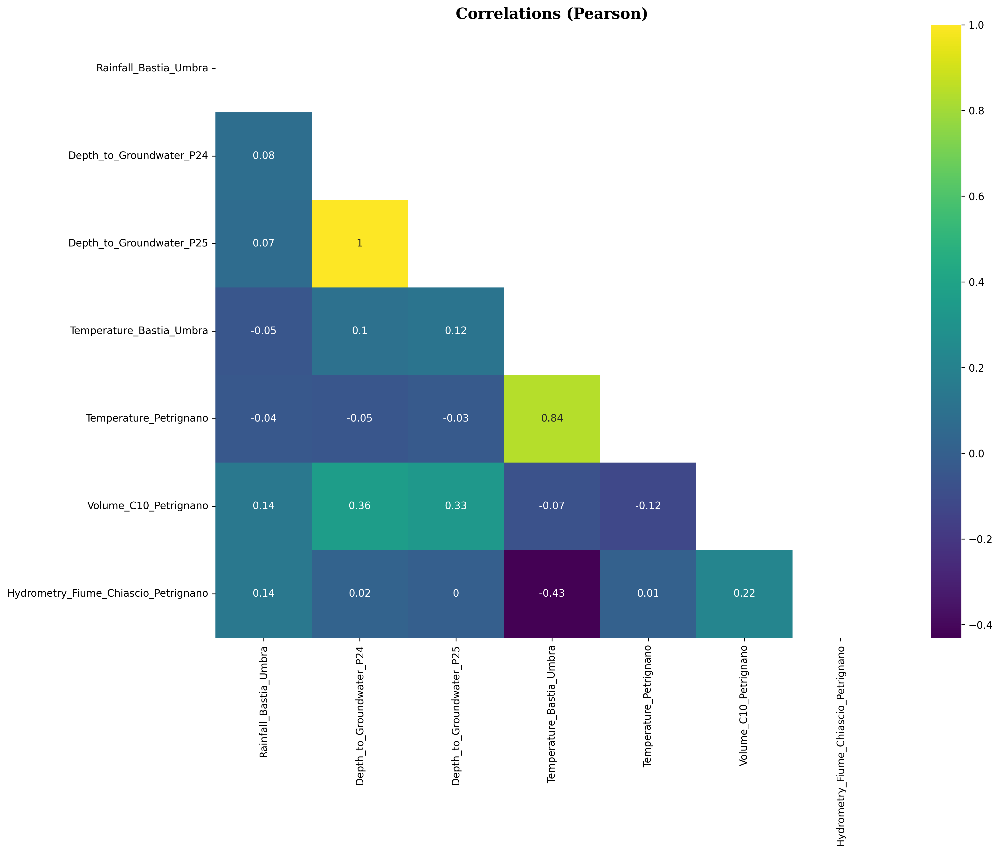

In [53]:
corr_plot(datasets[6])

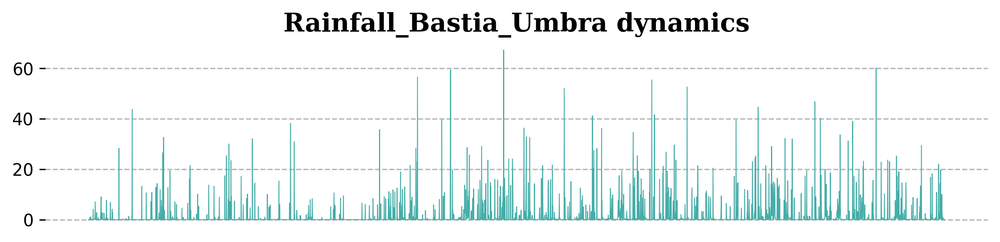

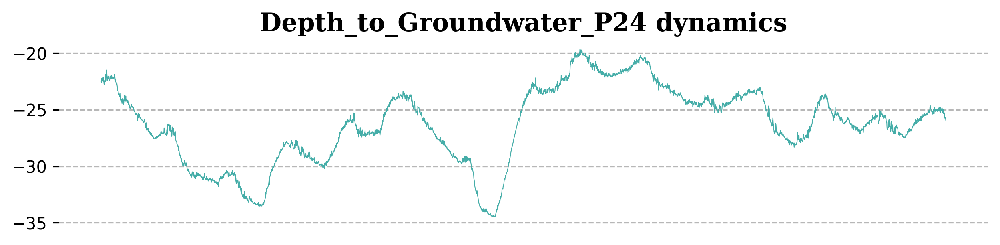

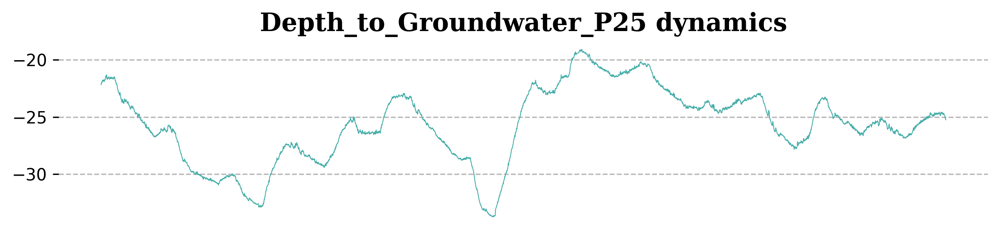

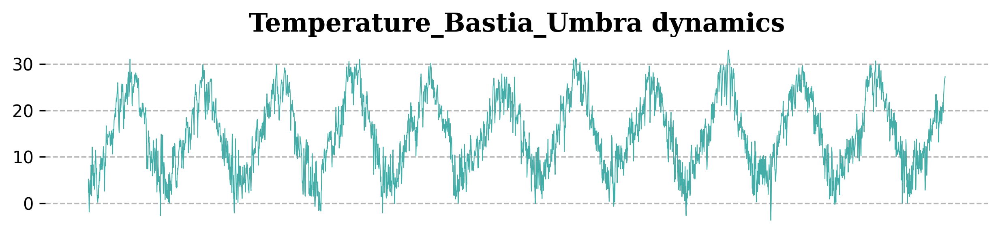

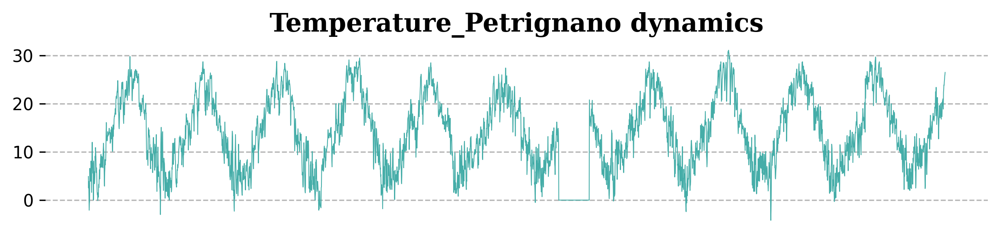

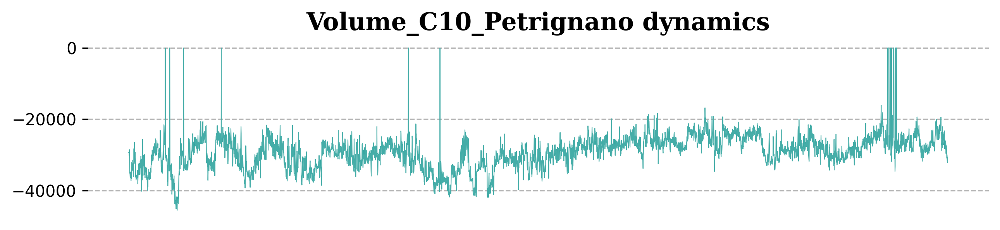

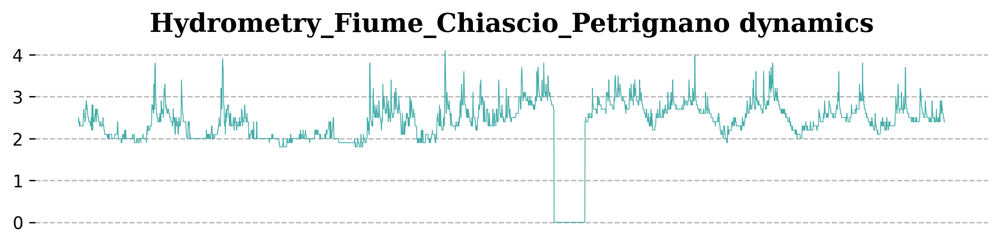

In [54]:
columns_viz(datasets[6], color = '#45ADA8')

<a id="section-ten"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Lupa</center></h2>

[**Back to the table of contents**](#section-start)

Description: this water spring is located in the Rosciano Valley, on the left side of the Nera river. The waters emerge at an altitude of about 375 meters above sea level through a long draining tunnel that crosses, in its final section, lithotypes and essentially calcareous rocks. It provides drinking water to the city of Terni and the towns around it.

In [55]:
datasets[7].head()

,Rainfall_Terni,Flow_Rate_Lupa
Date,,
01/01/2009,2.797,NaN
02/01/2009,2.797,NaN
03/01/2009,2.797,NaN
04/01/2009,2.797,NaN
05/01/2009,2.797,NaN


In [56]:
print('The earliest date: \t%s' %datasets[7].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[7].index.values[[0, -1]][1])

The earliest date: 	01/01/2009
The latest date: 	30/06/2020


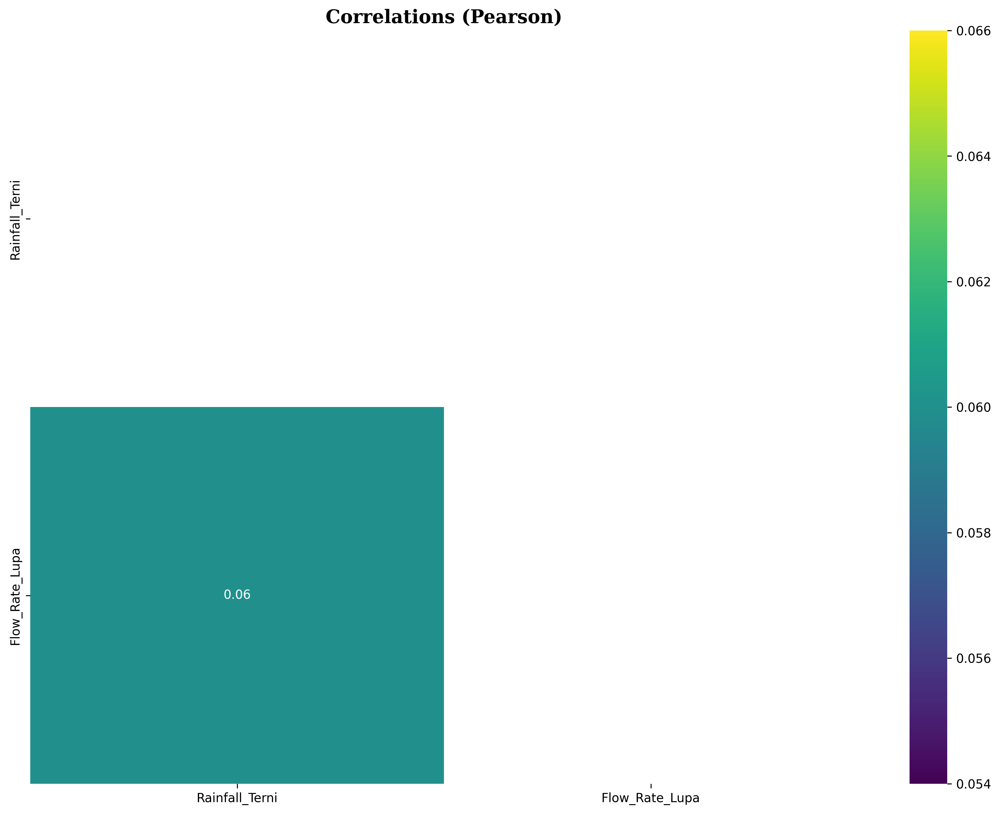

In [57]:
corr_plot(datasets[7])

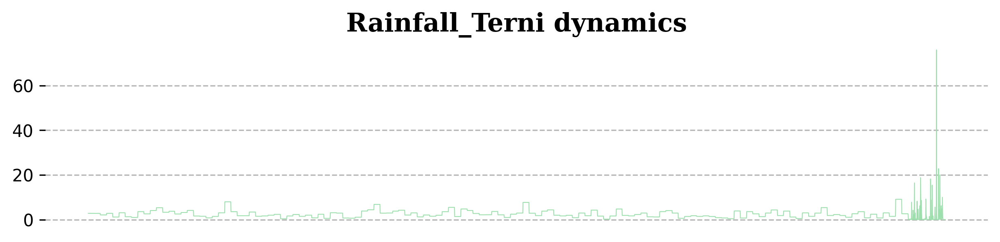

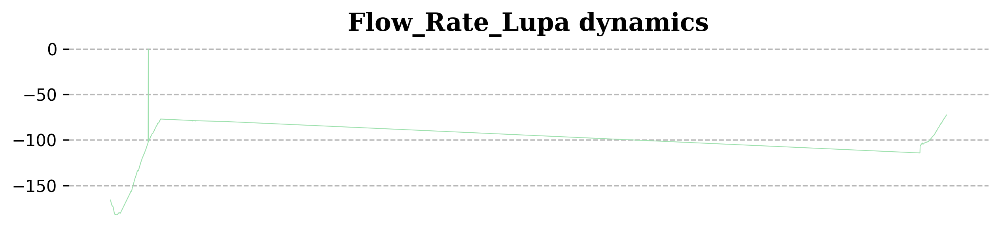

In [58]:
columns_viz(datasets[7], color = '#9DE0AD')

<a id="section-eleven"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>River Arno</center></h2>

[**Back to the table of contents**](#section-start)

Description: Arno is the second largest river in peninsular Italy and the main waterway in Tuscany and it has a relatively torrential regime, due to the nature of the surrounding soils (marl and impermeable clays). Arno results to be the main source of water supply of the metropolitan area of Florence-Prato-Pistoia. The availability of water for this waterbody is evaluated by checking the hydrometric level of the river at the section of Nave di Rosano.

In [59]:
datasets[8].head()

,Rainfall_Le_Croci,Rainfall_Cavallina,Rainfall_S_Agata,Rainfall_Mangona,Rainfall_S_Piero,Rainfall_Vernio,Rainfall_Stia,Rainfall_Consuma,Rainfall_Incisa,Rainfall_Montevarchi,Rainfall_S_Savino,Rainfall_Laterina,Rainfall_Bibbiena,Rainfall_Camaldoli,Temperature_Firenze,Hydrometry_Nave_di_Rosano
Date,,,,,,,,,,,,,,,,
01/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.82
02/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.94
03/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.11
04/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.84
05/01/1998,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.88


In [60]:
print('The earliest date: \t%s' %datasets[8].index.values[[0, -1]][0])
print('The latest date: \t%s' %datasets[8].index.values[[0, -1]][1])

The earliest date: 	01/01/1998
The latest date: 	30/06/2020


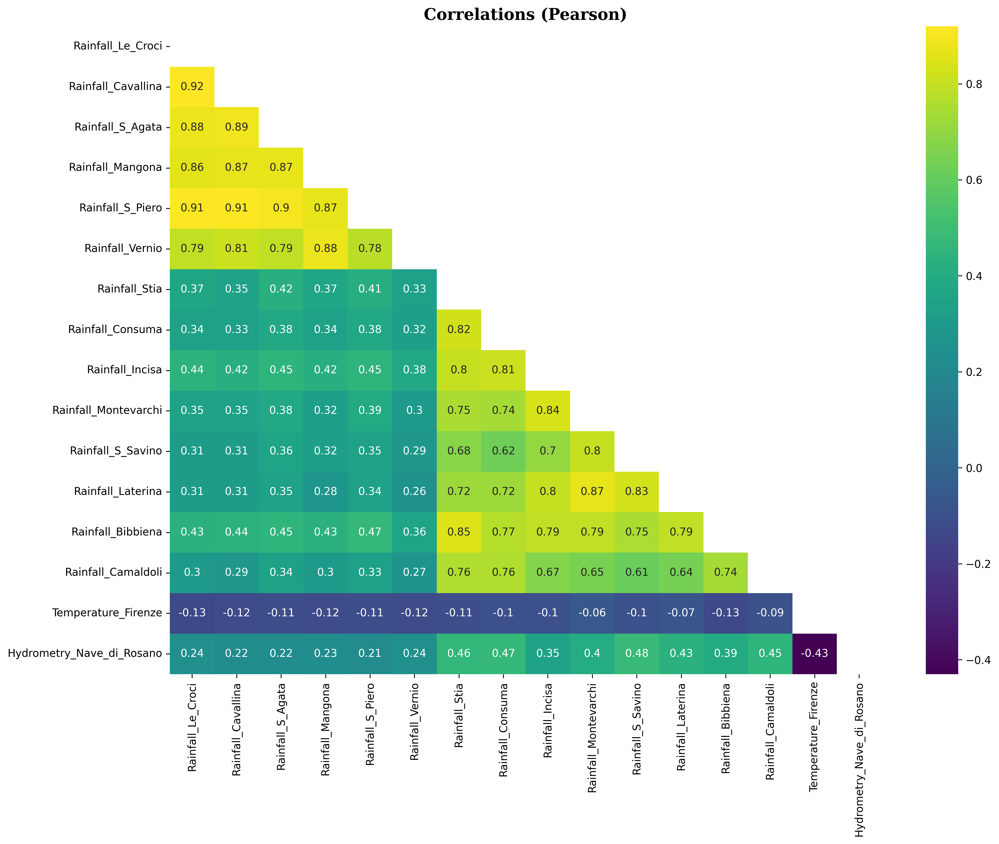

In [61]:
corr_plot(datasets[8])

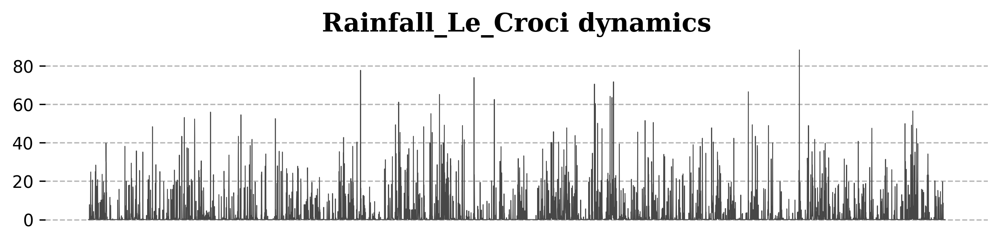

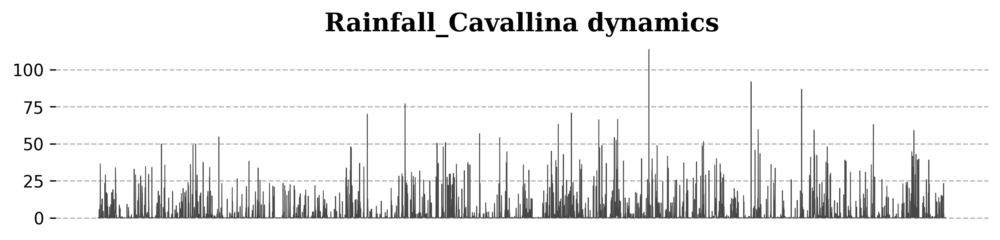

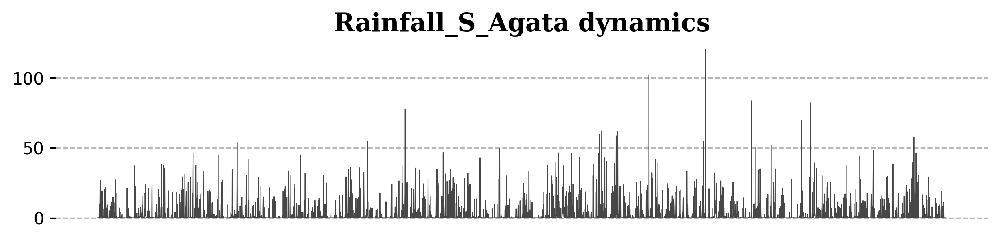

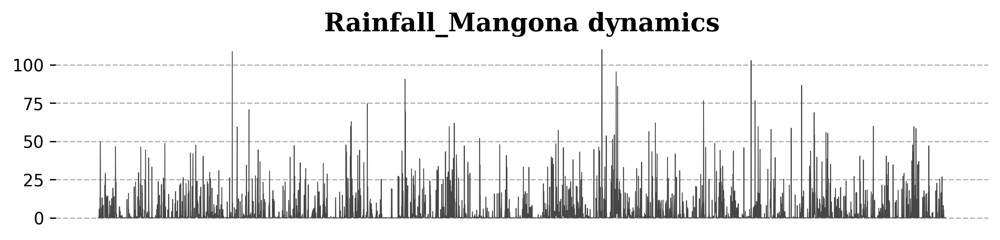

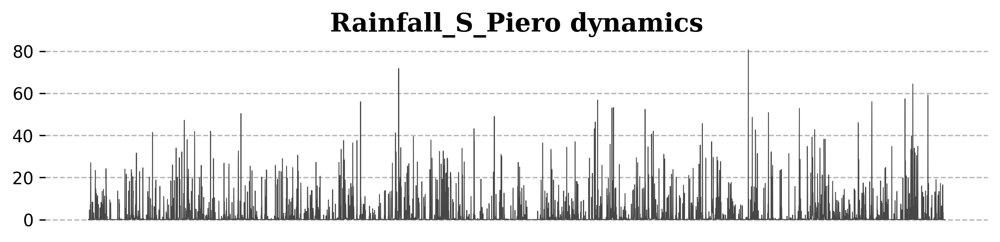

...

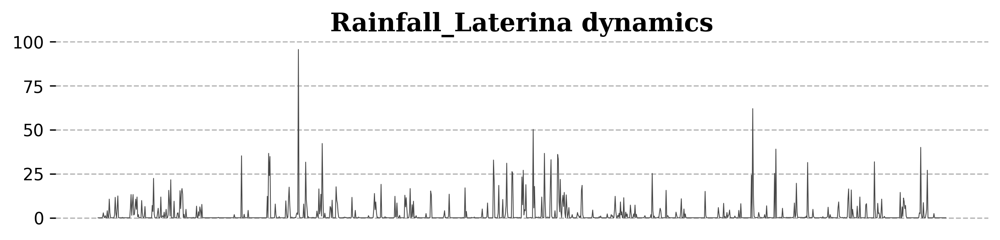

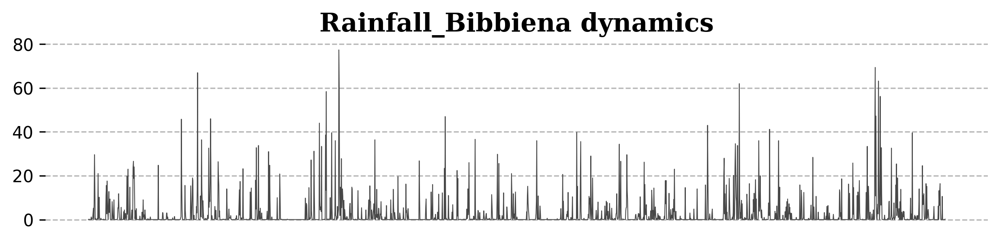

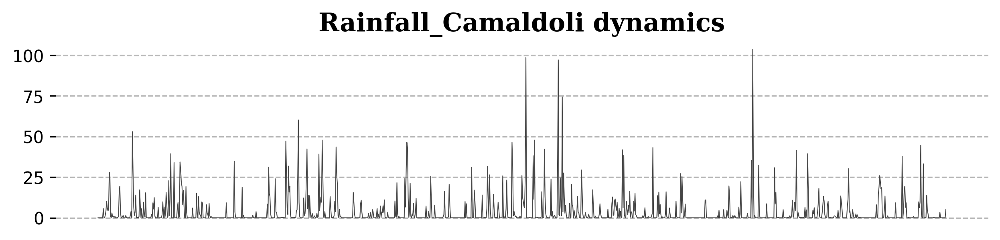

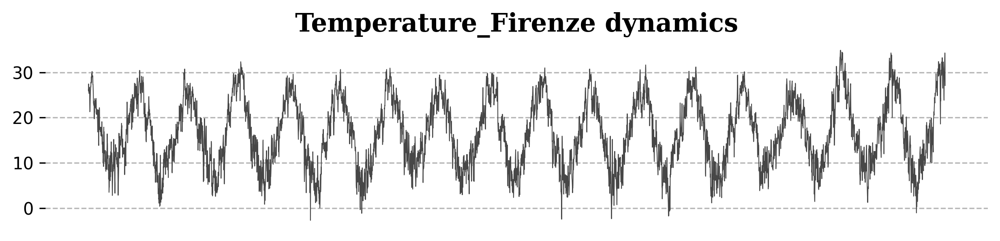

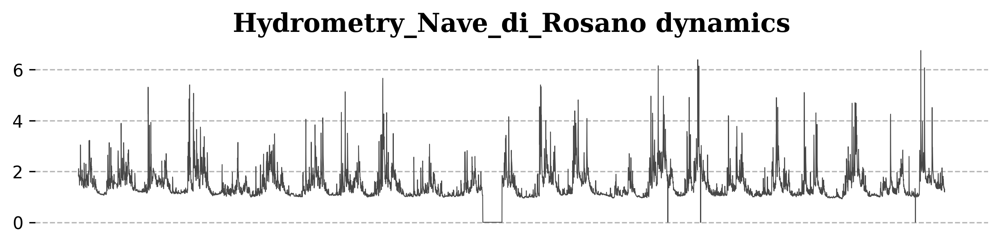

In [62]:
columns_viz(datasets[8], color = '#474747')

<a id="section-twelve"></a>
<h1 style='color:white; background:#50A8E3; border:0'><center>Feature overview and prediction</center></h1>

[**Back to the table of contents**](#section-start)

The challenge is to determine how features influence the water availability of each presented waterbody. To be more straightforward, gaining a better understanding of volumes, they will be able to ensure water availability for each time interval of the year.

The time interval is defined as day/month depending on the available measures for each waterbody. Models should capture volumes for each waterbody(for instance, for a model working on a monthly interval a forecast over the month is expected).

![](https://www.googleapis.com/download/storage/v1/b/kaggle-user-content/o/inbox%2F6195295%2Fcca952eecc1e49c54317daf97ca2cca7%2FAcea-Input.png?generation=1606932492951317&alt=media)

<a id="section-thirteen"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>River Arno (features)</center></h2>

[**Back to the table of contents**](#section-start)

![Arno river on map](https://upload.wikimedia.org/wikipedia/commons/f/f6/Arno_%28fleuve%29.png)
The Arno is a river in the Tuscany region of Italy. It is the most important river of central Italy after the Tiber. With a length of 241 kilometres (150 mi), it is the largest river in the region. It has many tributaries: Sieve at 60 kilometres (37 mi) long, Bisenzio at 49 kilometres (30 mi), Ombrone Pistoiese at 47 kilometres (29 mi), and the Era, Elsa, Pesa, and Pescia. The drainage basin amounts to more than 8,200 square kilometres (3,200 sq mi).


The main indicator that will be predicted for the river is **hydrometry**. The other two features in this dataset are **rainfall** and **temperature**. Let's look at their dynamics. **Below I'll take some liberties with axes scales in order to make the graphs more visual (somewhere the values will be logarithmized, somewhere they'll be adjusted)**.

In [66]:
df = River_Arno[['Hydrometry_Nave_di_Rosano', 'Temperature_Firenze']].reset_index()
df['rainfall'] = River_Arno.iloc[:, 0:-2].sum(axis = 1).values
df['year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.year
df['month'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.month

# df['year'] = pd.to_datetime(df.Date).dt.year
# df['month'] = pd.to_datetime(df.Date).dt.month

# Monthly dynamics
# df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))
df['month_year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).apply(lambda x: x.strftime('%Y/%m'))

r_means = np.log(df.groupby('month_year').Hydrometry_Nave_di_Rosano.mean() * 10).reset_index()
r_means['month_year'] = pd.to_datetime(r_means['month_year'])

r_rain = np.log(df.groupby('month_year').rainfall.mean()).reset_index()
r_rain['month_year'] = pd.to_datetime(r_rain['month_year'])

r_temp = np.log(df.groupby('month_year').Temperature_Firenze.mean()).reset_index()
r_temp['month_year'] = pd.to_datetime(r_temp['month_year'])

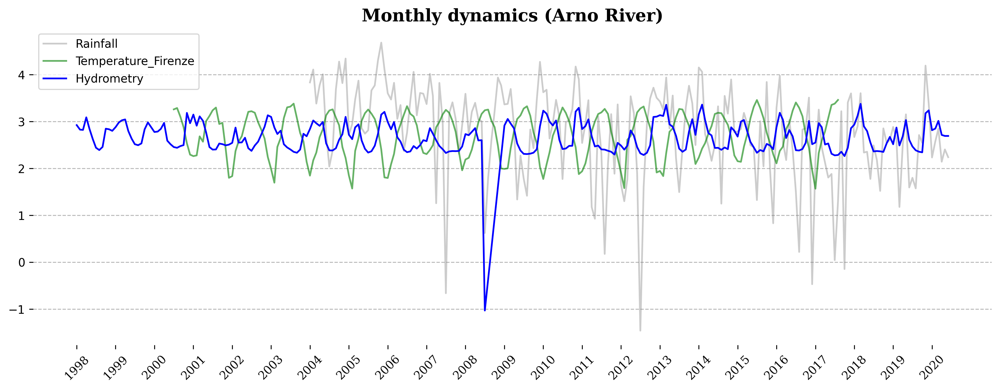

In [67]:
fig, ax = plt.subplots(figsize = (15, 5))
plt.title('Monthly dynamics (Arno River)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = r_rain, x = 'month_year', y = 'rainfall', 
             color = 'gray', label = 'Rainfall', alpha = 0.4)
plt.xticks(rotation = 45)
sns.lineplot(data = r_temp, x = 'month_year', y = 'Temperature_Firenze', 
             color = 'green', label = 'Temperature_Firenze', alpha = 0.6)
plt.xticks(rotation = 45)
sns.lineplot(data = r_means, x = 'month_year', y = 'Hydrometry_Nave_di_Rosano', 
             color = 'blue', label = 'Hydrometry')
plt.xticks(rotation = 45)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax.spines[i].set_visible(False)

ax.set_xticks(r_means.month_year[::12])
ax.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
ax.set_xlabel('')
ax.set_ylabel('')
ax.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

The graph above demonstrates quite logical patterns: water level depends on average monthly temperatures (temperature peaks coincide with the lowest annual hydrometry data; water level in rivers is always lower in summer) and in general, depends on the amount of rainfall. There is a drop in hydrometry between 2008 and 2009 (missing values).

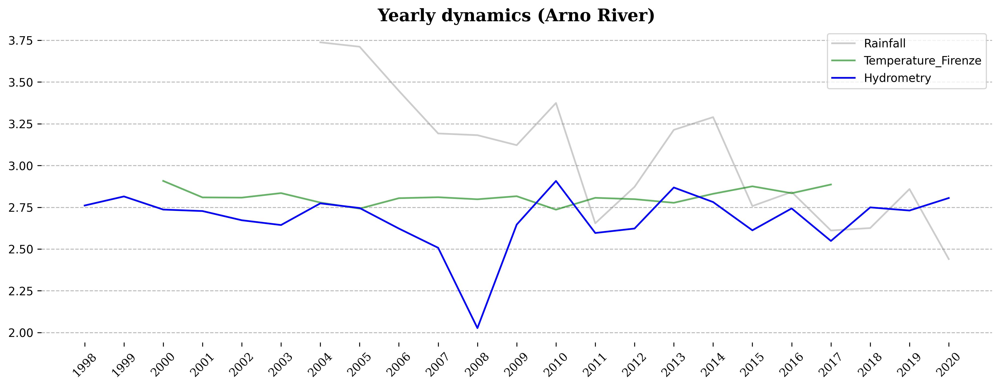

In [68]:
# Yearly dynamics
r_means_y = np.log(df.groupby('year').Hydrometry_Nave_di_Rosano.mean() * 10).reset_index()
r_rain_y = np.log(df.groupby('year').rainfall.mean()).reset_index()
r_temp_y = np.log(df.groupby('year').Temperature_Firenze.mean()).reset_index()


fig, ax = plt.subplots(figsize = (15, 5))
plt.title('Yearly dynamics (Arno River)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = r_rain_y, x = 'year', y = 'rainfall', 
             color = 'gray', label = 'Rainfall', alpha = 0.4)
plt.xticks(rotation = 45)
sns.lineplot(data = r_temp_y, x = 'year', y = 'Temperature_Firenze', 
             color = 'green', label = 'Temperature_Firenze', alpha = 0.6)
plt.xticks(rotation = 45)
sns.lineplot(data = r_means_y, x = 'year', y = 'Hydrometry_Nave_di_Rosano', 
             color = 'blue', label = 'Hydrometry')
plt.xticks(rotation = 45)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax.spines[i].set_visible(False)

ax.set_xticks(r_means_y.year[::1])
ax.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
ax.set_xlabel('')
ax.set_ylabel('')
ax.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

In general, the average annual temperature remains stable throughout the study period. The hydrometry indicator is also relatively stable from year to year, apart from small fluctuations and the significant deviation in 2008. But the amount of rainfall is gradually decreasing, which may be caused by climate changes (or a large number of missing values).

<a id="section-1"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>River Arno (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

Base on the previous feature overview, we'll use for prediction 'Temperature_Firenze' and the 5 rainfall indicators that have the least missing values: 'Rainfall_Le_Croci', 'Rainfall_Cavallina', 'Rainfall_S_Agata', 'Rainfall_Mangona', 'Rainfall_S_Piero'. We'll also create the 'rainfall_mean' feature. Missing values will be replaced with mean values (maybe not the best way, but good enough to start with).

In [69]:
RA_pred = River_Arno[['Hydrometry_Nave_di_Rosano', 'Temperature_Firenze', 
                      'Rainfall_Le_Croci', 'Rainfall_Cavallina', 
                      'Rainfall_S_Agata', 'Rainfall_Mangona', 'Rainfall_S_Piero']]

RA_pred = RA_pred.apply(lambda x: x.fillna(np.mean(x)))

RA_pred['rainfall_mean'] = RA_pred[['Rainfall_Le_Croci', 'Rainfall_Cavallina', 
                                    'Rainfall_S_Agata', 'Rainfall_Mangona', 
                                    'Rainfall_S_Piero']].mean(axis = 1).values

RA_pred

,Hydrometry_Nave_di_Rosano,Temperature_Firenze,Rainfall_Le_Croci,Rainfall_Cavallina,Rainfall_S_Agata,Rainfall_Mangona,Rainfall_S_Piero,rainfall_mean
Date,,,,,,,,
01/01/1998,1.82,16.605386,3.129871,2.674743,2.670063,3.340657,2.471225,2.857312
02/01/1998,1.94,16.605386,3.129871,2.674743,2.670063,3.340657,2.471225,2.857312
03/01/1998,2.11,16.605386,3.129871,2.674743,2.670063,3.340657,2.471225,2.857312
04/01/1998,1.84,16.605386,3.129871,2.674743,2.670063,3.340657,2.471225,2.857312
05/01/1998,1.88,16.605386,3.129871,2.674743,2.670063,3.340657,2.471225,2.857312
...,...,...,...,...,...,...,...,...
26/06/2020,1.34,16.605386,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
27/06/2020,1.21,16.605386,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
28/06/2020,1.30,16.605386,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


Then we'll split our data on a train (70%) and a test (30%) datasets without shuffling(!). Thus, we'll train the model on data obtained before 2013 and check it on data for 2013-2020. 

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [70]:
y = RA_pred['Hydrometry_Nave_di_Rosano']
X = RA_pred.drop('Hydrometry_Nave_di_Rosano', axis = 1)
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.7, shuffle = False)

params = {'n_estimators': 100,
          'max_depth': 4,
          'subsample': 0.7,
          'learning_rate': 0.04,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.04, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=100, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

In [71]:
y_pred = model.predict(X_test)

print('MAE value: %.4f' 
      %mean_absolute_error(y_test, y_pred))

MAE value: 0.3551


The mean absolute error of the predicted values is 0.3540, which means that, on average, our model makes a mistake by a third of a meter which is not so bad. Let's look at the feature importances.

In [72]:
def model_imp_viz(model, train_data, bias = 0.01):
    imp = pd.DataFrame({'importance': model.feature_importances_,
                        'features': train_data.columns}).sort_values('importance', 
                                                                     ascending = False)
    fig, ax = plt.subplots(figsize = (10, 4))
    plt.title('Feature importances', size = 15, fontweight = 'bold', fontfamily = 'serif')

    sns.barplot(x = imp.importance, y = imp.features, edgecolor = 'black',
                palette = reversed(sns.color_palette("viridis", len(imp.features))))

    for i in ['top', 'right']:
            ax.spines[i].set_visible(None)

    rects = ax.patches
    labels = imp.importance
    for rect, label in zip(rects, labels):
        x_value = rect.get_width() + bias
        y_value = rect.get_y() + rect.get_height() / 2

        ax.text(x_value, y_value, round(label, 3), fontsize = 9, color = 'black',
                 ha = 'center', va = 'center')
    ax.set_xlabel('Importance', fontweight = 'bold', fontfamily = 'serif')
    ax.set_ylabel('Features', fontweight = 'bold', fontfamily = 'serif')
    plt.show()

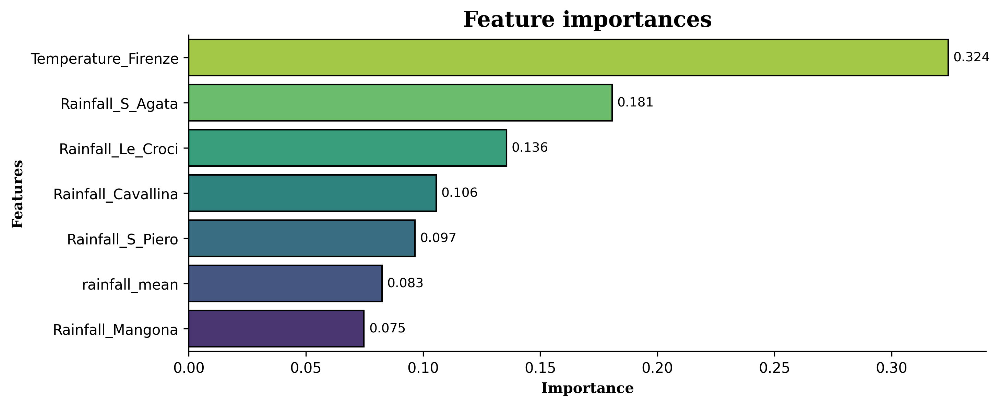

In [73]:
model_imp_viz(model, X_train)

As expected, temperature is the most important feature.

Now, let's check how well the model predicts the average monthly values of hydrometry.

In [74]:
def predicted_viz(y_test, y_pred, param, name):
    rm = y_test.reset_index()
    rm['month_year'] = pd.to_datetime(rm.Date).apply(lambda x: x.strftime('%Y/%m'))
    rm_means = rm.groupby('month_year')[param].mean().reset_index()
    rm_means['month_year'] = pd.to_datetime(rm_means['month_year'])

    pm = pd.DataFrame({'Date': y_test.index, param: y_pred})
    pm['month_year'] = pd.to_datetime(pm.Date).apply(lambda x: x.strftime('%Y/%m'))
    pm_means = pm.groupby('month_year')[param].mean().reset_index()
    pm_means['month_year'] = pd.to_datetime(pm_means['month_year'])

    fig, ax = plt.subplots(figsize = (15, 5))
    plt.title('{} prediction ({})'.format(param, name), size = 15, 
              fontweight = 'bold', fontfamily = 'serif')

    sns.lineplot(data = rm_means, x = 'month_year', y = param, 
                 color = 'blue', label = 'Real {}'.format(param), alpha = 1)
    sns.lineplot(data = pm_means, x = 'month_year', y = param, 
                 color = 'red', label = 'Pred {}'.format(param), alpha = 0.5)

    for i in ['top', 'right', 'bottom', 'left']:
            ax.spines[i].set_visible(False)

    ax.set_xticks(rm_means.month_year[::12])
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.grid(axis = 'y', linestyle = '--', alpha = 0.9)
    plt.show()

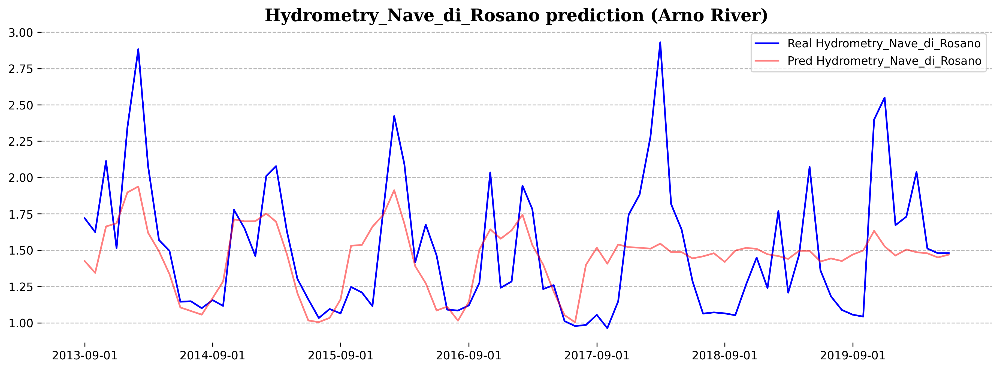

In [75]:
predicted_viz(y_test, y_pred, 'Hydrometry_Nave_di_Rosano', 'Arno River')

It doesn't look so good as it seemed when looking at the MAE. The model is good at predicting seasonal changes in hydrometry, but it has problems with peaks that are much lower than real ones. For the past two years, predictions don't look promising due to a large number of missing temperature values.

In [76]:
def resid_viz(y_test, y_pred):
    resid = abs(y_test - y_pred)
    fig, ax = plt.subplots(figsize = (10, 5))
    plt.title('Residuals', size = 15, fontweight = 'bold', fontfamily = 'serif')

    sns.scatterplot(x = y_test, y = resid, color = 'red', 
                    edgecolor = 'black', alpha = 0.7)

    for i in ['top', 'right']:
            ax.spines[i].set_visible(False)

    ax.set_xlabel('Real values', fontweight = 'bold', fontfamily = 'serif')
    ax.set_ylabel('Resiaduals', fontweight = 'bold', fontfamily = 'serif')
    plt.show()

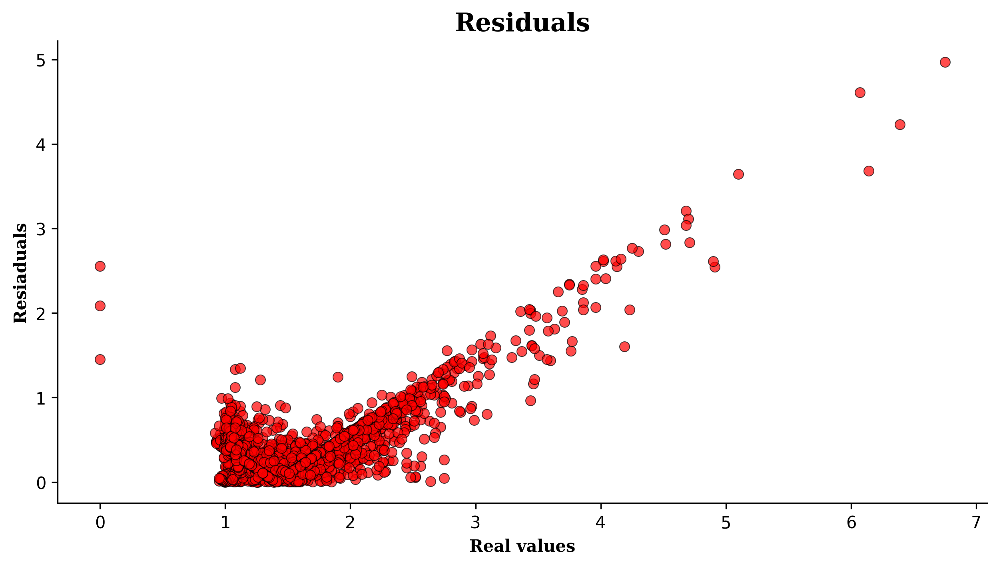

In [77]:
resid_viz(y_test, y_pred)

Residual distribution is a powerful tool for assessing the quality of a model. The linear dependence, which is most pronounced for high hydrometry values, proves that our model does not consider all the dependencies. Perhaps if all predictors were used (this is not possible due to missing values), the model would do much better.

Ideas for further improvement:
- experiments with model parameters;
- try more advanced data selection and preprocessing;
- try another algorithms.

<a id="section-fourteen"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Lake Bilancino (features)</center></h2>

[**Back to the table of contents**](#section-start)

![](https://www.hoteldeivicari.com/images/demo/gallery/intestazione1280x500/mugello_florence_lake_bilancino_near_florence.jpg)
Bilancino lake is an artificial lake located in the municipality of Barberino di Mugello (about 50 km from Florence). It is used to refill the Arno river during the summer months. Indeed, during the winter months, the lake is filled up and then, during the summer months, the water of the lake is poured into the Arno river.

In [79]:
df = Lake_Bilancino[['Lake_Level', 'Flow_Rate', 'Temperature_Le_Croci']].reset_index()
df['rainfall'] = Lake_Bilancino.iloc[:, 0:-3].sum(axis = 1).values

# df['year'] = pd.to_datetime(df.Date).dt.year
# df['month'] = pd.to_datetime(df.Date).dt.month
df['year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.year
df['month'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.month

# Monthly dynamics
# df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))
df['month_year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).apply(lambda x: x.strftime('%Y/%m'))

l_means = np.log(df.groupby('month_year').Flow_Rate.mean()).reset_index()
l_means['month_year'] = pd.to_datetime(l_means['month_year'])

l_means_LL = df.groupby('month_year').Lake_Level.mean().reset_index()
l_means_LL['month_year'] = pd.to_datetime(l_means_LL['month_year'])

l_rain = np.log(df.groupby('month_year').rainfall.mean()).reset_index()
l_rain['month_year'] = pd.to_datetime(l_rain['month_year'])

l_temp = np.log(df.groupby('month_year').Temperature_Le_Croci.mean()).reset_index()
l_temp['month_year'] = pd.to_datetime(l_temp['month_year'])

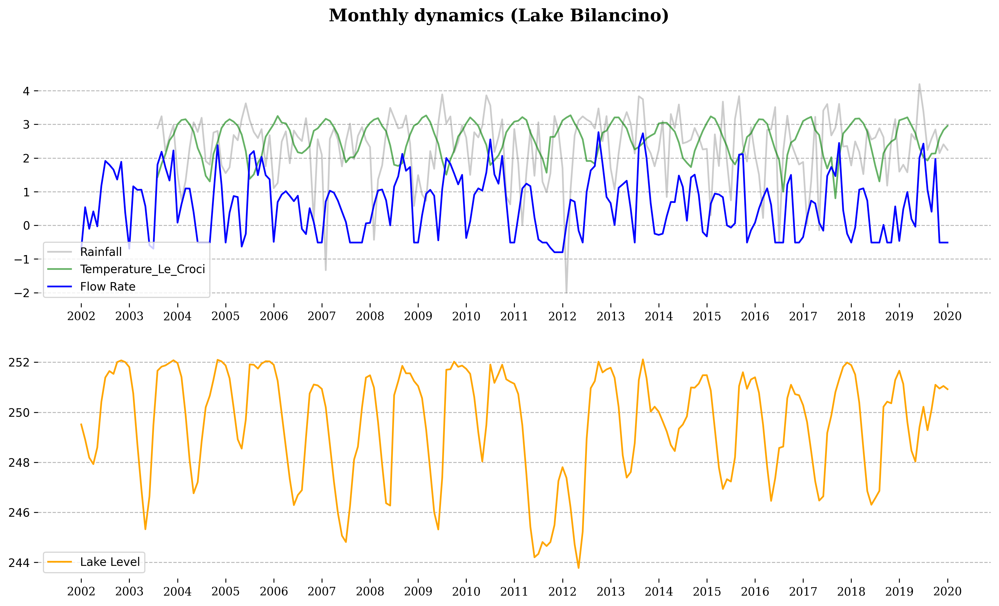

In [80]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize = (15, 8))
plt.suptitle('Monthly dynamics (Lake Bilancino)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = l_rain, x = 'month_year', y = 'rainfall', ax = ax1, 
             color = 'gray', label = 'Rainfall', alpha = 0.4)
sns.lineplot(data = l_temp, x = 'month_year', y = 'Temperature_Le_Croci', ax = ax1,
             color = 'green', label = 'Temperature_Le_Croci', alpha = 0.6)
sns.lineplot(data = l_means, x = 'month_year', y = 'Flow_Rate', ax = ax1,
             color = 'blue', label = 'Flow Rate')
    
for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(l_means.month_year[::12])
ax1.set_xticklabels(range(2002, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = l_means_LL, x = 'month_year', y = 'Lake_Level', ax = ax2,
             color = 'orange', label = 'Lake Level')
    
for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(l_means_LL.month_year[::12])
ax2.set_xticklabels(range(2002, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

The graph above demonstrates the same patterns: flow rate and lake level depend on average monthly temperatures and, in general, depends on the amount of rainfall. The lake level decreases in summer and autumn every year, as the water from it flows into the Arno River. There are two strong decreases in 2008 and 2012-2013. In 2008, the water level in the river was still much lower (as can be seen in the graphs above), but in 2012-2013, a serious discharge of water from the lake helped to keep the water level in the Arno River stable.

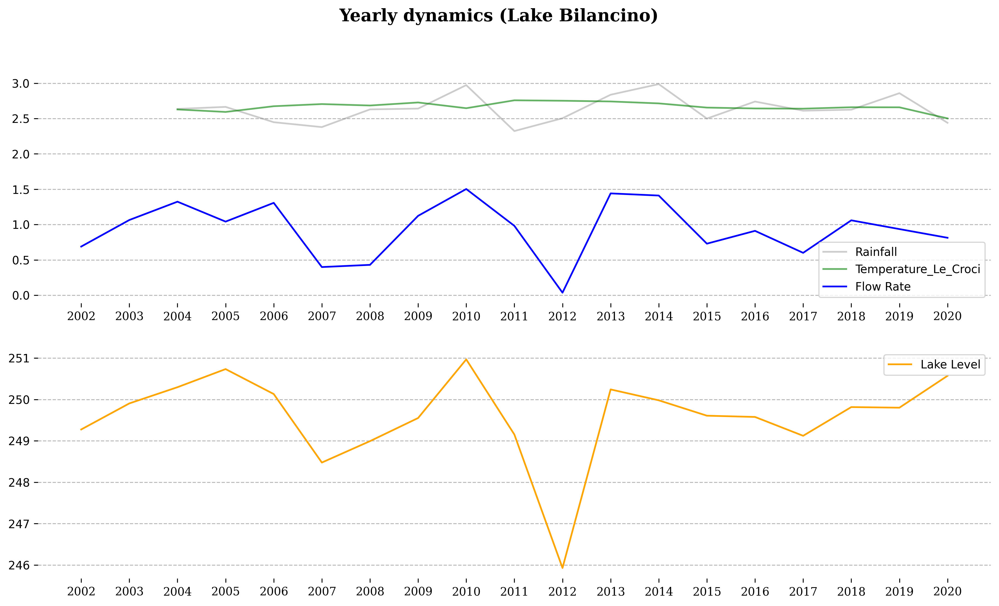

In [81]:
# Yearly dynamics
l_means_y = np.log(df.groupby('year').Flow_Rate.mean()).reset_index()
l_means_LL_y = df.groupby('year').Lake_Level.mean().reset_index()
l_rain_y = np.log(df.groupby('year').rainfall.mean()).reset_index()
l_temp_y = np.log(df.groupby('year').Temperature_Le_Croci.mean()).reset_index()

fig, (ax1, ax2) = plt.subplots(2, 1, figsize = (15, 8))
plt.suptitle('Yearly dynamics (Lake Bilancino)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = l_rain_y, x = 'year', y = 'rainfall', ax = ax1, 
             color = 'gray', label = 'Rainfall', alpha = 0.4)
sns.lineplot(data = l_temp_y, x = 'year', y = 'Temperature_Le_Croci', ax = ax1,
             color = 'green', label = 'Temperature_Le_Croci', alpha = 0.6)
sns.lineplot(data = l_means_y, x = 'year', y = 'Flow_Rate', ax = ax1,
             color = 'blue', label = 'Flow Rate')
    
for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(l_means_y.year[::1])
ax1.set_xticklabels(range(2002, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = l_means_LL_y, x = 'year', y = 'Lake_Level', ax = ax2,
             color = 'orange', label = 'Lake Level')
    
for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(l_means_LL_y.year[::1])
ax2.set_xticklabels(range(2002, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

In general, the annual dynamics of flow rate and lake level are the same. Most importantly, the rainfall indicator is relatively stable throughout the observation period (in contrast to the analogous indicator in the Arno_River dataset). Considering that both water bodies are located in the same region of Italy and the Lake_Bilancino dataset has fewer missing values, the conclusion about a decrease in rainfall caused by climate change is incorrect.

<a id="section-2"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Lake Bilancino (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

Base on the previous feature overview, we'll use for prediction all the data from 2004 to 2020 (because there is no data for predictors for the 2002-2003 time period). We'll also create the 'rainfall_mean' feature. Missing values, as for the previous water body, will be replaced with mean values (maybe not the best way, but good enough to start with).

In [82]:
LB_pred = Lake_Bilancino.iloc[578:, :]
rainfall_col = [col for col in LB_pred.columns if 'Rainfall' in col]

LB_pred['rainfall_mean'] = LB_pred[rainfall_col].mean(axis = 1).values

LB_pred

,Rainfall_S_Piero,Rainfall_Mangona,Rainfall_S_Agata,Rainfall_Cavallina,Rainfall_Le_Croci,Temperature_Le_Croci,Lake_Level,Flow_Rate,rainfall_mean
Date,,,,,,,,,
02/01/2004,0.0,0.0,0.0,0.0,0.0,6.50,251.21,0.5,0.00
03/01/2004,0.0,0.0,0.0,0.0,0.0,4.45,251.28,0.5,0.00
04/01/2004,0.0,0.0,0.0,0.0,0.0,2.00,251.35,0.5,0.00
05/01/2004,0.2,0.0,0.0,0.0,0.0,0.90,251.37,0.5,0.04
06/01/2004,0.0,0.0,0.0,0.0,0.0,2.25,251.42,0.5,0.00
...,...,...,...,...,...,...,...,...,...
26/06/2020,0.0,0.0,0.0,0.0,0.0,22.50,250.85,0.6,0.00
27/06/2020,0.0,0.0,0.0,0.0,0.0,23.40,250.84,0.6,0.00
28/06/2020,0.0,0.0,0.0,0.0,0.0,21.50,250.83,0.6,0.00


Then we'll split our data on a train (75%) and a test (25%) datasets without shuffling(!). Thus, we'll train the model on data obtained before 2016 and check it on data for 2016-2020.

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [83]:
y_lake_l = LB_pred['Lake_Level']
y_flow_r = LB_pred['Flow_Rate']
X = LB_pred.drop(['Lake_Level', 'Flow_Rate'], axis = 1)

X_train, X_test, y_train_ll, y_test_ll = train_test_split(X, y_lake_l, train_size = 0.75, shuffle = False)
y_train_fr, y_test_fr = train_test_split(y_flow_r, train_size = 0.75, shuffle = False)

In [84]:
params = {'n_estimators': 300,
          'max_depth': 4,
          'subsample': 1,
          'learning_rate': 0.04,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train_ll)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.04, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=300, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

In [85]:
y_pred_ll = model.predict(X_test)

print('MAE value (Lake Level): %.4f' 
      %mean_absolute_error(y_test_ll, y_pred_ll))

MAE value (Lake Level): 1.5141


The mean absolute error of the predicted values is 1.5190, which means that, on average, our model makes a mistake by 1.5 meters. Let's look at the feature importances.

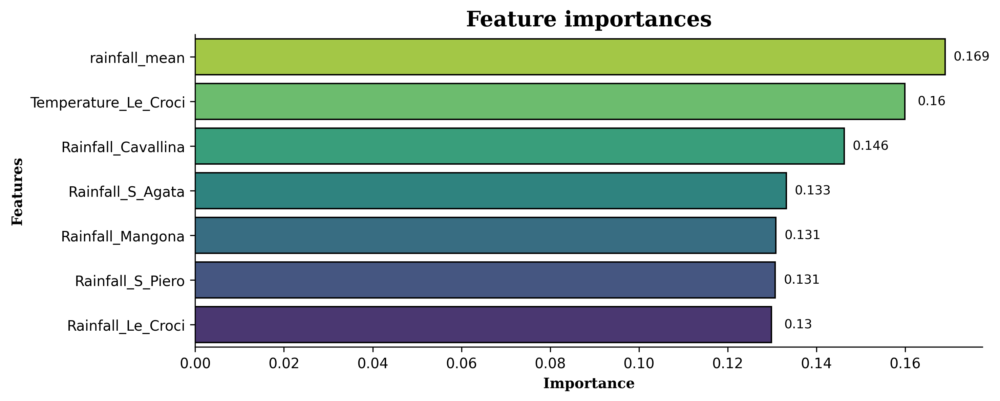

In [86]:
model_imp_viz(model, X_train, bias = 0.006)

In contrast to the hydrometric indicator for the river, the rainfall indicators are the main predictors for the lake.

Now, let's check how well the model predicts the average monthly values of the lake level indicator.

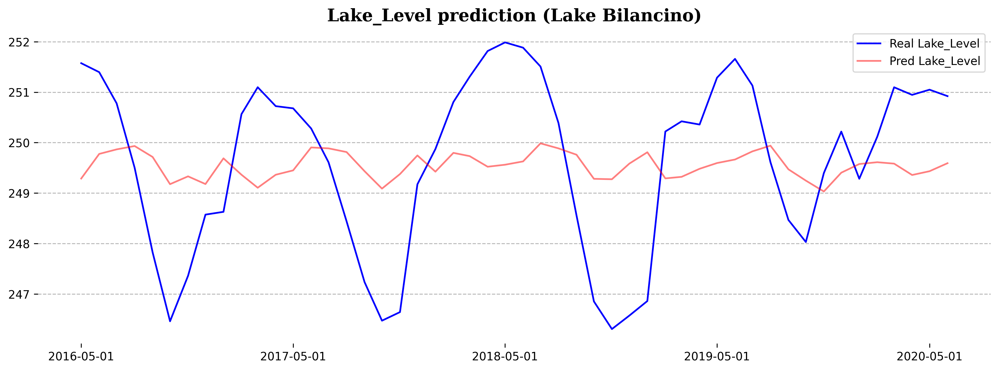

In [87]:
predicted_viz(y_test_ll, y_pred_ll, 'Lake_Level', 'Lake Bilancino')

It doesn't look very good. The model averages its predictions strongly, capturing only small trends in seasonal lake level fluctuations.

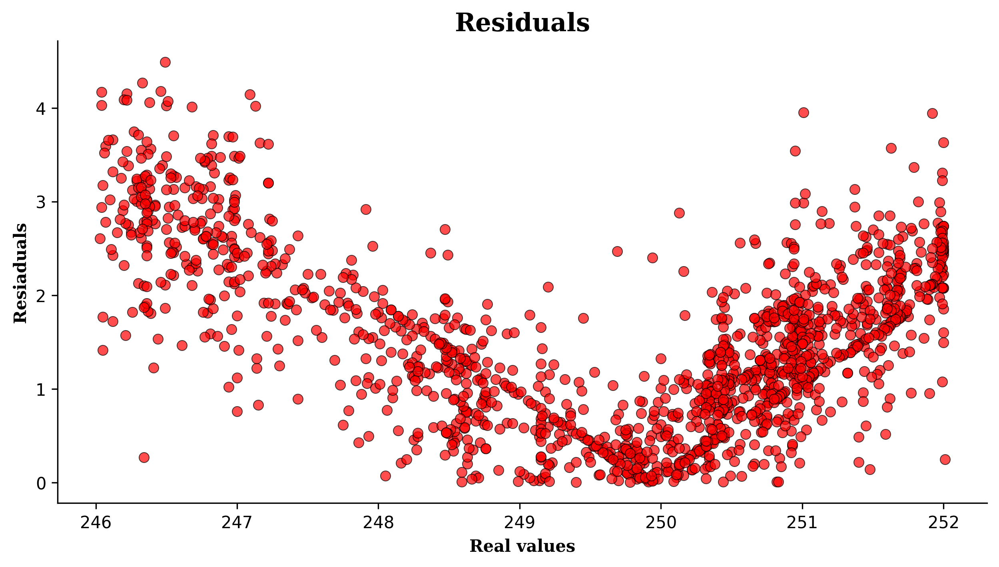

In [88]:
resid_viz(y_test_ll, y_pred_ll)

Residuals confirm the imperfection of our model. Values between 249 and 250 are best predicted. Below and above values are linear, which the model does not account for.

Let's look at the Flow Rate indicator.

In [89]:
params = {'n_estimators': 300,
          'max_depth': 3,
          'subsample': 0.6,
          'learning_rate': 0.04,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train_fr)

y_pred_fr = model.predict(X_test)
print('MAE value (Flow Rate): %.4f' 
      %mean_absolute_error(y_test_fr, y_pred_fr))

MAE value (Flow Rate): 2.2732


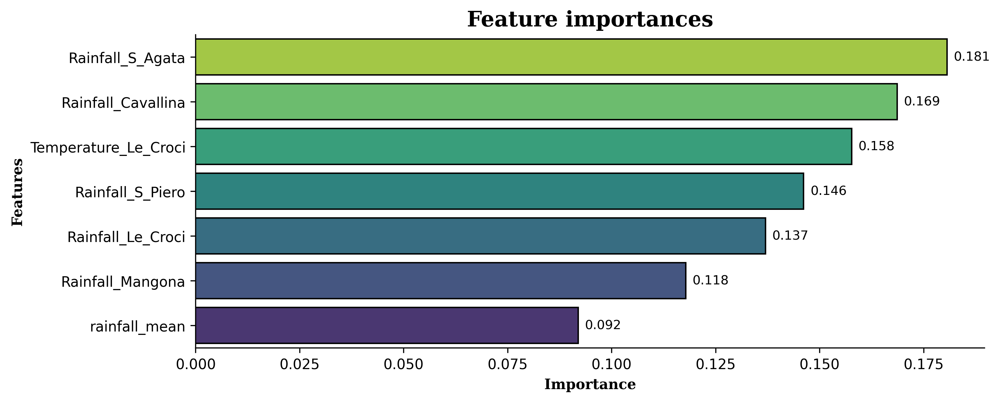

In [90]:
model_imp_viz(model, X_train, bias = 0.006)

In this case, temperature is the dominant predictor.

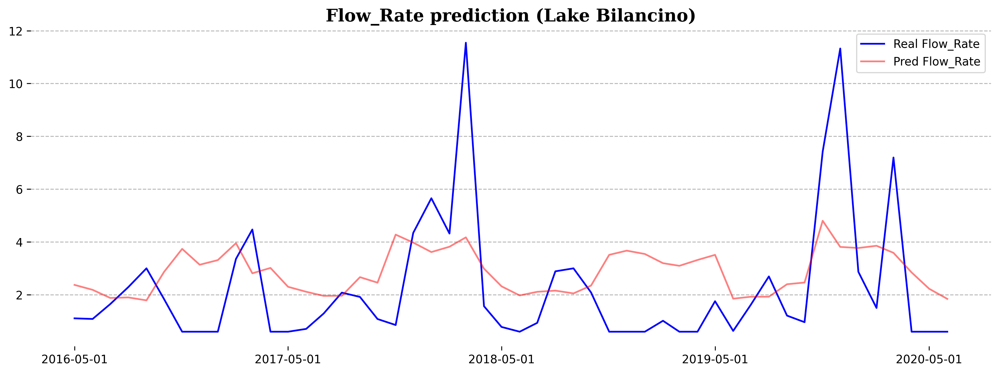

In [91]:
predicted_viz(y_test_fr, y_pred_fr, 'Flow_Rate', 'Lake Bilancino')

Also far from perfect. But overall it looks better than for the lake level.

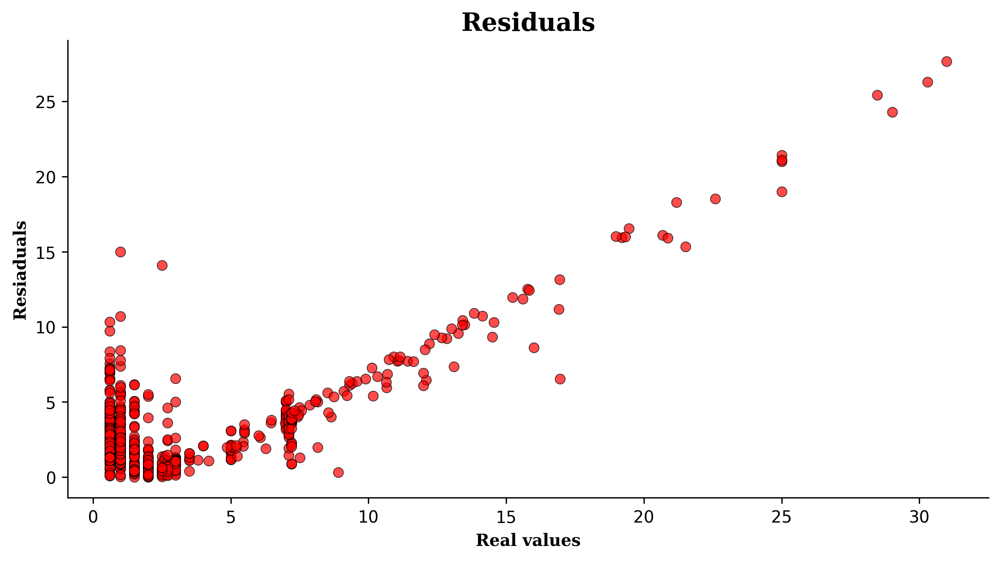

In [92]:
resid_viz(y_test_fr, y_pred_fr)

Let's do a trick and try to predict one feature using the second as an additional predictor.

In [93]:
y_lake_l = LB_pred['Lake_Level']
X = LB_pred.drop('Lake_Level', axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y_lake_l, train_size = 0.75, shuffle = False)

In [94]:
params = {'n_estimators': 300,
          'max_depth': 4,
          'subsample': 0.7,
          'learning_rate': 0.05,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)
print('MAE value (Lake Level): %.4f' 
      %mean_absolute_error(y_test, y_pred))

MAE value (Lake Level): 1.3529


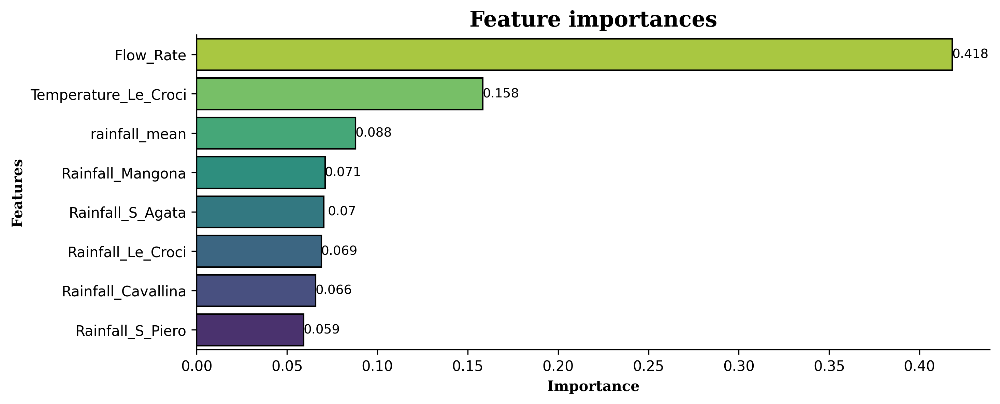

In [95]:
model_imp_viz(model, X_train)

As expected, Flow Rate have a strong effect on the Lake Level feature. The decline in MAE also confirms this.

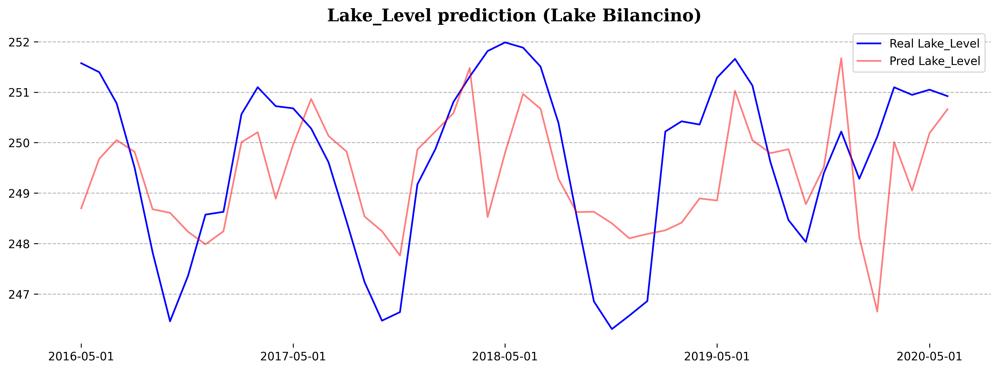

In [96]:
predicted_viz(y_test, y_pred, 'Lake_Level', 'Lake Bilancino')

Not perfect, but much better than the first option, where predictions were made using only rainfall and temperature predictors.

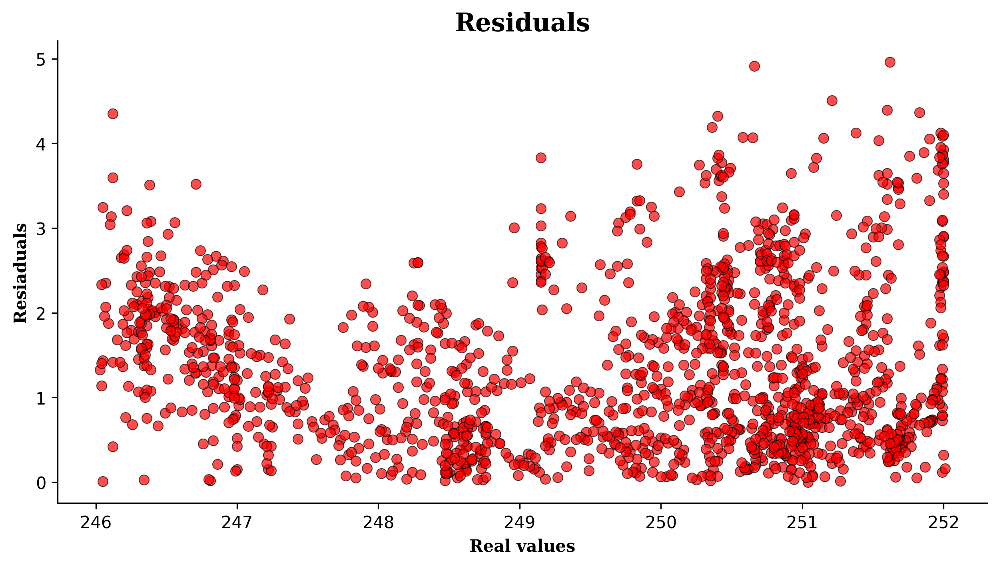

In [97]:
resid_viz(y_test, y_pred)

The distribution of residuals also looks optimistic. It is more random, although not without linear dependencies.

We should do the same trick for the Flow Rate feature.

In [98]:
y_flow_r = LB_pred['Flow_Rate']
X = LB_pred.drop('Flow_Rate', axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y_flow_r, train_size = 0.75, shuffle = False)

In [99]:
params = {'n_estimators': 400,
          'max_depth': 4,
          'subsample': 0.7,
          'learning_rate': 0.05,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train)

y_pred = model.predict(X_test)
print('MAE value (Flow Rate): %.4f' 
      %mean_absolute_error(y_test, y_pred))

MAE value (Flow Rate): 1.6224


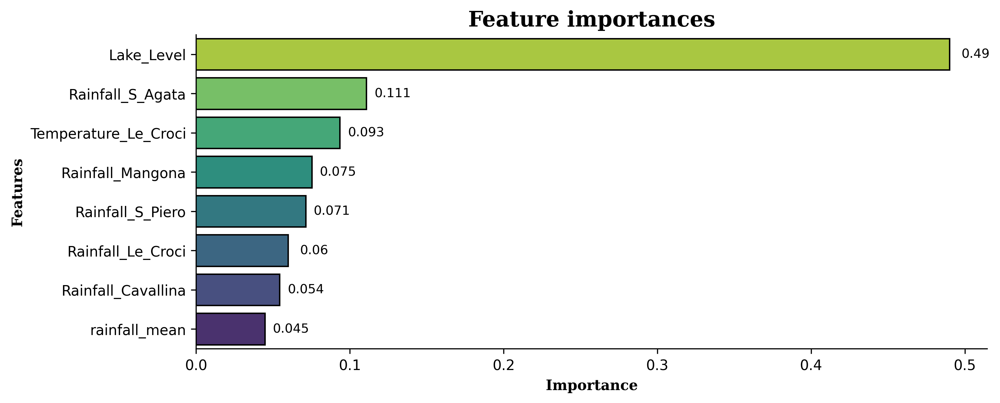

In [100]:
model_imp_viz(model, X_train, bias = 0.017)

We have a very strong influence of the lake level on the predicted indicator.

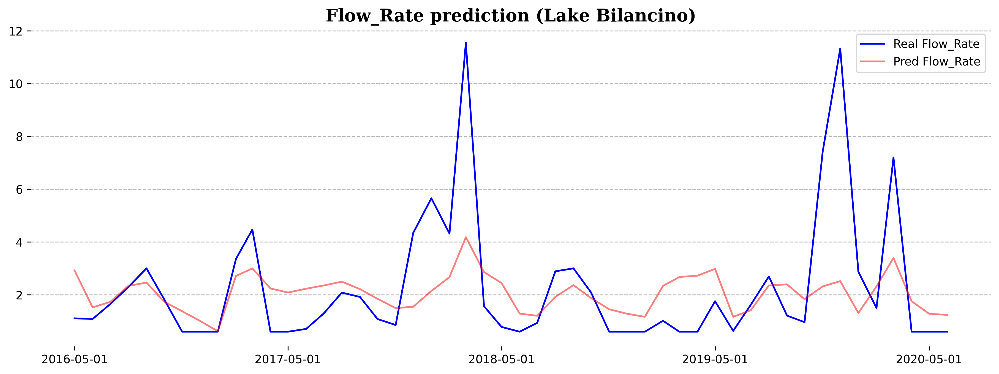

In [101]:
predicted_viz(y_test, y_pred, 'Flow_Rate', 'Lake Bilancino')

It looks better, but the problem with peak values is still there.

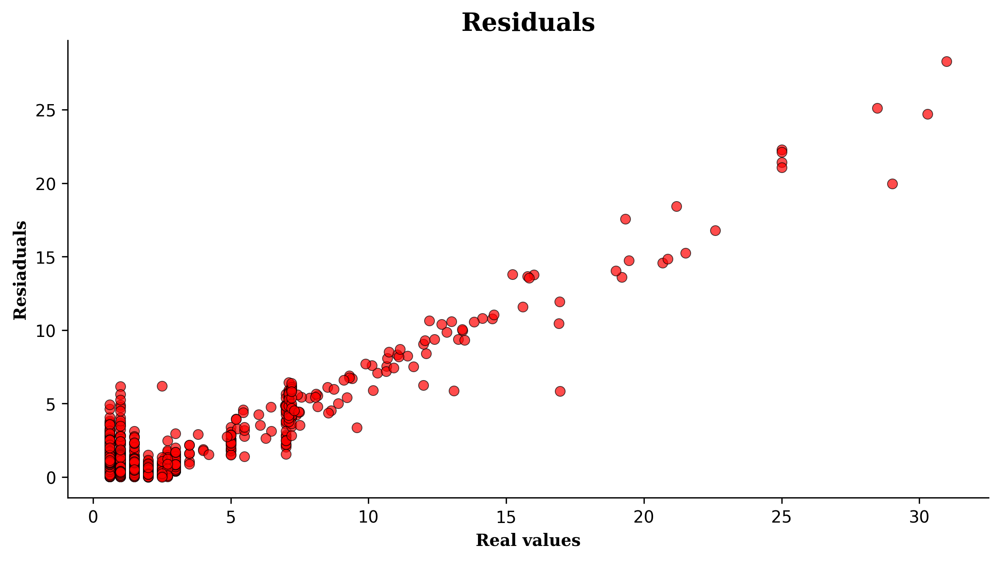

In [102]:
resid_viz(y_test, y_pred)

Nothing has changed significantly in the distribution of residuals.

In this case, we were unable to build a sufficiently accurate model based on rainfall and temperature predictors alone. The model doesn't take into account the seasonality of changes well enough, which depend not so much on weather conditions, but on the fact that in summer, part of the water from the lake is discharged into the river to maintain the water level in it. The presented model performs better when predicting one feature when the other is an additional predictor.

Ideas for further improvement:
- try a deeper feature preprocessing (it might be worth trying to create a feature that will reflect seasonality)
- try other algorithms

<a id="section-fifteen"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Petrignano (features)</center></h2>

[**Back to the table of contents**](#section-start)

![](https://www.researchgate.net/profile/Elisabetta_Preziosi/publication/26812692/figure/fig8/AS:279197076475915@1443577178810/The-Petrignano-dAssisi-plain-Gray-areas-alluvial-deposits-White-areas-lacustrine-and.png)
(Source: [The Sustainable Pumping Rate Concept: Lessons from a Case Study in Central Italy](https://www.researchgate.net/publication/26812692_The_Sustainable_Pumping_Rate_Concept_Lessons_from_a_Case_Study_in_Central_Italy))

Gray areas: alluvial deposits. White areas: lacustrine and fluvio-lacustrine deposits. White stars: wells belonging to the Petrignano pumping station. Black dots: other wells located within the area. The bold line indicates the boundaries of the model area.

In [103]:
df = Aquifer_Petrignano.reset_index().copy()
df['year'] = pd.to_datetime(df.Date).dt.year
df['month'] = pd.to_datetime(df.Date).dt.month

# Monthly dynamics
df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))

ap_means_P24 = df.groupby('month_year').Depth_to_Groundwater_P24.mean().reset_index()
ap_means_P24['month_year'] = pd.to_datetime(ap_means_P24['month_year'])

ap_means_P25 = df.groupby('month_year').Depth_to_Groundwater_P25.mean().reset_index()
ap_means_P25['month_year'] = pd.to_datetime(ap_means_P25['month_year'])

ap_rain = df.groupby('month_year').Rainfall_Bastia_Umbra.mean().reset_index()
ap_rain['month_year'] = pd.to_datetime(ap_rain['month_year'])

ap_temp_B = df.groupby('month_year').Temperature_Bastia_Umbra.mean().reset_index()
ap_temp_B['month_year'] = pd.to_datetime(ap_temp_B['month_year'])

ap_temp_P = df.groupby('month_year').Temperature_Petrignano.mean().reset_index()
ap_temp_P['month_year'] = pd.to_datetime(ap_temp_P['month_year'])

ap_C10 = df.groupby('month_year').Volume_C10_Petrignano.mean().reset_index()
ap_C10['month_year'] = pd.to_datetime(ap_C10['month_year'])

ap_hydro = df.groupby('month_year').Hydrometry_Fiume_Chiascio_Petrignano.mean().reset_index()
ap_hydro['month_year'] = pd.to_datetime(ap_hydro['month_year'])

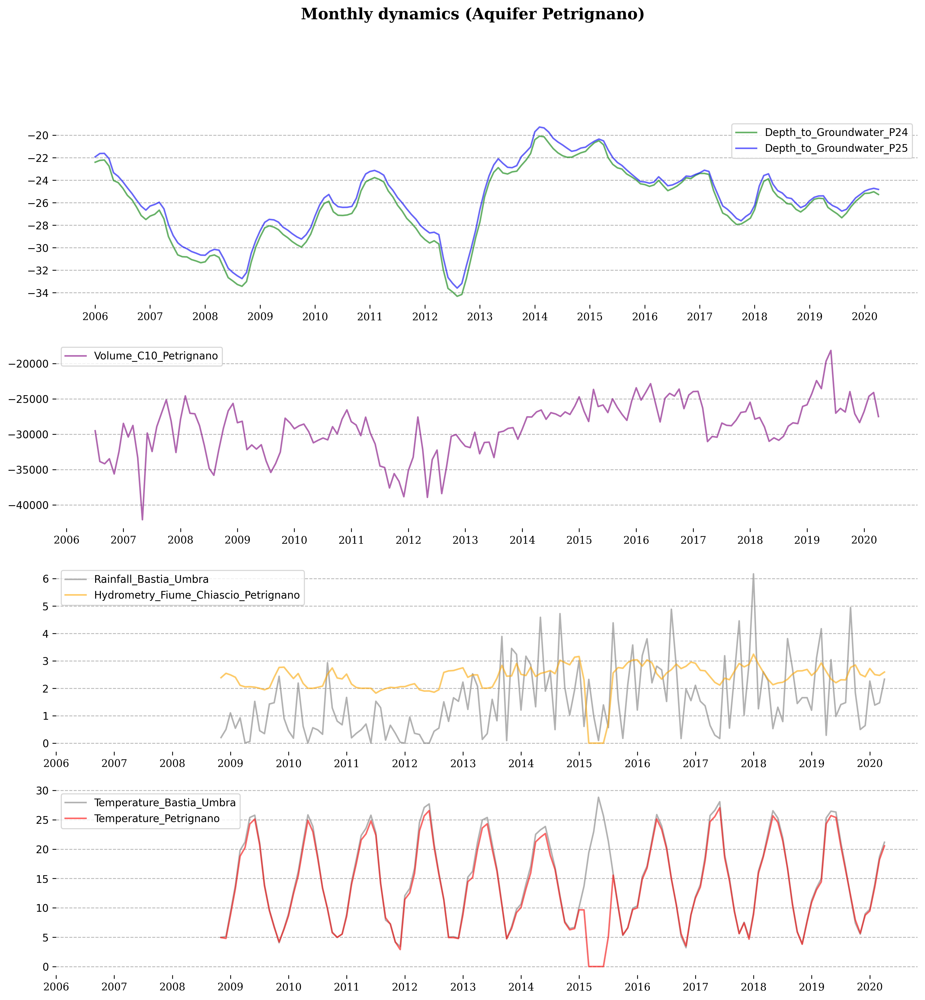

In [104]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize = (15, 15))
plt.suptitle('Monthly dynamics (Aquifer Petrignano)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = ap_means_P24, x = 'month_year', y = 'Depth_to_Groundwater_P24', 
             color = 'green', label = 'Depth_to_Groundwater_P24', alpha = 0.6,
             ax = ax1)
sns.lineplot(data = ap_means_P25, x = 'month_year', y = 'Depth_to_Groundwater_P25', 
             color = 'blue', label = 'Depth_to_Groundwater_P25', alpha = 0.6,
             ax = ax1)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(ap_temp_B.month_year[::12])
ax1.set_xticklabels(range(2006, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = ap_temp_B, x = 'month_year', y = 'Temperature_Bastia_Umbra', 
             color = 'gray', label = 'Temperature_Bastia_Umbra', alpha = 0.6,
             ax = ax4)
sns.lineplot(data = ap_temp_P, x = 'month_year', y = 'Temperature_Petrignano', 
             color = 'red', label = 'Temperature_Petrignano', alpha = 0.6,
             ax = ax4)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(ap_temp_P.month_year[::12])
ax4.set_xticklabels(range(2006, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = ap_rain, x = 'month_year', y = 'Rainfall_Bastia_Umbra', 
             color = 'grey', label = 'Rainfall_Bastia_Umbra', alpha = 0.6,
             ax = ax3)
sns.lineplot(data = ap_hydro, x = 'month_year', y = 'Hydrometry_Fiume_Chiascio_Petrignano', 
             color = 'orange', label = 'Hydrometry_Fiume_Chiascio_Petrignano', alpha = 0.6,
             ax = ax3)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(ap_rain.month_year[::12])
ax3.set_xticklabels(range(2006, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = ap_C10, x = 'month_year', y = 'Volume_C10_Petrignano', 
             color = 'purple', label = 'Volume_C10_Petrignano', alpha = 0.6,
             ax = ax2)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(ap_C10.month_year[::12])
ax2.set_xticklabels(range(2006, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

Depth_to_Groundwater_P24 and Depth_to_Groundwater_P25 are completely correlated, and therefore averaged values can be used.
There is a strange dip in monthly temperatures for Temperature_Petrignano in 2015. This is most likely due to missing values since, in general, the dynamics are almost identical to Temperature_Bastia_Umbra. The same dip is seen in the Hydrometry metric.

Most of all (judging by the graphs and correlation indices) Depth_to_Groundwater_P24 and Depth_to_Groundwater_P25 are affected by the drainage volume (Volume_C10).

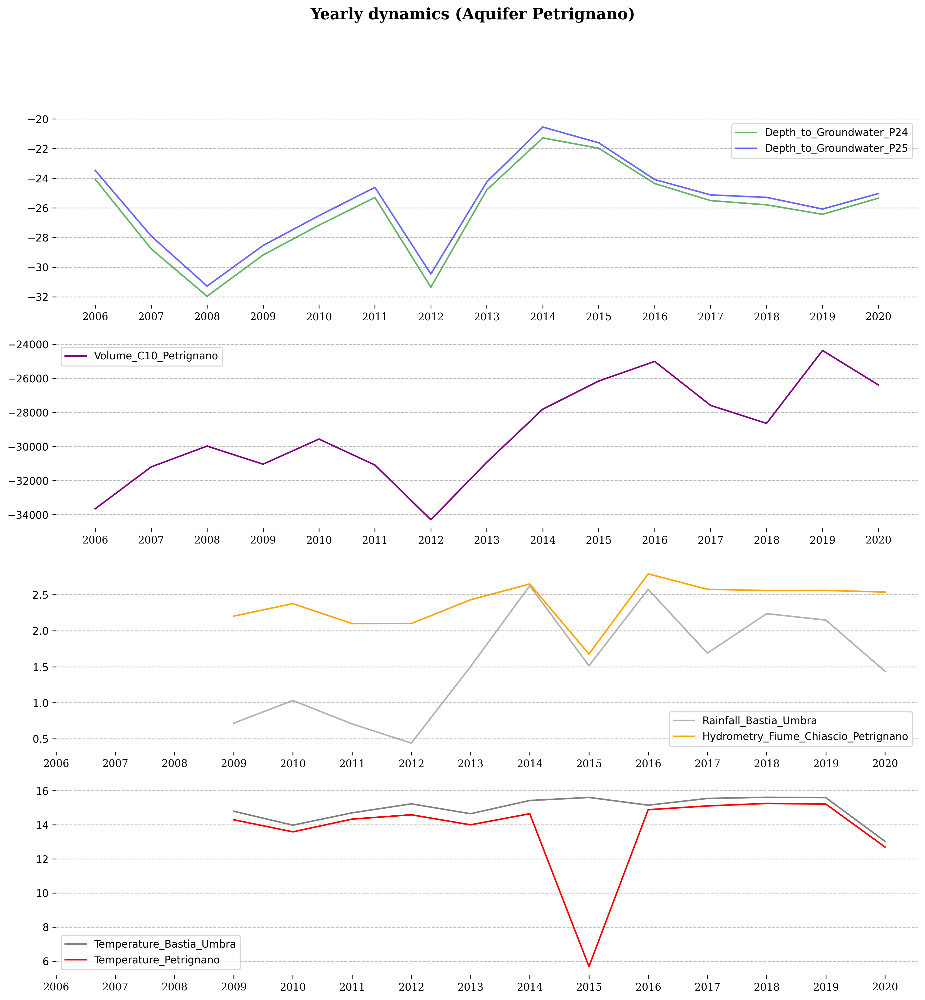

In [105]:
# Yearly dynamics
ap_means_P24_y = df.groupby('year').Depth_to_Groundwater_P24.mean().reset_index()
ap_means_P25_y = df.groupby('year').Depth_to_Groundwater_P25.mean().reset_index()
ap_rain_y = df.groupby('year').Rainfall_Bastia_Umbra.mean().reset_index()
ap_temp_B_y = df.groupby('year').Temperature_Bastia_Umbra.mean().reset_index()
ap_temp_P_y = df.groupby('year').Temperature_Petrignano.mean().reset_index()
ap_C10_y = df.groupby('year').Volume_C10_Petrignano.mean().reset_index()
ap_hydro_y = df.groupby('year').Hydrometry_Fiume_Chiascio_Petrignano.mean().reset_index()


fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize = (15, 15))
plt.suptitle('Yearly dynamics (Aquifer Petrignano)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = ap_means_P24_y, x = 'year', y = 'Depth_to_Groundwater_P24', 
             color = 'green', label = 'Depth_to_Groundwater_P24', alpha = 0.6,
             ax = ax1)
sns.lineplot(data = ap_means_P25_y, x = 'year', y = 'Depth_to_Groundwater_P25', 
             color = 'blue', label = 'Depth_to_Groundwater_P25', alpha = 0.6,
             ax = ax1)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(ap_temp_B_y.year[::1])
ax1.set_xticklabels(range(2006, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = ap_temp_B_y, x = 'year', y = 'Temperature_Bastia_Umbra', 
             color = 'gray', label = 'Temperature_Bastia_Umbra', alpha = 1,
             ax = ax4)
sns.lineplot(data = ap_temp_P_y, x = 'year', y = 'Temperature_Petrignano', 
             color = 'red', label = 'Temperature_Petrignano', alpha = 1,
             ax = ax4)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(ap_temp_P_y.year[::1])
ax4.set_xticklabels(range(2006, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = ap_rain_y, x = 'year', y = 'Rainfall_Bastia_Umbra', 
             color = 'grey', label = 'Rainfall_Bastia_Umbra', alpha = 0.6,
             ax = ax3)
sns.lineplot(data = ap_hydro_y, x = 'year', y = 'Hydrometry_Fiume_Chiascio_Petrignano', 
             color = 'orange', label = 'Hydrometry_Fiume_Chiascio_Petrignano', alpha = 1,
             ax = ax3)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(ap_rain_y.year[::1])
ax3.set_xticklabels(range(2006, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = ap_C10_y, x = 'year', y = 'Volume_C10_Petrignano', 
             color = 'purple', label = 'Volume_C10_Petrignano', alpha = 1,
             ax = ax2)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(ap_C10_y.year[::1])
ax2.set_xticklabels(range(2006, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

In 2008 and 2012, a significant increase in groundwater depth was observed. In 2012, there was a significant decrease in rainfall that also accompanied by a change in drainage volume. After 2012 up to 2014, with an increase in annual rainfall, the depth of groundwater and drainage volume became less that looks logical. There is no rainfall data for 2008.

<a id="section-3"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Petrignano (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

Base on the previous feature overview, we'll use for prediction all the data from 2009 to 2020 (because there is no data for most predictors for the 2006-2008 time period). We'll also create the 'temperature_mean' feature. Missing values will be dropped.

In [106]:
AP_pred = Aquifer_Petrignano.iloc[1024:, :]
temperature_col = [col for col in AP_pred.columns if 'Temperature' in col]

AP_pred['temperature_mean'] = AP_pred[temperature_col].mean(axis = 1).values
AP_pred = AP_pred.dropna()

AP_pred

,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano,temperature_mean
Date,,,,,,,,
01/01/2009,0.0,-31.96,-31.14,5.2,4.9,-24530.688,2.4,5.05
02/01/2009,0.0,-32.03,-31.11,2.3,2.5,-28785.888,2.5,2.40
03/01/2009,0.0,-31.97,-31.07,4.4,3.9,-25766.208,2.4,4.15
04/01/2009,0.0,-31.91,-31.05,0.8,0.8,-27919.296,2.4,0.80
05/01/2009,0.0,-31.94,-31.01,-1.9,-2.1,-29854.656,2.3,-2.00
...,...,...,...,...,...,...,...,...
26/06/2020,0.0,-25.68,-25.07,25.7,24.5,-29930.688,2.5,25.10
27/06/2020,0.0,-25.80,-25.11,26.2,25.0,-31332.960,2.4,25.60
28/06/2020,0.0,-25.80,-25.19,26.9,25.7,-32120.928,2.4,26.30


Then we'll split our data on a train (70%) and a test (30%) datasets without shuffling(!). Thus, we'll train the model on data obtained before 2017 and check it on data for 2017-2020.

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [107]:
y_grw_p24 = AP_pred['Depth_to_Groundwater_P24']
y_grw_p25 = AP_pred['Depth_to_Groundwater_P25']
X = AP_pred.drop(['Depth_to_Groundwater_P24', 'Depth_to_Groundwater_P25'], axis = 1)


X_train, X_test, y_train_p24, y_test_p24 = train_test_split(X, y_grw_p24, train_size = 0.7, shuffle = False)
y_train_p25, y_test_p25 = train_test_split(y_grw_p25, train_size = 0.7, shuffle = False)

In [108]:
params = {'n_estimators': 200,
          'max_depth': 4,
          'subsample': 1,
          'learning_rate': 0.03,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train_p24)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.03, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=200, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

In [109]:
y_pred_p24 = model.predict(X_test)

print('MAE value (Depth_to_Groundwater_P24): %.4f' 
      %mean_absolute_error(y_test_p24, y_pred_p24))

MAE value (Depth_to_Groundwater_P24): 1.6725


The mean absolute error of the predicted values is 1.7016, which means that, on average, our model makes a mistake by 1.7 meters. Let's look at the feature importances.

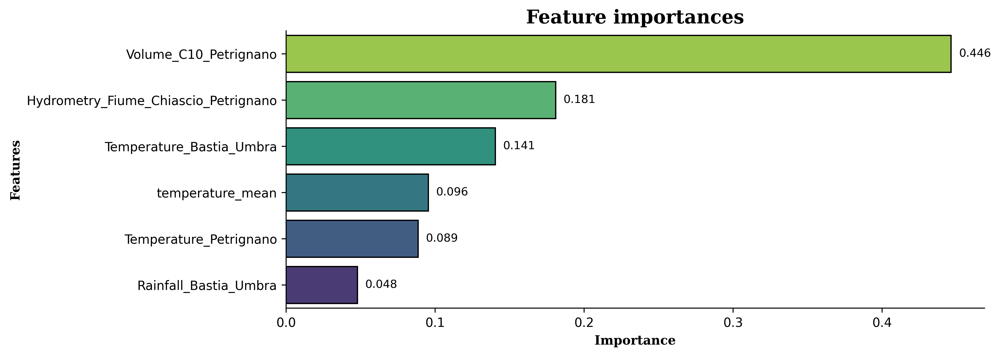

In [110]:
model_imp_viz(model, X_train, bias = 0.016)

As expected, the Volume feature has a powerful effect on the Depth_to_Groundwater_P24 indicator.

Now, let's check how well the model predicts the average monthly values of the Depth_to_Groundwater_P24 indicator.

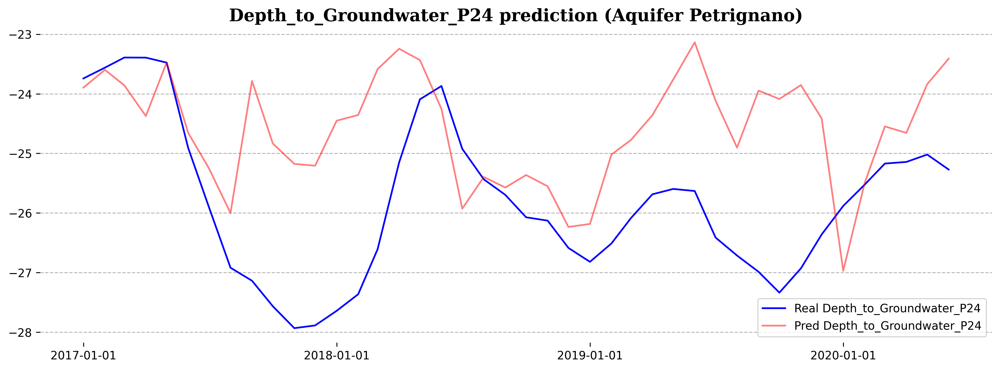

In [111]:
predicted_viz(y_test_p24, y_pred_p24, 'Depth_to_Groundwater_P24', 'Aquifer Petrignano')

The model recognizes fluctuations in the Depth_to_Groundwater feature but consistently overestimates the results. In addition, the prediction for 2020 looks extremely strange.

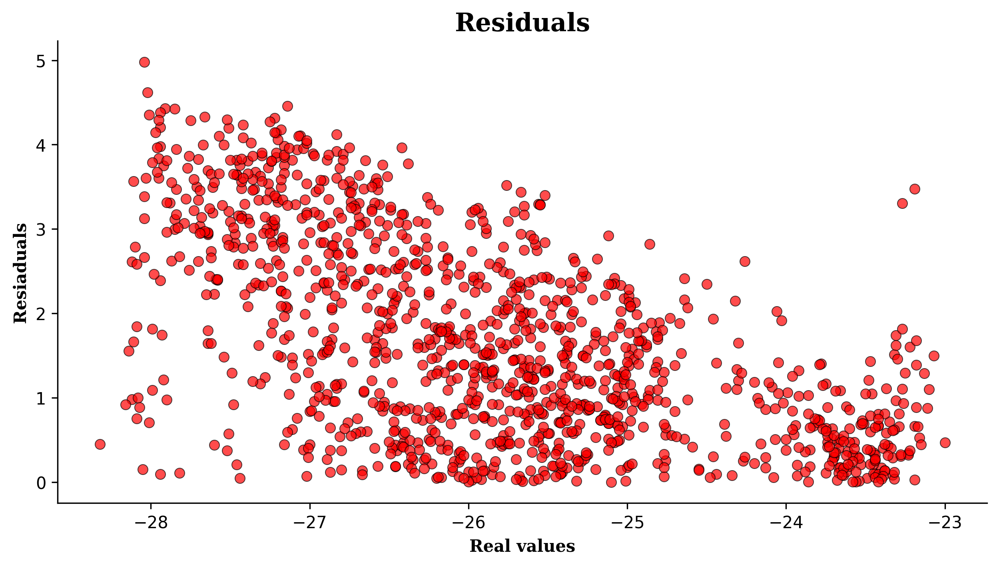

In [112]:
resid_viz(y_test_p24, y_pred_p24)

The residuals have a linear relationship, and the greater the depth, the larger the residuals.

Most likely, we will see exactly the same situation for the second indicator, since they are almost identical.

In [113]:
params = {'n_estimators': 200,
          'max_depth': 4,
          'subsample': 1,
          'learning_rate': 0.03,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train_p25)

y_pred_p25 = model.predict(X_test)
print('MAE value (Depth_to_Groundwater_P25): %.4f' 
      %mean_absolute_error(y_test_p25, y_pred_p25))

MAE value (Depth_to_Groundwater_P25): 1.7620


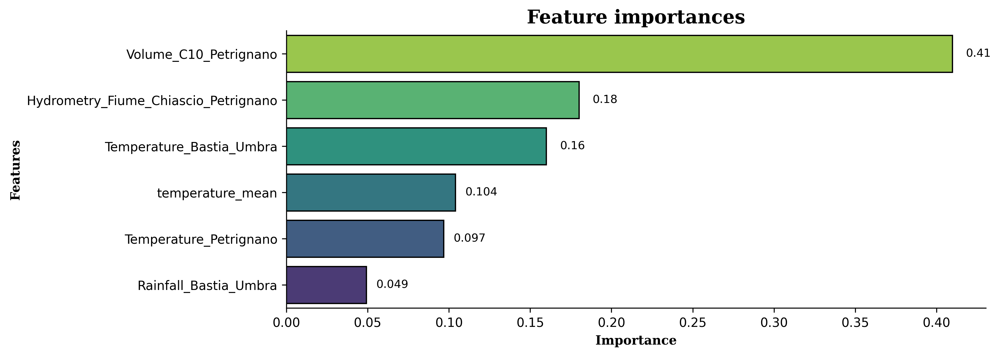

In [114]:
model_imp_viz(model, X_train, bias = 0.016)

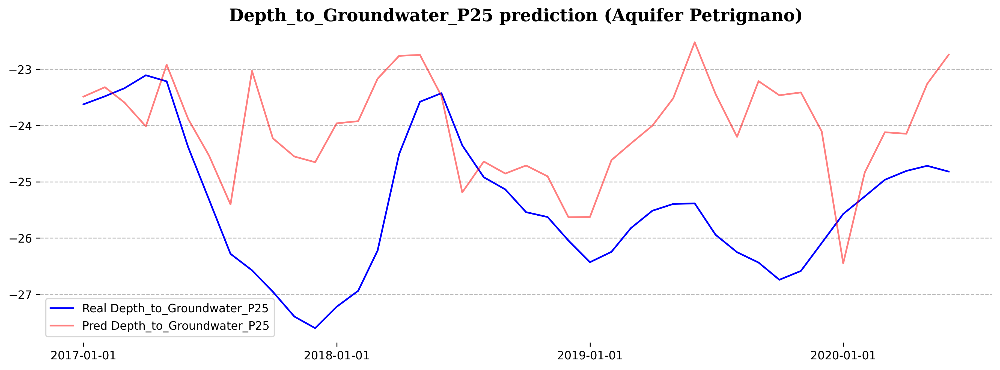

In [115]:
predicted_viz(y_test_p25, y_pred_p25, 'Depth_to_Groundwater_P25', 'Aquifer Petrignano')

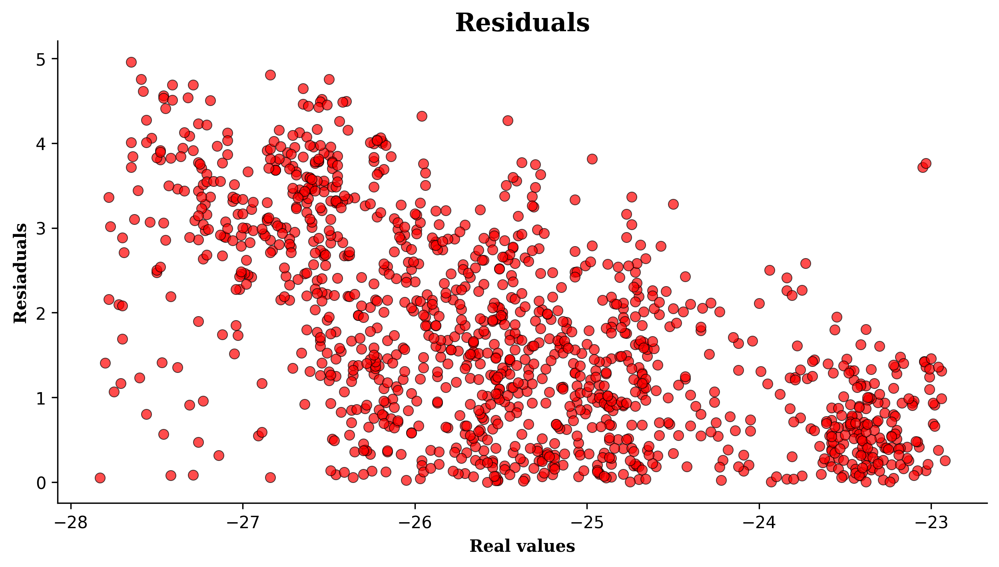

In [116]:
resid_viz(y_test_p25, y_pred_p25)

The predictions for Depth_to_Groundwater_P25 are almost identical. 

The model predicts some time points well, but at the same time it is noticeably wrong in the periods when the depth increases. Apparently, we do not have enough data for prediction, since the dominant predictor - the drainage feature - does not allow the model to predict strong drops in groundwater level well. The rest of the predictors have a rather small contribution to the quality of the model.

Ideas for future improvement:
- try a deeper feature preprocessing (it might be worth trying to create a feature that will reflect seasonality)
- try other algorithms

<a id="section-nineteen"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Auser (features)</center></h2>

[**Back to the table of contents**](#section-start)

This waterbody consists of two subsystems, called NORTH and SOUTH, where the former partly influences the behavior of the latter. Indeed, the north subsystem is a water table (or unconfined) aquifer while the south subsystem is an artesian (or confined) groundwater.

The levels of the NORTH sector are represented by the values of the SAL, PAG, CoS and DIEC wells, while the levels of the SOUTH sector by the LT2 well.

In [120]:
# Ensure 'month_year' is datetime and sort the dataframe
df['month_year'] = pd.to_datetime(df['month_year'])

# Group and calculate the mean for each 'month_year'
# Select only numeric columns before calculating the mean
numeric_cols = df.select_dtypes(include=['number']).columns
aa_means = df.groupby('month_year')[numeric_cols].mean().reset_index()

# Define column groups
rainfall_col = [col for col in aa_means.columns if 'Rainfall' in col]
temperature_col = [col for col in aa_means.columns if 'Temperature' in col]
volume_col = [col for col in aa_means.columns if 'Volume' in col]
hydrometry_col = [col for col in aa_means.columns if 'Hydrometry' in col]
groundwater_col = [col for col in aa_means.columns if 'Depth_to_Groundwater' in col]

# Calculate mean rainfall, ensuring columns exist and are numeric
if rainfall_col:
    aa_means['rainfall'] = aa_means[rainfall_col].mean(axis=1)


In [121]:
# df = Aquifer_Auser.reset_index()
# # df['year'] = pd.to_datetime(df.Date).dt.year
# # df['month'] = pd.to_datetime(df.Date).dt.month
# df['year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.year
# df['month'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.month

# # Monthly dynamics
# # df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))
# df['month_year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).apply(lambda x: x.strftime('%Y/%m'))

# aa_means = df.groupby('month_year').mean().reset_index()
# aa_means['month_year'] = pd.to_datetime(aa_means['month_year'])

# rainfall_col = [col for col in aa_means.columns if 'Rainfall' in col]
# temperature_col = [col for col in aa_means.columns if 'Temperature' in col]
# volume_col = [col for col in aa_means.columns if 'Volume' in col]
# hydrometry_col = [col for col in aa_means.columns if 'Hydrometry' in col]
# groundwater_col = [col for col in aa_means.columns if 'Depth_to_Groundwater' in col]

# aa_means['rainfall'] = aa_means[rainfall_col].mean(axis = 1)

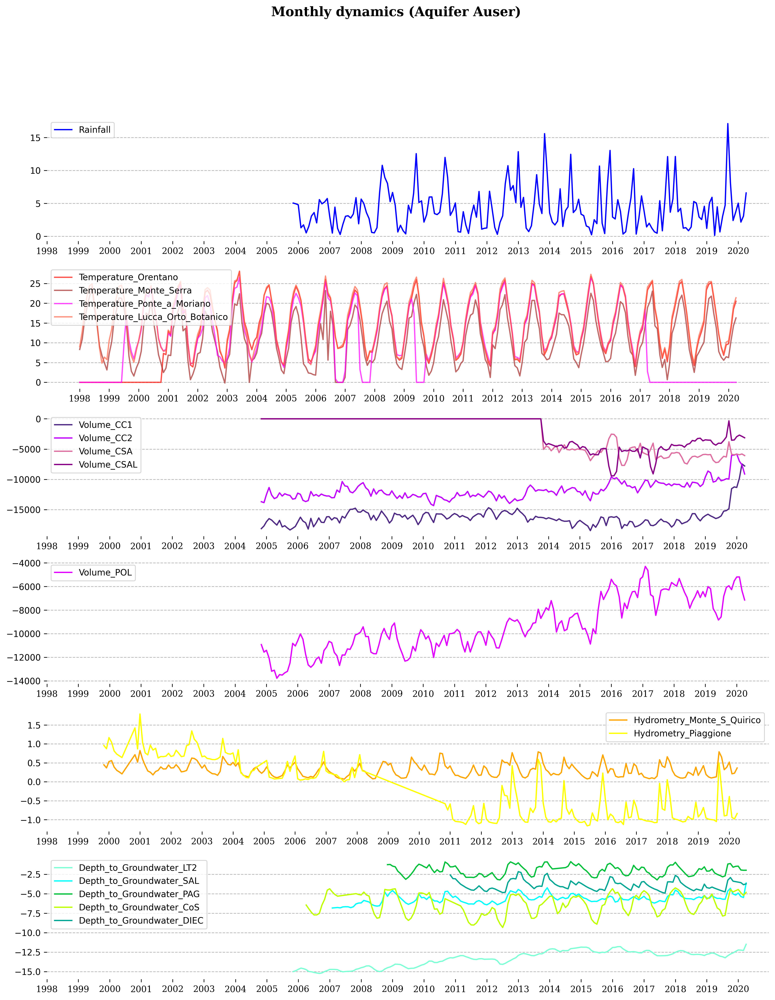

In [122]:
fig, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, 1, figsize = (15, 18))
plt.suptitle('Monthly dynamics (Aquifer Auser)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = aa_means, x = 'month_year', y = 'rainfall', 
             color = 'blue', label = 'Rainfall', alpha = 1,
             ax = ax1)

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(aa_means.month_year[::12])
ax1.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#FF0800', '#A52A2A', '#FF00FF', '#FF6347']
n = 0
for i in temperature_col:
    sns.lineplot(data = aa_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 0.7,
                 ax = ax2)
    n +=1

for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(aa_means.month_year[::12])
ax2.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#4E2A84', '#BF00FF', '#DE6FA1', '#880085']
n = 0
for i in volume_col[1:]:
    sns.lineplot(data = aa_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax3)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(aa_means.month_year[::12])
ax3.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = aa_means, x = 'month_year', y = volume_col[0], 
             color = '#DF00FF', label = volume_col[0], alpha = 1,
             ax = ax4)

for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(aa_means.month_year[::12])
ax4.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['orange', 'yellow']
n = 0
for i in hydrometry_col:
    sns.lineplot(data = aa_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax5)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax5.spines[i].set_visible(False)

ax5.set_xticks(aa_means.month_year[::12])
ax5.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
ax5.set_xlabel('')
ax5.set_ylabel('')
ax5.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#7FFFD4', '#00FFFF', '#03C03C', '#BFFF00', '#00A693']
n = 0
for i in groundwater_col:
    sns.lineplot(data = aa_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax6)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax6.spines[i].set_visible(False)

ax6.set_xticks(aa_means.month_year[::12])
ax6.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
ax6.set_xlabel('')
ax6.set_ylabel('')
ax6.grid(axis = 'y', linestyle = '--', alpha = 0.9)

plt.show()

The dynamic of rainfall looks logical and covers the period from 2006 to 2020.

The temperature dynamics have no obvious missing values, but some time periods for the two indicators look strange (most likely zero values are missing values in the measurements).

Volume_POL, Volume_CSA, and Volume_CSAL have very sharp jumps in values after certain time points (especially Volume_POL) (it would be very interesting to know the reason for such strong changes; I have found none scientific papers about that yet). In general, the volume indicators vary in great ranges of values, which is why I didn't dare to average them, as I did with the rainfall indicators.

Hydrometry and depth to groundwater indicators are stable and consistent with logical seasonal patterns. Only the Hydrometry_Piaggione feature had a significant decrease in values after the 2009-2011 period (again, interesting to know the reason).

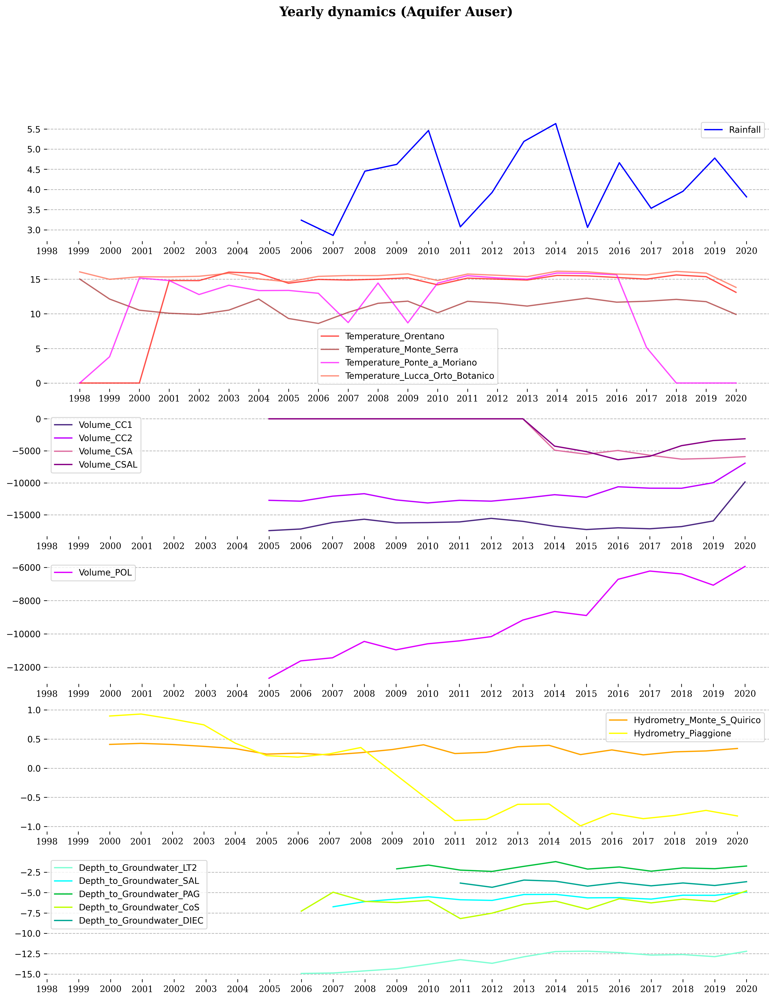

In [125]:
# Select only numeric columns for grouping and mean calculation, excluding 'year'
numeric_cols = df.select_dtypes(include=['number']).columns
numeric_cols = numeric_cols[numeric_cols != 'year']

# Perform the groupby and mean calculation
aa_means_y = df.groupby('year')[numeric_cols].mean().reset_index()

# Calculate mean rainfall if columns exist
if rainfall_col:
    aa_means_y['rainfall'] = aa_means_y[rainfall_col].mean(axis=1)

# Set up the figure and axes for the plots
fig, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, 1, figsize=(15, 18))
plt.suptitle('Yearly dynamics (Aquifer Auser)', size=15, fontweight='bold', fontfamily='serif')

# Rainfall plot
sns.lineplot(data=aa_means_y, x='year', y='rainfall', color='blue', label='Rainfall', alpha=1, ax=ax1)
ax1.set_xticks(aa_means_y['year'][::1])
ax1.set_xticklabels(range(1998, 2021, 1), fontfamily='serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis='y', linestyle='--', alpha=0.9)
for i in ['top', 'right', 'bottom', 'left']:
    ax1.spines[i].set_visible(False)

# Temperature plot
colors = ['#FF0800', '#A52A2A', '#FF00FF', '#FF6347']
for n, i in enumerate(temperature_col):
    sns.lineplot(data=aa_means_y, x='year', y=i, color=colors[n], label=i, alpha=0.7, ax=ax2)
ax2.set_xticks(aa_means_y['year'][::1])
ax2.set_xticklabels(range(1998, 2021, 1), fontfamily='serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis='y', linestyle='--', alpha=0.9)
for i in ['top', 'right', 'bottom', 'left']:
    ax2.spines[i].set_visible(False)

# Volume plot
colors = ['#4E2A84', '#BF00FF', '#DE6FA1', '#880085']
for n, i in enumerate(volume_col[1:]):
    sns.lineplot(data=aa_means_y, x='year', y=i, color=colors[n], label=i, alpha=1, ax=ax3)
ax3.set_xticks(aa_means_y['year'][::1])
ax3.set_xticklabels(range(1998, 2021, 1), fontfamily='serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis='y', linestyle='--', alpha=0.9)
for i in ['top', 'right', 'bottom', 'left']:
    ax3.spines[i].set_visible(False)

# Volume plot for first volume column
sns.lineplot(data=aa_means_y, x='year', y=volume_col[0], color='#DF00FF', label=volume_col[0], alpha=1, ax=ax4)
ax4.set_xticks(aa_means_y['year'][::1])
ax4.set_xticklabels(range(1998, 2021, 1), fontfamily='serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis='y', linestyle='--', alpha=0.9)
for i in ['top', 'right', 'bottom', 'left']:
    ax4.spines[i].set_visible(False)

# Hydrometry plot
colors = ['orange', 'yellow']
for n, i in enumerate(hydrometry_col):
    sns.lineplot(data=aa_means_y, x='year', y=i, color=colors[n], label=i, alpha=1, ax=ax5)
ax5.set_xticks(aa_means_y['year'][::1])
ax5.set_xticklabels(range(1998, 2021, 1), fontfamily='serif')
ax5.set_xlabel('')
ax5.set_ylabel('')
ax5.grid(axis='y', linestyle='--', alpha=0.9)
for i in ['top', 'right', 'bottom', 'left']:
    ax5.spines[i].set_visible(False)

# Groundwater plot
colors = ['#7FFFD4', '#00FFFF', '#03C03C', '#BFFF00', '#00A693']
for n, i in enumerate(groundwater_col):
    sns.lineplot(data=aa_means_y, x='year', y=i, color=colors[n], label=i, alpha=1, ax=ax6)
ax6.set_xticks(aa_means_y['year'][::1])
ax6.set_xticklabels(range(1998, 2021, 1), fontfamily='serif')
ax6.set_xlabel('')
ax6.set_ylabel('')
ax6.grid(axis='y', linestyle='--', alpha=0.9)
for i in ['top', 'right', 'bottom', 'left']:
    ax6.spines[i].set_visible(False)

plt.show()


In [126]:
# # Yearly dynamics
# aa_means_y = df.groupby('year').mean().reset_index()
# aa_means_y['rainfall'] = aa_means_y[rainfall_col].mean(axis = 1)

# fig, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(6, 1, figsize = (15, 18))
# plt.suptitle('Yearly dynamics (Aquifer Auser)', size = 15, fontweight = 'bold', fontfamily = 'serif')

# sns.lineplot(data = aa_means_y, x = 'year', y = 'rainfall', 
#              color = 'blue', label = 'Rainfall', alpha = 1,
#              ax = ax1)

# for i in ['top', 'right', 'bottom', 'left']:
#         ax1.spines[i].set_visible(False)

# ax1.set_xticks(aa_means_y.year[::1])
# ax1.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
# ax1.set_xlabel('')
# ax1.set_ylabel('')
# ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



# colors = ['#FF0800', '#A52A2A', '#FF00FF', '#FF6347']
# n = 0
# for i in temperature_col:
#     sns.lineplot(data = aa_means_y, x = 'year', y = i, 
#                  color = colors[n], label = i, alpha = 0.7,
#                  ax = ax2)
#     n +=1

# for i in ['top', 'right', 'bottom', 'left']:
#         ax2.spines[i].set_visible(False)

# ax2.set_xticks(aa_means_y.year[::1])
# ax2.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
# ax2.set_xlabel('')
# ax2.set_ylabel('')
# ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)



# colors = ['#4E2A84', '#BF00FF', '#DE6FA1', '#880085']
# n = 0
# for i in volume_col[1:]:
#     sns.lineplot(data = aa_means_y, x = 'year', y = i, 
#                  color = colors[n], label = i, alpha = 1,
#                  ax = ax3)
#     n += 1

# for i in ['top', 'right', 'bottom', 'left']:
#         ax3.spines[i].set_visible(False)

# ax3.set_xticks(aa_means_y.year[::1])
# ax3.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
# ax3.set_xlabel('')
# ax3.set_ylabel('')
# ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)



# sns.lineplot(data = aa_means_y, x = 'year', y = volume_col[0], 
#              color = '#DF00FF', label = volume_col[0], alpha = 1,
#              ax = ax4)

# for i in ['top', 'right', 'bottom', 'left']:
#         ax4.spines[i].set_visible(False)

# ax4.set_xticks(aa_means_y.year[::1])
# ax4.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
# ax4.set_xlabel('')
# ax4.set_ylabel('')
# ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)



# colors = ['orange', 'yellow']
# n = 0
# for i in hydrometry_col:
#     sns.lineplot(data = aa_means_y, x = 'year', y = i, 
#                  color = colors[n], label = i, alpha = 1,
#                  ax = ax5)
#     n += 1

# for i in ['top', 'right', 'bottom', 'left']:
#         ax5.spines[i].set_visible(False)

# ax5.set_xticks(aa_means_y.year[::1])
# ax5.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
# ax5.set_xlabel('')
# ax5.set_ylabel('')
# ax5.grid(axis = 'y', linestyle = '--', alpha = 0.9)



# colors = ['#7FFFD4', '#00FFFF', '#03C03C', '#BFFF00', '#00A693']
# n = 0
# for i in groundwater_col:
#     sns.lineplot(data = aa_means_y, x = 'year', y = i, 
#                  color = colors[n], label = i, alpha = 1,
#                  ax = ax6)
#     n += 1

# for i in ['top', 'right', 'bottom', 'left']:
#         ax6.spines[i].set_visible(False)

# ax6.set_xticks(aa_means_y.year[::1])
# ax6.set_xticklabels(range(1998, 2021, 1), fontfamily = 'serif')
# ax6.set_xlabel('')
# ax6.set_ylabel('')
# ax6.grid(axis = 'y', linestyle = '--', alpha = 0.9)

# plt.show()

The rainfall feature fluctuates in 3-5-year periods and roughly coincides with the rainfall dynamic for Aquifer Petrignano (with slight differences).

The dynamics of Temperature_Ponte_a_Moriano looks really strange.

In most of the Volume indicators, after the jump in values in 2013, a gradual decrease in depth is observed up to 2020.

It is worth noting that many temperature and volume indicators correlate significantly with depth to groundwater, which is good news (see corr_plot above).

<a id="section-4"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Auser (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

Base on the previous feature overview, we'll use for prediction the data from 2007 to 2020 (because there is no data for most features for the 1998-2006 time period). We'll also create 'rainfal_mean', 'temperature_mean', 'volume_mean' and 'hydrometry_mean' features. Some columns with missing values will be dropped. Missing values will be fill by 'bfill' method.

In [127]:
AA_pred = Aquifer_Auser.iloc[3224:, :]
rainfall_col = [col for col in AA_pred.columns if 'Rainfall' in col]
temperature_col = [col for col in AA_pred.columns if 'Temperature' in col]
volume_col = [col for col in AA_pred.columns if 'Volume' in col]
hydrometry_col = [col for col in AA_pred.columns if 'Hydrometry' in col]

AA_pred['rainfall_mean'] = AA_pred[rainfall_col].mean(axis = 1).values
AA_pred['temperature_mean'] = AA_pred[temperature_col].mean(axis = 1).values
AA_pred['volume_mean'] = AA_pred[volume_col].mean(axis = 1).values
AA_pred['hydrometry_mean'] = AA_pred[hydrometry_col].mean(axis = 1).values
AA_pred = AA_pred.drop(['Depth_to_Groundwater_PAG', 'Depth_to_Groundwater_DIEC',
                        'Temperature_Ponte_a_Moriano', 'Temperature_Orentano',
                        'Volume_CSA', 'Volume_CSAL'], axis = 1)
AA_pred = AA_pred.fillna(method = 'bfill')

AA_pred

,Rainfall_Gallicano,Rainfall_Pontetetto,Rainfall_Monte_Serra,Rainfall_Orentano,Rainfall_Borgo_a_Mozzano,Rainfall_Piaggione,Rainfall_Calavorno,Rainfall_Croce_Arcana,Rainfall_Tereglio_Coreglia_Antelminelli,Rainfall_Fabbriche_di_Vallico,...,Temperature_Lucca_Orto_Botanico,Volume_POL,Volume_CC1,Volume_CC2,Hydrometry_Monte_S_Quirico,Hydrometry_Piaggione,rainfall_mean,temperature_mean,volume_mean,hydrometry_mean
Date,,,,,,,,,,,,,,,,,,,,,
01/01/2007,4.0,8.4,25.6,9.6,6.0,10.6,4.2,1.8,21.6,5.2,...,13.15,-11492.677420,-17254.080,-12727.878710,0.24,0.65,9.70,6.7500,-8294.927226,0.240
02/01/2007,28.6,12.0,0.2,6.6,32.8,39.4,34.4,8.8,9.0,38.8,...,9.70,-11492.677420,-17254.080,-12727.878710,0.48,0.65,21.06,5.6375,-8294.927226,0.480
03/01/2007,0.0,0.0,0.0,0.0,0.2,0.0,0.2,0.2,0.0,0.0,...,6.00,-11492.677420,-17254.080,-12727.878710,0.40,0.65,0.06,3.1000,-8294.927226,0.400
04/01/2007,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.8,0.0,...,3.10,-11492.677420,-17254.080,-12727.878710,0.36,0.65,0.78,2.2250,-8294.927226,0.360
05/01/2007,7.6,0.0,0.0,0.0,5.4,2.2,5.8,0.0,0.0,7.0,...,8.05,-11492.677420,-17254.080,-12727.878710,0.33,0.65,2.80,2.9750,-8294.927226,0.330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26/06/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,23.75,-7189.406533,-7847.900,-9183.433333,0.20,-1.03,0.00,16.9250,-6698.827973,-0.415
27/06/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,24.30,-7189.406533,-7847.900,-9183.433333,0.21,-1.03,0.00,17.3125,-6698.827973,-0.410
28/06/2020,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,24.55,-6829.936207,-7455.505,-8724.261667,0.23,-1.03,0.00,17.5750,-6363.886575,-0.400


Then we'll split our data on a train (74%) and a test (26%) datasets without shuffling(!). Thus, we'll train the model on data obtained before 2017 and check it on data for 2017-2020.

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [128]:
y = AA_pred[['Depth_to_Groundwater_LT2', 'Depth_to_Groundwater_SAL', 
             'Depth_to_Groundwater_CoS']]
X = AA_pred.drop(['Depth_to_Groundwater_LT2', 'Depth_to_Groundwater_SAL', 
                  'Depth_to_Groundwater_CoS'], axis = 1)


X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.741, shuffle = False)

In [129]:
params_0 = {'n_estimators': 200,
            'max_depth': 6,
            'subsample': 1,
            'learning_rate': 0.03,
            'random_state': 0}
params_1 = {'n_estimators': 150,
            'max_depth': 6,
            'subsample': 1,
            'learning_rate': 0.03,
            'random_state': 0}
params_2 = {'n_estimators': 150,
            'max_depth': 6,
            'subsample': 1,
            'learning_rate': 0.03,
            'random_state': 0}

model_LT2 = XGBRegressor(**params_0)
model_SAL = XGBRegressor(**params_1)
model_CoS = XGBRegressor(**params_2)

model_LT2.fit(X_train, y_train.iloc[:, 0])
model_SAL.fit(X_train, y_train.iloc[:, 1])
model_CoS.fit(X_train, y_train.iloc[:, 2])

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.03, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=150, n_jobs=None,
             num_parallel_tree=None, random_state=0, ...)

In [130]:
y_pred_LT2 = model_LT2.predict(X_test)
y_pred_SAL = model_SAL.predict(X_test)
y_pred_CoS = model_CoS.predict(X_test)

print('MAE value (Depth_to_Groundwater_LT2): %.4f' 
      %mean_absolute_error(y_test.iloc[:, 0], y_pred_LT2))
print('MAE value (Depth_to_Groundwater_SAL): %.4f' 
      %mean_absolute_error(y_test.iloc[:, 1], y_pred_SAL))
print('MAE value (Depth_to_Groundwater_CoS): %.4f' 
      %mean_absolute_error(y_test.iloc[:, 2], y_pred_CoS))

MAE value (Depth_to_Groundwater_LT2): 0.4126
MAE value (Depth_to_Groundwater_SAL): 0.3627
MAE value (Depth_to_Groundwater_CoS): 0.5118


The mean absolute error of the predicted values for the 3 features varies from 0.31 to 0.44, which means that, on average, our models make a mistake by 0.3-0.4 meters. Let's look at the feature importances.

Depth_to_Groundwater_LT2


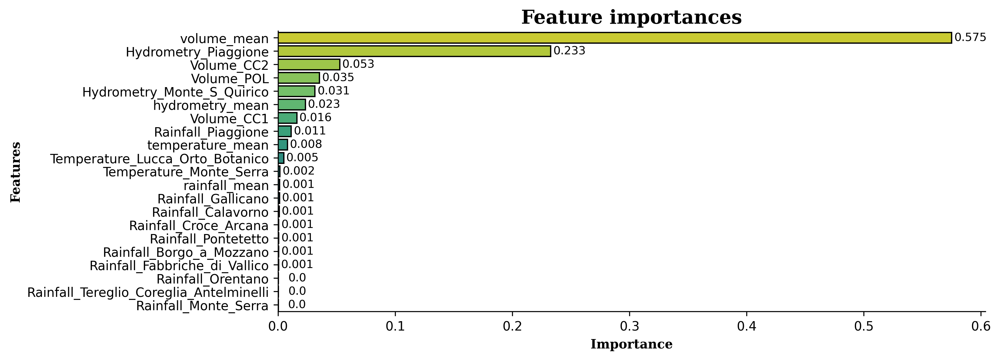

Depth_to_Groundwater_SAL


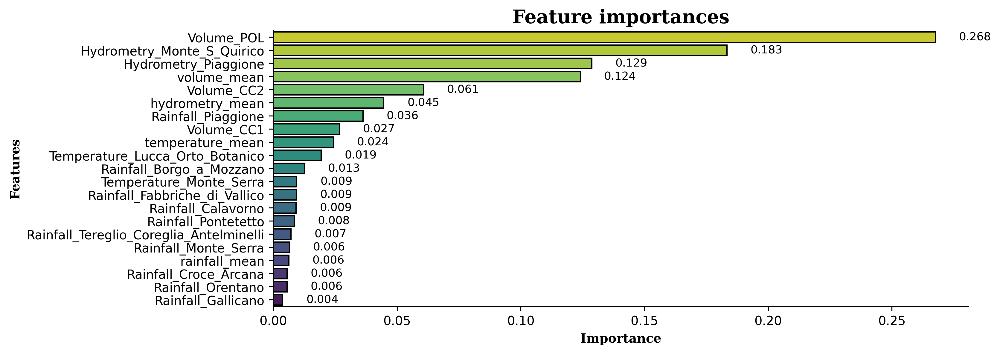

Depth_to_Groundwater_CoS


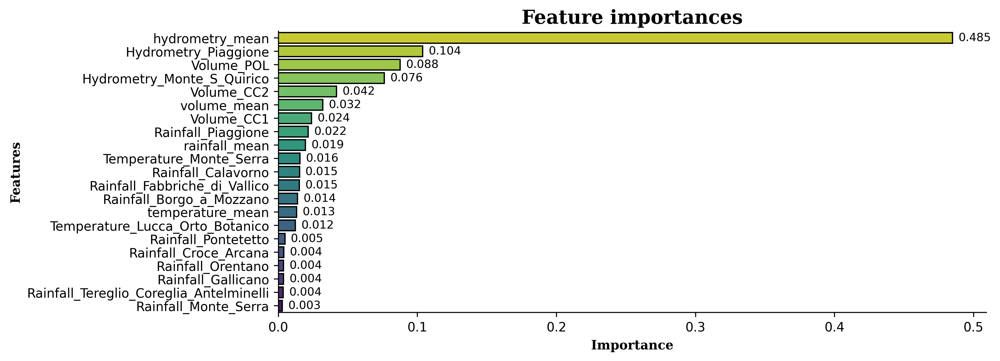

In [131]:
print('Depth_to_Groundwater_LT2')
model_imp_viz(model_LT2, X_train, bias = 0.016)

print('Depth_to_Groundwater_SAL')
model_imp_viz(model_SAL, X_train, bias = 0.016)

print('Depth_to_Groundwater_CoS')
model_imp_viz(model_CoS, X_train, bias = 0.016)

For all three predicted values, hydrometry and volume are important. Individual rainfall indicators seem to be practically useless.

Now, let's check how well the model predicts the average monthly values of the Depth_to_Groundwater indicators.

In [133]:
def predicted_viz(y_test, y_pred, param, name):
    rm = y_test.reset_index()
    
    # Convert the Date column to datetime with the correct format (day/month/year)
    rm['month_year'] = pd.to_datetime(rm['Date'], format='%d/%m/%Y').apply(lambda x: x.strftime('%Y/%m'))
    
    # Group by month_year and calculate mean for the parameter
    rm_means = rm.groupby('month_year')[param].mean().reset_index()
    
    # Convert month_year back to datetime for plotting
    rm_means['month_year'] = pd.to_datetime(rm_means['month_year'], format='%Y/%m')
    
    # Plotting logic
    plt.figure(figsize=(12, 6))
    plt.plot(rm_means['month_year'], rm_means[param], label=f'Mean {param}')
    plt.title(f'{param} Prediction vs Actual ({name})', fontsize=14)
    plt.xlabel('Month/Year')
    plt.ylabel(param)
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.legend()
    plt.show()


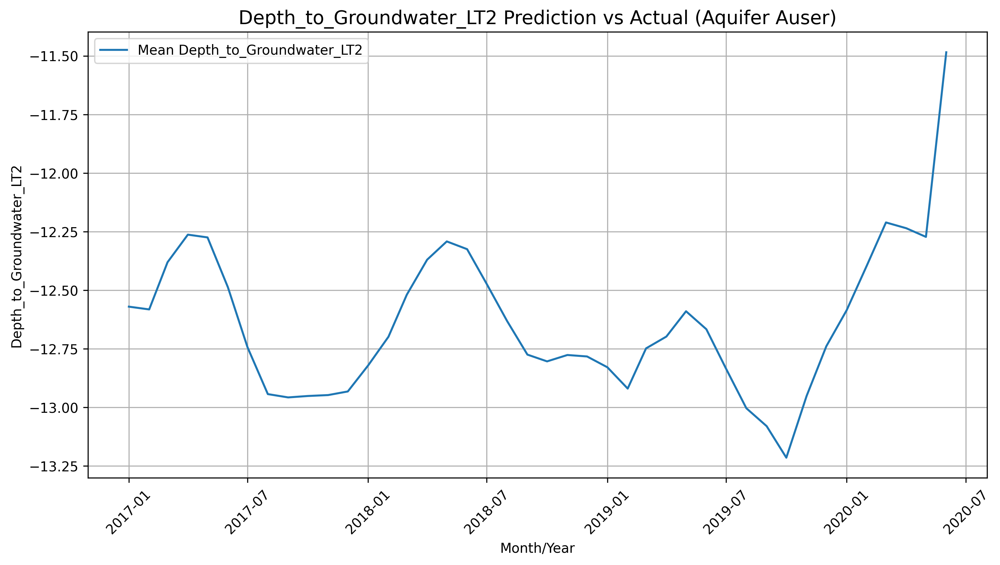

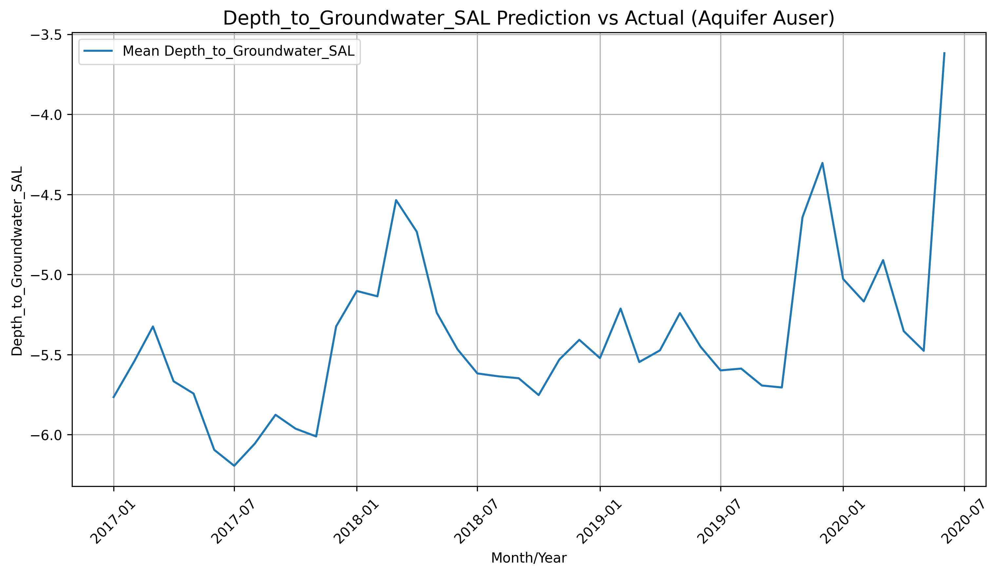

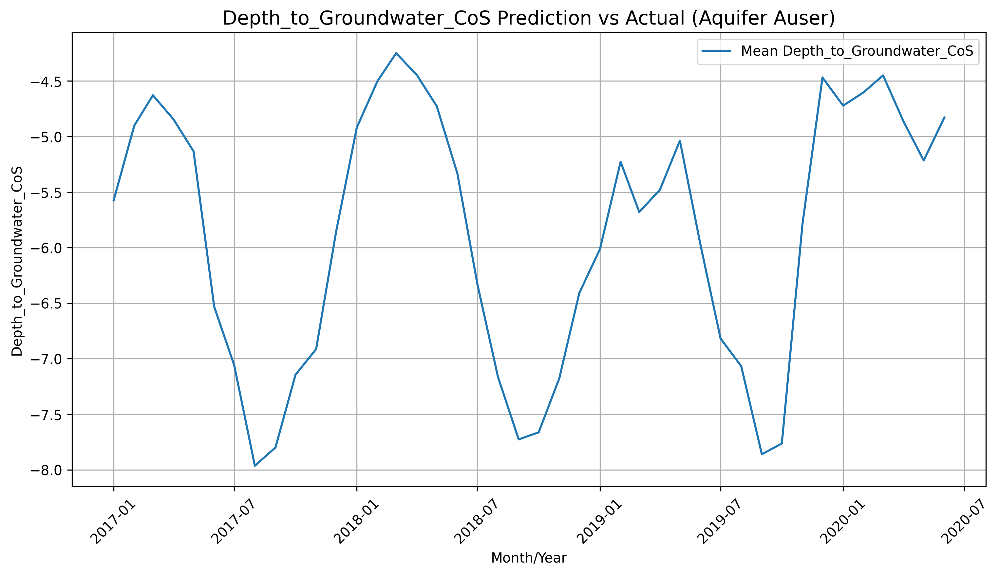

In [134]:
predicted_viz(y_test.iloc[:, 0], y_pred_LT2, 'Depth_to_Groundwater_LT2', 'Aquifer Auser')
predicted_viz(y_test.iloc[:, 1], y_pred_SAL, 'Depth_to_Groundwater_SAL', 'Aquifer Auser')
predicted_viz(y_test.iloc[:, 2], y_pred_CoS, 'Depth_to_Groundwater_CoS', 'Aquifer Auser')

Hmm, it looks pretty good (especially Depth_to_Groundwater_CoS). The model is still flawed in predicting peaks (perhaps because they are sometimes associated with factors that are not represented in the data?), but in general, the dynamics of values are predicted well.

Depth_to_Groundwater_LT2


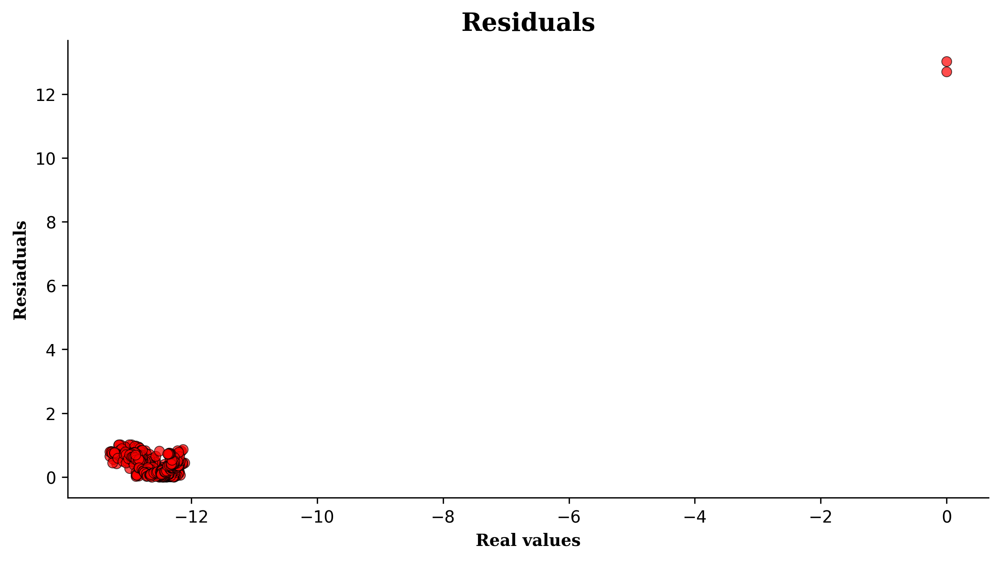

Depth_to_Groundwater_SAL


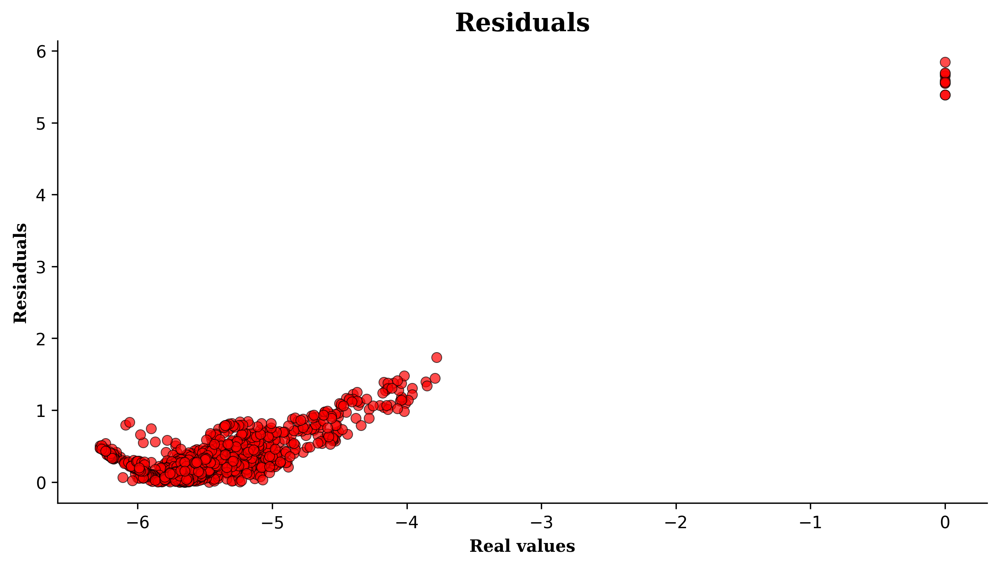

Depth_to_Groundwater_CoS


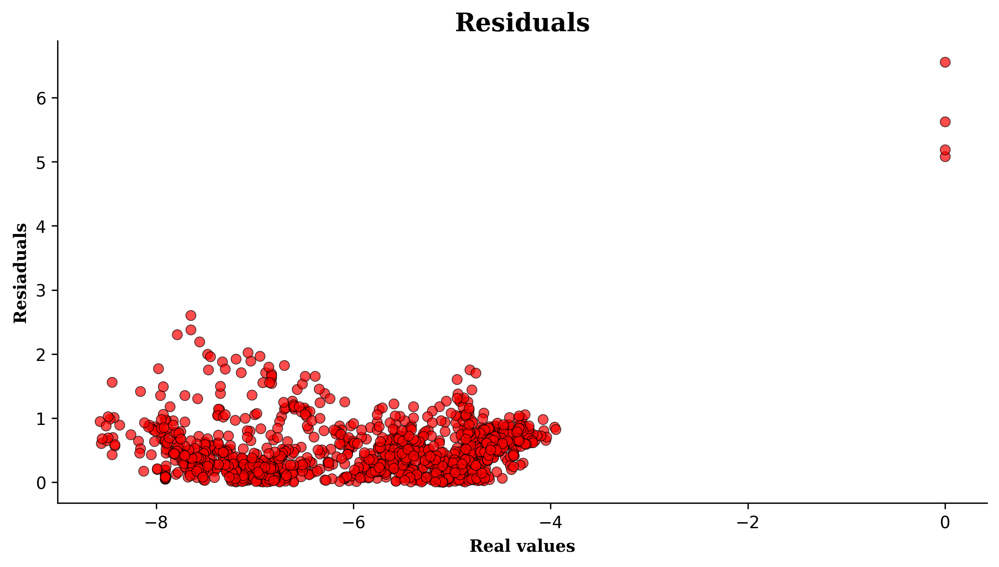

In [135]:
print('Depth_to_Groundwater_LT2')
resid_viz(y_test.iloc[:, 0], y_pred_LT2)

print('Depth_to_Groundwater_SAL')
resid_viz(y_test.iloc[:, 1], y_pred_SAL)

print('Depth_to_Groundwater_CoS')
resid_viz(y_test.iloc[:, 2], y_pred_CoS)

Each predicted metric has a number of strange zero real values that have expectedly high residuals. Perhaps this is due to the imperfection of the method we used to fill in the missing values. 

Models for Aquifer Auser predict very well. This is probably due to a large number of different predictors. Unlike the model for the past aquifer, the models cope well with seasonal fluctuations in the values of the predicted indicators. 

Ideas for future improvement:
- try a deeper feature preprocessing;
- try another methods of filling missing values;
- try other algorithms

<a id="section-twenty"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Doganella (features)</center></h2>

[**Back to the table of contents**](#section-start)

The wells field Doganella is fed by two underground aquifers not fed by rivers or lakes but fed by meteoric infiltration. The upper aquifer is a water table with a thickness of about 30m. The lower aquifer is a semi-confined artesian aquifer with a thickness of 50m and is located inside lavas and tufa products. These aquifers are accessed through wells called Well 1, ..., Well 9. Approximately 80% of the drainage volumes come from the artesian aquifer. The aquifer levels are influenced by the following parameters: rainfall, humidity, subsoil, temperatures and drainage volumes.

In [138]:
# Reset index and convert Date column to datetime
df = Aquifer_Doganella.reset_index()
df['year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.year
df['month'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.month
df['month_year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).apply(lambda x: x.strftime('%Y/%m'))

# Select only numeric columns for mean calculation
numeric_cols = df.select_dtypes(include=['number']).columns

# Group by month_year and calculate the mean of numeric columns
ad_means = df.groupby('month_year')[numeric_cols].mean().reset_index()

# Convert month_year back to datetime for further analysis
ad_means['month_year'] = pd.to_datetime(ad_means['month_year'])

# Separate columns for different types of data
rainfall_col = [col for col in ad_means.columns if 'Rainfall' in col]
temperature_col = [col for col in ad_means.columns if 'Temperature' in col]
volume_col = [col for col in ad_means.columns if 'Volume' in col]
groundwater_col = [col for col in ad_means.columns if 'Depth_to_Groundwater' in col]


In [139]:
# df = Aquifer_Doganella.reset_index()
# # df['year'] = pd.to_datetime(df.Date).dt.year
# # df['month'] = pd.to_datetime(df.Date).dt.month
# df['year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.year
# df['month'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).dt.month

# # Monthly dynamics
# # df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))
# df['month_year'] = pd.to_datetime(df['Date'], format="%d/%m/%Y", dayfirst=True).apply(lambda x: x.strftime('%Y/%m'))

# ad_means = df.groupby('month_year').mean().reset_index()
# ad_means['month_year'] = pd.to_datetime(ad_means['month_year'])

# rainfall_col = [col for col in ad_means.columns if 'Rainfall' in col]
# temperature_col = [col for col in ad_means.columns if 'Temperature' in col]
# volume_col = [col for col in ad_means.columns if 'Volume' in col]
# groundwater_col = [col for col in ad_means.columns if 'Depth_to_Groundwater' in col]

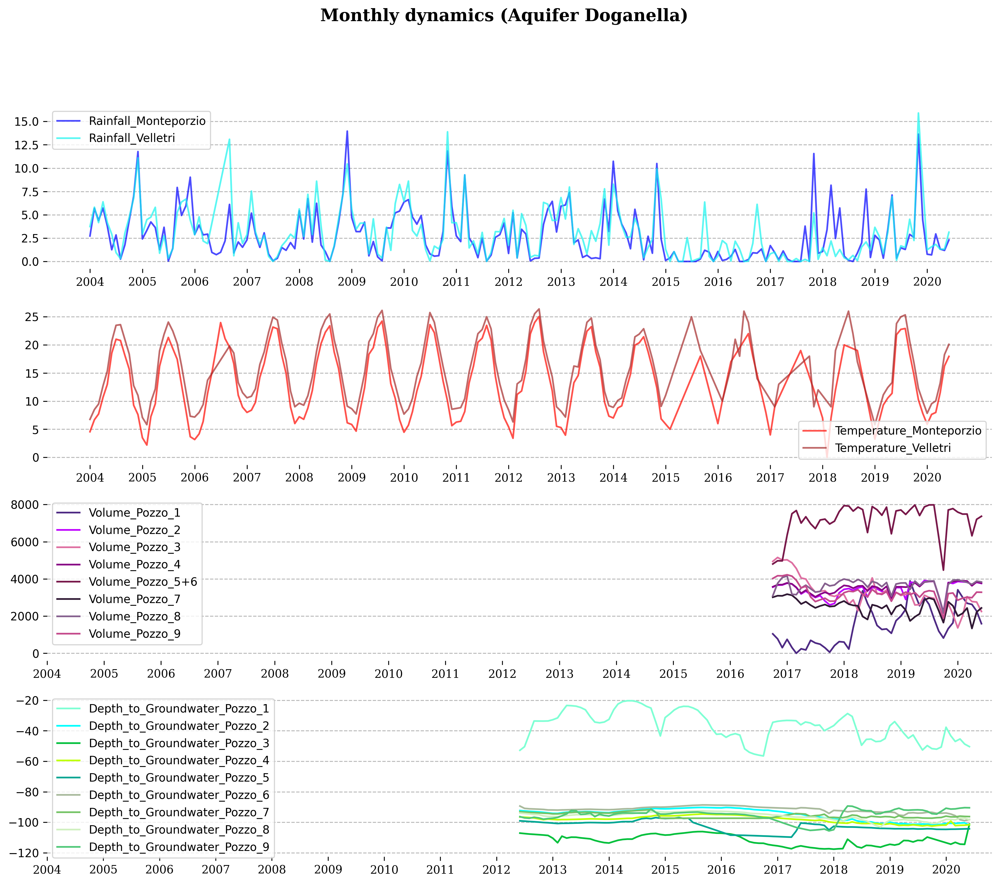

In [140]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize = (15, 12))
plt.suptitle('Monthly dynamics (Aquifer Doganella)', size = 15, fontweight = 'bold', fontfamily = 'serif')

colors = ['blue', '#15F4EE']
n = 0
for i in rainfall_col:
    sns.lineplot(data = ad_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 0.7,
                 ax = ax1)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(ad_means.month_year[::12])
ax1.set_xticklabels(range(2004, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#FF0800', '#A52A2A']
n = 0
for i in temperature_col:
    sns.lineplot(data = ad_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 0.7,
                 ax = ax2)
    n +=1

for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(ad_means.month_year[::12])
ax2.set_xticklabels(range(2004, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#4E2A84', '#BF00FF', '#DE6FA1', '#880085', '#78184A',
          '#301934', '#86608E', '#C54B8C']
n = 0
for i in volume_col:
    sns.lineplot(data = ad_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax3)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(ad_means.month_year[::12])
ax3.set_xticklabels(range(2004, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#7FFFD4', '#00FFFF', '#03C03C', '#BFFF00', '#00A693',
          '#A9BA9D', '#74C365', '#D0F0C0', '#50C878']
n = 0
for i in groundwater_col:
    sns.lineplot(data = ad_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax4)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(ad_means.month_year[::12])
ax4.set_xticklabels(range(2004, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)

plt.show()

In general, rainfall indicators are highly correlated with each other, as well as temperature indicators. The period from 2015 to 2019 has many missing values in temperature indicators. Because a significant part of the depth to groundwater and volume indicators falls on this period, in the future we may have to first predict the temperature values.

Also, from 2015 to 2018, a decrease in precipitation was observed, which to a small extent could affect the depth to groundwater.

In [142]:
# Yearly dynamics
ad_means_y = df.groupby('year').mean().reset_index()

fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize = (15, 12))
plt.suptitle('Yearly dynamics (Aquifer Doganella)', size = 15, fontweight = 'bold', fontfamily = 'serif')

colors = ['blue', '#15F4EE']
n = 0
for i in rainfall_col:
    sns.lineplot(data = ad_means_y, x = 'year', y = i, 
                 color = colors[n], label = i, alpha = 0.7,
                 ax = ax1)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(ad_means_y.year[::1])
ax1.set_xticklabels(range(2004, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#FF0800', '#A52A2A']
n = 0
for i in temperature_col:
    sns.lineplot(data = ad_means_y, x = 'year', y = i, 
                 color = colors[n], label = i, alpha = 0.7,
                 ax = ax2)
    n +=1

for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(ad_means_y.year[::1])
ax2.set_xticklabels(range(2004, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#4E2A84', '#BF00FF', '#DE6FA1', '#880085', '#78184A',
          '#301934', '#86608E', '#C54B8C']
n = 0
for i in volume_col:
    sns.lineplot(data = ad_means_y, x = 'year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax3)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(ad_means_y.year[::1])
ax3.set_xticklabels(range(2004, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#7FFFD4', '#00FFFF', '#03C03C', '#BFFF00', '#00A693',
          '#A9BA9D', '#74C365', '#D0F0C0', '#50C878']
n = 0
for i in groundwater_col:
    sns.lineplot(data = ad_means_y, x = 'year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax4)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(ad_means_y.year[::1])
ax4.set_xticklabels(range(2004, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)

plt.show()

Also, as with Aquifer Auser, many indicators of Volume (but not temperature) significantly correlate with indicators of depth to groundwater, which is quite logical, since these two indicators are mutually exclusive (an increase in depth leads to a decrease in drainage, and vice versa).

<a id="section-5"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Doganella (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

For this water body, the situation with predictors does not look entirely unambiguous. The most important indicator for aquifers - volume - is presented only for the period 2016-2020. Another indicator - temperature - for this period has a large number of missing values. Taking these features of the data into account, we will take the last five-year period for training and testing the model and exclude temperature from the number of predictors (if we look at the importance of predictors for past aquifers, temperature plays a rather insignificant role). We'll also create 'rainfal_mean', and 'volume_mean' features. Some columns with missing values will be dropped. Missing values will be fill by 'interpolate' and 'bfill' methods.

In [ ]:
AD_pred = Aquifer_Doganella[pd.to_datetime(Aquifer_Doganella.index).year >= 2016]
rainfall_col = [col for col in AD_pred.columns if 'Rainfall' in col]
volume_col = [col for col in AD_pred.columns if 'Volume' in col]

AD_pred['rainfall_mean'] = AD_pred[rainfall_col].mean(axis = 1).values
AD_pred['volume_mean'] = AD_pred[volume_col].mean(axis = 1).values
AD_pred = AD_pred.drop(['Temperature_Monteporzio', 'Temperature_Velletri'], axis = 1)
AD_pred = AD_pred.fillna(AD_pred.interpolate())
AD_pred = AD_pred.fillna(method = 'bfill')

AD_pred

Then we'll split our data on a train (67%) and a test (33%) datasets without shuffling(!).

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [ ]:
depth = [col for col in AD_pred.columns if 'Depth_to_Groundwater' in col]
y = AD_pred[depth]
X = AD_pred.drop(depth, axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.67, shuffle = False)

In [ ]:
params = {'n_estimators': 200,
          'max_depth': 2,
          'subsample': 1,
          'learning_rate': 0.04,
          'random_state': 0}

model = [XGBRegressor(**params)] * 9
for i in range(9):
    model[i] = model[i].fit(X_train, y_train.iloc[:, i])

In [ ]:
y_pred = [0] * 9

for i in range(9):
    y_pred[i] = model[i].predict(X_test)
    print('MAE value (Depth_to_Groundwater_Pozzo_{}): {}'
          .format(i + 1, round(mean_absolute_error(y_test.iloc[:, i], y_pred[i]), 4)))

All predicted indicators are in different ranges, so it is better to assess the quality of forecasts visually.

In [ ]:
for i in range(9):
    print('{}'.format(y_train.columns[i]))
    model_imp_viz(model[i], X_train, bias = 0.016)

In [ ]:
for i in range(9):
    predicted_viz(y_test.iloc[:, i], y_pred[i], '{}'.format(y_test.columns[i]), '{}'.format(y_test.columns[i]))

In [ ]:
for i in range(9):
    print('{}'.format(y_test.columns[i]))
    resid_viz(y_test.iloc[:, i], y_pred[i])

The forecasts look expectedly bad (with the exception of Depth_to_Groundwater_Pozzo_9, which is unexpectedly good). I see two main reasons for the low quality of the models: a small amount of data and a large number of missing values in this data, which, when filled, create a rather serious noise for the model.

Ideas for future improvement:

- try a deeper feature preprocessing (it might be worth trying to create a feature that will reflect seasonality, or make a more flexible replacement for missing values)
- try other algorithms
- try to predict temperature predictors at first and then use them in models.

<a id="section-twentyone"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Luco (features)</center></h2>

[**Back to the table of contents**](#section-start)

The Luco wells field is fed by an underground aquifer. This aquifer not fed by rivers or lakes but by meteoric infiltration at the extremes of the impermeable sedimentary layers. Such aquifer is accessed through wells called Well 1, Well 3 and Well 4 and is influenced by the following parameters: rainfall, depth to groundwater, temperature and drainage volumes.

[Interesting article for a more detailed study: **Studio idrogeologico dell’acquifero del Luco (Toscana, Italia)**](https://www.aigaa.org/public/GGA.2008-08.1-03.0209.pdf)

In [ ]:
df = Aquifer_Luco.reset_index()
df['year'] = pd.to_datetime(df.Date).dt.year
df['month'] = pd.to_datetime(df.Date).dt.month

# Monthly dynamics
df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))

al_means = df.groupby('month_year').mean().reset_index()
al_means['month_year'] = pd.to_datetime(al_means['month_year'])

rainfall_col = [col for col in al_means.columns if 'Rainfall' in col]
temperature_col = [col for col in al_means.columns if 'Temperature' in col]
volume_col = [col for col in al_means.columns if 'Volume' in col]
hydrometry_col = [col for col in al_means.columns if 'Hydrometry' in col]
groundwater_col = [col for col in al_means.columns if 'Depth_to_Groundwater' in col]

al_means['rainfall'] = al_means[rainfall_col].mean(axis = 1)

In [ ]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize = (15, 12))
plt.suptitle('Monthly dynamics (Aquifer Luco)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = al_means, x = 'month_year', y = 'rainfall', 
             color = 'blue', label = 'Rainfall', alpha = 0.7,
             ax = ax1)

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(al_means.month_year[::12])
ax1.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#FF0800', '#A52A2A', '#FF00FF', '#FF6347']
n = 0
for i in temperature_col:
    sns.lineplot(data = al_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 0.7,
                 ax = ax2)
    n +=1

for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(al_means.month_year[::12])
ax2.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.legend(bbox_to_anchor = (0.5, 0.1))
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#4E2A84', '#BF00FF', '#DE6FA1']
n = 0
for i in volume_col:
    sns.lineplot(data = al_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax3)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(al_means.month_year[::12])
ax3.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#7FFFD4', '#00FFFF', '#03C03C', '#BFFF00']
n = 0
for i in groundwater_col:
    sns.lineplot(data = al_means, x = 'month_year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax4)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(al_means.month_year[::12])
ax4.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)

plt.show()

The temperature dynamics have no obvious missing values, but some time periods for the two indicators have zero values that are missing values in the measurements. Volume features cover the time period from 2015 to 2020 and correlate with Depth to Groundwater features (especially with Depth_to_Groundwater_Podere_Casetta, predicted feature).

Also, high rainfall in 2013 and 2014 affected the depth to groundwater.

In [ ]:
# Yearly dynamics
al_means_y = df.groupby('year').mean().reset_index()
al_means_y['rainfall'] = al_means_y[rainfall_col].mean(axis = 1)

fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize = (15, 12))
plt.suptitle('Yearly dynamics (Aquifer Luco)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = al_means_y, x = 'year', y = 'rainfall', 
             color = 'blue', label = 'Rainfall', alpha = 0.7,
             ax = ax1)

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(al_means_y.year[::1])
ax1.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#FF0800', '#A52A2A', '#FF00FF', '#FF6347']
n = 0
for i in temperature_col:
    sns.lineplot(data = al_means_y, x = 'year', y = i, 
                 color = colors[n], label = i, alpha = 0.7,
                 ax = ax2)
    n +=1

for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(al_means_y.year[::1])
ax2.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.legend(bbox_to_anchor = (0.5, 0.1))
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#4E2A84', '#BF00FF', '#DE6FA1']
n = 0
for i in volume_col:
    sns.lineplot(data = al_means_y, x = 'year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax3)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(al_means_y.year[::1])
ax3.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)



colors = ['#7FFFD4', '#00FFFF', '#03C03C', '#BFFF00']
n = 0
for i in groundwater_col:
    sns.lineplot(data = al_means_y, x = 'year', y = i, 
                 color = colors[n], label = i, alpha = 1,
                 ax = ax4)
    n += 1

for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(al_means_y.year[::1])
ax4.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)

plt.show()

Depth_to_Groundwater_Pozzo 1, 2, and 4 only cover 3 years and are not suitable for forecasting.

<a id="section-6"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Aquifer Luco (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

Base on the previous feature overview, we'll use for prediction the data from 2008 to 2018 (because there is no data for Depth_to_Groundwater_Podere_Casetta for the 2000-2007 time period). We'll also create 'rainfal_sum', 'temperature_mean' and 'volume_mean' features. Some columns with missing values will be dropped. Missing values will be fill by 'interpolate' method.

In [ ]:
AL_pred = Aquifer_Luco.iloc[2973:-547, :]
rainfall_col = ['Rainfall_Simignano', 'Rainfall_Montalcinello', 'Rainfall_Sovicille']
temperature_col = [col for col in AL_pred.columns if 'Temperature' in col]

AL_pred['rainfall_sum'] = AL_pred[rainfall_col].sum(axis = 1).values
AL_pred['temperature_mean'] = AL_pred[temperature_col].mean(axis = 1).values
AL_pred = AL_pred.drop(['Rainfall_Siena_Poggio_al_Vento', 'Rainfall_Mensano',
                        'Rainfall_Monticiano_la_Pineta', 'Rainfall_Ponte_Orgia',
                        'Rainfall_Scorgiano', 'Rainfall_Pentolina',
                        'Rainfall_Monteroni_Arbia_Biena',
                        'Depth_to_Groundwater_Pozzo_1', 'Depth_to_Groundwater_Pozzo_3',
                        'Depth_to_Groundwater_Pozzo_4', 'Temperature_Siena_Poggio_al_Vento', 
                        'Temperature_Mensano', 'Volume_Pozzo_1',
                        'Volume_Pozzo_3', 'Volume_Pozzo_4'], axis = 1)
AL_pred = AL_pred.fillna(AL_pred.interpolate())

AL_pred

Then we'll split our data on a train (72%) and a test (28%) datasets without shuffling(!). Thus, we'll train the model on data obtained before 2015 and check it on data for 2016-2018.

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [ ]:
y = AL_pred['Depth_to_Groundwater_Podere_Casetta']
X = AL_pred.drop('Depth_to_Groundwater_Podere_Casetta', axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.7274, shuffle = False)

In [ ]:
params = {'n_estimators': 200,
          'max_depth': 2,
          'subsample': 1,
          'learning_rate': 0.03,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train)

In [ ]:
y_pred = model.predict(X_test)

print('MAE value (Depth_to_Groundwater_Podere_Casetta): %.4f' 
      %mean_absolute_error(y_test, y_pred))

The mean absolute error of the predicted values is 0.65, which means that, on average, our model make a mistake by 0.65 meters. This is not a bad result, but the dynamics of values may not look so good. 

Let's look at the feature importances.

In [ ]:
model_imp_viz(model, X_train, bias = 0.016)

In [ ]:
predicted_viz(y_test, y_pred, 'Depth_to_Groundwater_Podere_Casetta', 'Aquifer Luco')

As expected. Some periods are predicted to within a meter or even more, which is no longer a good result.

In [ ]:
resid_viz(y_test, y_pred)

There are actually quite a few reasons for the low accuracy of the base model. In my opinion, the most basic: the rather large amount of noise that appears after the replacement of missing values (especially in the predicted variable) and the absence of a drainage indicator in the model which, as we saw with the example of past aquifers, is very important for predicting the depth to groundwater.

Ideas for future improvement:
- try a deeper feature preprocessing (it might be worth trying to create a feature that will reflect seasonality, or make a more flexible replacement for missing values)
- try other algorithms
- perhaps it is still worth adding volume to the model, but then we will have little data for training since this indicator is given only for the period from 2015

<a id="section-sixteen"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Madonna di Canneto (features)</center></h2>

[**Back to the table of contents**](#section-start)

In [ ]:
df = Water_Spring_Madonna_di_Canneto[:-9].reset_index()
df['year'] = pd.to_datetime(df.Date).dt.year
df['month'] = pd.to_datetime(df.Date).dt.month

# Monthly dynamics
df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))

ws_means = df.groupby('month_year').Flow_Rate_Madonna_di_Canneto.mean().reset_index()
ws_means['month_year'] = pd.to_datetime(ws_means['month_year'])

ws_rain = np.log(df.groupby('month_year').Rainfall_Settefrati.mean()).reset_index()
ws_rain['month_year'] = pd.to_datetime(ws_rain['month_year'])

ws_temp = np.log(df.groupby('month_year').Temperature_Settefrati.mean()).reset_index()
ws_temp['month_year'] = pd.to_datetime(ws_temp['month_year'])

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize = (15, 8))
plt.suptitle('Monthly dynamics (Water Spring Madonna di Canneto)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = ws_rain, x = 'month_year', y = 'Rainfall_Settefrati', 
             color = 'gray', label = 'Rainfall Settefrati', alpha = 1,
             ax = ax1)
sns.lineplot(data = ws_temp, x = 'month_year', y = 'Temperature_Settefrati', 
             color = 'green', label = 'Temperature Settefrati', alpha = 1,
             ax = ax1)

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(ws_means.month_year[::12])
ax1.set_xticklabels(range(2012, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = ws_means, x = 'month_year', y = 'Flow_Rate_Madonna_di_Canneto', 
             color = 'blue', label = 'Flow Rate Madonna di Canneto',
             ax = ax2)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(ws_means.month_year[::12])
ax2.set_xticklabels(range(2012, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

In [ ]:
# Yearly dynamics
ws_means_y = df.groupby('year').Flow_Rate_Madonna_di_Canneto.mean().reset_index()
ws_rain_y = np.log(df.groupby('year').Rainfall_Settefrati.mean()).reset_index()
ws_temp_y = np.log(df.groupby('year').Temperature_Settefrati.mean()).reset_index()

fig, (ax1, ax2) = plt.subplots(2, 1, figsize = (15, 8))
plt.suptitle('Yearly dynamics (Water Spring Madonna di Canneto)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = ws_rain_y, x = 'year', y = 'Rainfall_Settefrati', ax = ax1, 
             color = 'gray', label = 'Rainfall Settefrati', alpha = 1)
sns.lineplot(data = ws_temp_y, x = 'year', y = 'Temperature_Settefrati', ax = ax1,
             color = 'green', label = 'Temperature Settefrati', alpha = 1)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(ws_means_y.year[::1])
ax1.set_xticklabels(range(2012, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = ws_means_y, x = 'year', y = 'Flow_Rate_Madonna_di_Canneto', 
             ax = ax2, color = 'blue', label = 'Flow Rate Madonna di Canneto')
    
for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(ws_means_y.year[::1])
ax2.set_xticklabels(range(2012, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

There are a lot of missing values in Flow_Rate_Madonna_di_Canneto feature (a feature to forecast). Because of this, it is difficult to analyze any regularities in the dynamics of this indicator. Data on all three features together is available only for the period from 2015 to 2018.

<a id="section-7"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Madonna di Canneto (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

Base on the previous feature overview, we'll use for prediction the data from 2015 to the start of 2019 (because there is no data for Flow Rate Madonna di Canneto for the 2012-2014 time period). Missing values will be fill by 'interpolate' method.

In [ ]:
WsMdC_pred = Water_Spring_Madonna_di_Canneto.iloc[1167:-520, :]

WsMdC_pred = WsMdC_pred.fillna(WsMdC_pred.interpolate())

WsMdC_pred

Then we'll split our data on a train (73%) and a test (27%) datasets without shuffling(!).

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [ ]:
y = WsMdC_pred['Flow_Rate_Madonna_di_Canneto']
X = WsMdC_pred.drop('Flow_Rate_Madonna_di_Canneto', axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.73, shuffle = False)

In [ ]:
params = {'n_estimators': 200,
          'max_depth': 3,
          'subsample': 1,
          'learning_rate': 0.05,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train)

In [ ]:
y_pred = model.predict(X_test)

print('MAE value (Flow_Rate_Madonna_di_Canneto): %.4f' 
      %mean_absolute_error(y_test, y_pred))

Our model is wrong by an average of 14. It is difficult to say yet whether this is a lot or a little.

In [ ]:
model_imp_viz(model, X_train, bias = 0.02)

Both predictors are almost equally important for the model.

In [ ]:
predicted_viz(y_test, y_pred, 'Flow_Rate_Madonna_di_Canneto', 'Water Spring Madonna di Canneto')

In [ ]:
resid_viz(y_test, y_pred)

Our model's predictions look depressingly bad. This is due not only to the small number of predictors and data for training but also to a large number of missing values, which we have to replace. There are actually not so many ways to improve the model in this situation. We can try:
- replace missing values more flexibly
- use other algorithms
- introduce additional predictors, such as the seasonality indicator.

<a id="section-seventeen"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Lupa (features)</center></h2>

[**Back to the table of contents**](#section-start)

![](https://ascelibrary.org/cms/asset/2b816701-e8ed-4b19-8ef9-561d684cfbc5/figure1.jpg)![](https://cdn.imaggeo.egu.eu/media/thumbs/previews/2020/09/22/15703.jpg.800x600_q85.jpg)

This water spring is located in the Rosciano Valley, on the left side of the Nera river. The waters emerge at an altitude of about 375 meters above sea level through a long draining tunnel that crosses, in its final section, lithotypes and essentially calcareous rocks. It provides drinking water to the city of Terni and the towns around it.

In [ ]:
df = Water_Spring_Lupa.reset_index()
df['year'] = pd.to_datetime(df.Date).dt.year
df['month'] = pd.to_datetime(df.Date).dt.month

# Monthly dynamics
df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))

wsl_means = df.groupby('month_year').Flow_Rate_Lupa.mean().reset_index()
wsl_means['month_year'] = pd.to_datetime(wsl_means['month_year'])

wsl_rain = df.groupby('month_year').Rainfall_Terni.mean().reset_index()
wsl_rain['month_year'] = pd.to_datetime(wsl_rain['month_year'])

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize = (15, 8))
plt.suptitle('Monthly dynamics (Water Spring Lupa)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = wsl_rain, x = 'month_year', y = 'Rainfall_Terni', 
             color = 'green', label = 'Rainfall Terni', alpha = 1,
             ax = ax1)

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(wsl_means.month_year[::12])
ax1.set_xticklabels(range(2009, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = wsl_means, x = 'month_year', y = 'Flow_Rate_Lupa', 
             color = 'blue', label = 'Flow Rate Lupa',
             ax = ax2)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(wsl_means.month_year[::12])
ax2.set_xticklabels(range(2009, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

In [ ]:
# Yearly dynamics
wsl_means_y = df.groupby('year').Flow_Rate_Lupa.mean().reset_index()
wsl_rain_y = df.groupby('year').Rainfall_Terni.mean().reset_index()

fig, (ax1, ax2) = plt.subplots(2, 1, figsize = (15, 8))
plt.suptitle('Yearly dynamics (Water Spring Lupa)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = wsl_rain_y, x = 'year', y = 'Rainfall_Terni', ax = ax1, 
             color = 'green', label = 'Rainfall Terni', alpha = 1)
    
for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(wsl_means_y.year[::1])
ax1.set_xticklabels(range(2009, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)


sns.lineplot(data = wsl_means_y, x = 'year', y = 'Flow_Rate_Lupa', 
             ax = ax2, color = 'blue', label = 'Flow Rate Lupa')
    
for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(wsl_means_y.year[::1])
ax2.set_xticklabels(range(2009, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)
plt.show()

In 2009, there was an interesting change in flow_rate feature (increase or decrease, there is no earlier data to answer this question). It looks like the flow rate is changing in ten-year cycles: a strong change in 2009, then small and stable changes every year until 2019, a strong change again in 2020. The significant change in 2009 could have been caused by the severe droughts of previous years. In 2007, for the area of Lupa spring, the SPI (Standardized Precipitation Index) was less than '-2', which is significantly lower than the norm.

![](https://www.researchgate.net/profile/Chong_Yu_Xu/publication/225651252/figure/tbl1/AS:667132576665611@1536068209437/The-standardized-precipitation-index-SPI-categories-based-on-the-initial-classification.png)

An interesting paper for better understanding: [Climatic characterization and response of water resources
to climate change in limestone areas: some consideration on the
importance of geological setting
](https://docs.lib.purdue.edu/cgi/viewcontent.cgi?article=1021&context=ddad2011) (see Figure 4c).

<a id="section-8"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Lupa (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

Base on the previous feature overview, we'll use for prediction all the data from 2009 to 2020. Missing values will be fill by 'interpolate' method.

In [ ]:
WsL_pred = Water_Spring_Lupa.iloc[50:, :]

WsL_pred = WsL_pred.fillna(WsL_pred.interpolate())

WsL_pred

Then we'll split our data on a train (70%) and a test (30%) datasets without shuffling(!). We have only one predictor, so the accuracy of our model can be extremely unsatisfactory.

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [ ]:
y = WsL_pred['Flow_Rate_Lupa']
X = WsL_pred.drop('Flow_Rate_Lupa', axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.70, shuffle = False)

In [ ]:
params = {'n_estimators': 200,
          'max_depth': 2,
          'subsample': 1,
          'learning_rate': 0.03,
          'random_state': 0}

model = XGBRegressor(**params)

model.fit(X_train, y_train)

In [ ]:
y_pred = model.predict(X_test)

print('MAE value (Flow_Rate_Lupa): %.4f' 
      %mean_absolute_error(y_test, y_pred))

Our model is wrong by an average of 17. It is difficult to say yet whether this is a lot or a little.

Since we have one predictor only, I see no point in visualizing importance, so let's look at the quality of the model.

In [ ]:
predicted_viz(y_test, y_pred, 'Flow_Rate_Lupa', 'Water Spring Lupa')

In [ ]:
resid_viz(y_test, y_pred)

To be honest, the expected result. The only predictor and the predicted indicator are weakly interconnected, so this method of forecasting simply does not work in this case. The best way would probably be to predict Flow_Rate as a timeseries.

<a id="section-eighteen"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Amiata (features)</center></h2>

[**Back to the table of contents**](#section-start)

![](https://ars.els-cdn.com/content/image/1-s2.0-S0048969703005953-gr1.jpg)
Source: [Heavy metals in drinking waters from Mount Amiata (Tuscany, Italy). Possible risks from arsenic for public health in the Province of Siena](https://www.sciencedirect.com/science/article/abs/pii/S0048969703005953)

![](https://www.bookingamiata.com/wp-content/uploads/2018/11/Amiata-Water-Spring.jpg)
Source: [Mount Amiata website](https://www.bookingamiata.com/en/discover-mount-amiata/)

The Amiata waterbody is composed of a volcanic aquifer not fed by rivers or lakes but fed by meteoric infiltration. This aquifer is accessed through Ermicciolo, Arbure, Bugnano and Galleria Alta water springs. The levels and volumes of the four sources are influenced by the parameters: rainfall, depth to groundwater, hydrometry, temperatures and drainage volumes.

In [ ]:
df = Water_Spring_Amiata.reset_index()
df['year'] = pd.to_datetime(df.Date).dt.year
df['month'] = pd.to_datetime(df.Date).dt.month

# Monthly dynamics
df['month_year'] = pd.to_datetime(df.Date).apply(lambda x: x.strftime('%Y/%m'))

wsa_means = df.groupby('month_year').mean().reset_index()
wsa_means['month_year'] = pd.to_datetime(wsa_means['month_year'])

In [ ]:
fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize = (15, 12))
plt.suptitle('Monthly dynamics (Water Spring Amiata)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = wsa_means, x = 'month_year', y = 'Rainfall_Castel_del_Piano', 
             color = 'blue', label = 'Rainfall Castel del Piano', alpha = 1,
             ax = ax1)
sns.lineplot(data = wsa_means, x = 'month_year', y = 'Rainfall_Abbadia_S_Salvatore', 
             color = '#63C5DA', label = 'Rainfall Abbadia S Salvatore', alpha = 0.4,
             ax = ax1)
sns.lineplot(data = wsa_means, x = 'month_year', y = 'Rainfall_S_Fiora', 
             color = '#1F456E', label = 'Rainfall S Fiora', alpha = 0.4,
             ax = ax1)
sns.lineplot(data = wsa_means, x = 'month_year', y = 'Rainfall_Laghetto_Verde', 
             color = '#59788E', label = 'Rainfall Laghetto Verde', alpha = 0.4,
             ax = ax1)
sns.lineplot(data = wsa_means, x = 'month_year', y = 'Rainfall_Vetta_Amiata', 
             color = '#281E5D', label = 'Rainfall Vetta Amiata', alpha = 0.4,
             ax = ax1)

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(wsa_means.month_year[::12])
ax1.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = wsa_means, x = 'month_year', y = 'Temperature_S_Fiora', 
             color = 'red', label = 'Temperature S Fiora', alpha = 1,
             ax = ax2)
sns.lineplot(data = wsa_means, x = 'month_year', y = 'Temperature_Abbadia_S_Salvatore', 
             color = '#FA8072', label = 'Temperature Abbadia S Salvatore', alpha = 0.4,
             ax = ax2)

for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(wsa_means.month_year[::12])
ax2.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = wsa_means, x = 'month_year', y = 'Depth_to_Groundwater_S_Fiora_8', 
             color = 'green', label = 'Depth to Groundwater S Fiora 8', alpha = 1,
             ax = ax3)
sns.lineplot(data = wsa_means, x = 'month_year', y = 'Depth_to_Groundwater_S_Fiora_11bis', 
             color = '#C7EA46', label = 'Depth to Groundwater S Fiora 11bis', alpha = 0.4,
             ax = ax3)
sns.lineplot(data = wsa_means, x = 'month_year', y = wsa_means.Depth_to_Groundwater_David_Lazzaretti / 10, 
             color = '#708238', label = 'Depth to Groundwater David Lazzaretti', alpha = 0.4,
             ax = ax3)

for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(wsa_means.month_year[::12])
ax3.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = wsa_means, x = 'month_year', y = 'Flow_Rate_Arbure', 
             color = '#8D4004', label = 'Flow Rate Arbure', alpha = 0.4,
             ax = ax4)
sns.lineplot(data = wsa_means, x = 'month_year', y = 'Flow_Rate_Ermicciolo', 
             color = '#FDA172', label = 'Flow Rate Ermicciolo', alpha = 0.4,
             ax = ax4)
sns.lineplot(data = wsa_means, x = 'month_year', y = 'Flow_Rate_Bugnano', 
             color = 'yellow', label = 'Flow Rate Bugnano', alpha = 0.4,
             ax = ax4)
sns.lineplot(data = wsa_means, x = 'month_year', y = wsa_means.Flow_Rate_Galleria_Alta / 10, 
             color = 'orange', label = 'Flow Rate Galleria Alta', alpha = 1,
             ax = ax4)

for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(wsa_means.month_year[::12])
ax4.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)

plt.show()

All data (except for some features) has many missing values. The most useful for prediction are Rainfall_Castel_del_Piano and Temperature_S_Fiora as the most complete. The dynamics of all other indicators of rainfall and temperature are similar to them. Therefore, we can use these two features to predict or will try to replace all missing values in other columns using linear regression (given the long period for which there is no data, I don't think this method would be a good idea).

Among the indicators of the depth to groundwater, Depth_to_Groundwater_S_Fiora_8 and Depth_to_Groundwater_S_Fiora_11bis are more preferable. They have fewer missing values and represent a longer period of time (2009 to 2020).

All predicted features of flow rates have many missing values. All of them represent almost six years (2015-2020) - less than a third of the study period.

In [ ]:
# Yearly dynamics
wsa_means_y = df.groupby('year').mean().reset_index()

fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize = (15, 12))
plt.suptitle('Yearly dynamics (Water Spring Amiata)', size = 15, fontweight = 'bold', fontfamily = 'serif')

sns.lineplot(data = wsa_means_y, x = 'year', y = 'Rainfall_Castel_del_Piano', 
             color = 'blue', label = 'Rainfall Castel del Piano', alpha = 1,
             ax = ax1)
sns.lineplot(data = wsa_means_y, x = 'year', y = 'Rainfall_Abbadia_S_Salvatore', 
             color = '#63C5DA', label = 'Rainfall Abbadia S Salvatore', alpha = 0.4,
             ax = ax1)
sns.lineplot(data = wsa_means_y, x = 'year', y = 'Rainfall_S_Fiora', 
             color = '#1F456E', label = 'Rainfall S Fiora', alpha = 0.4,
             ax = ax1)
sns.lineplot(data = wsa_means_y, x = 'year', y = 'Rainfall_Laghetto_Verde', 
             color = '#59788E', label = 'Rainfall Laghetto Verde', alpha = 0.4,
             ax = ax1)
sns.lineplot(data = wsa_means_y, x = 'year', y = 'Rainfall_Vetta_Amiata', 
             color = '#281E5D', label = 'Rainfall Vetta Amiata', alpha = 0.4,
             ax = ax1)

for i in ['top', 'right', 'bottom', 'left']:
        ax1.spines[i].set_visible(False)

ax1.set_xticks(wsa_means_y.year[::1])
ax1.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax1.set_xlabel('')
ax1.set_ylabel('')
ax1.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = wsa_means_y, x = 'year', y = 'Temperature_S_Fiora', 
             color = 'red', label = 'Temperature S Fiora', alpha = 1,
             ax = ax2)
sns.lineplot(data = wsa_means_y, x = 'year', y = 'Temperature_Abbadia_S_Salvatore', 
             color = '#FA8072', label = 'Temperature Abbadia S Salvatore', alpha = 0.4,
             ax = ax2)

for i in ['top', 'right', 'bottom', 'left']:
        ax2.spines[i].set_visible(False)

ax2.set_xticks(wsa_means_y.year[::1])
ax2.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax2.set_xlabel('')
ax2.set_ylabel('')
ax2.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = wsa_means_y, x = 'year', y = 'Depth_to_Groundwater_S_Fiora_8', 
             color = 'green', label = 'Depth to Groundwater S Fiora 8', alpha = 1,
             ax = ax3)
sns.lineplot(data = wsa_means_y, x = 'year', y = 'Depth_to_Groundwater_S_Fiora_11bis', 
             color = '#C7EA46', label = 'Depth to Groundwater S Fiora 11bis', alpha = 0.4,
             ax = ax3)
sns.lineplot(data = wsa_means_y, x = 'year', y = wsa_means_y.Depth_to_Groundwater_David_Lazzaretti / 10, 
             color = '#708238', label = 'Depth to Groundwater David Lazzaretti', alpha = 0.4,
             ax = ax3)

for i in ['top', 'right', 'bottom', 'left']:
        ax3.spines[i].set_visible(False)

ax3.set_xticks(wsa_means_y.year[::1])
ax3.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax3.set_xlabel('')
ax3.set_ylabel('')
ax3.grid(axis = 'y', linestyle = '--', alpha = 0.9)



sns.lineplot(data = wsa_means_y, x = 'year', y = 'Flow_Rate_Arbure', 
             color = '#8D4004', label = 'Flow Rate Arbure', alpha = 0.4,
             ax = ax4)
sns.lineplot(data = wsa_means_y, x = 'year', y = 'Flow_Rate_Ermicciolo', 
             color = '#FDA172', label = 'Flow Rate Ermicciolo', alpha = 0.4,
             ax = ax4)
sns.lineplot(data = wsa_means_y, x = 'year', y = 'Flow_Rate_Bugnano', 
             color = 'yellow', label = 'Flow Rate Bugnano', alpha = 0.4,
             ax = ax4)
sns.lineplot(data = wsa_means_y, x = 'year', y = wsa_means_y.Flow_Rate_Galleria_Alta / 10, 
             color = 'orange', label = 'Flow Rate Galleria Alta', alpha = 1,
             ax = ax4)

for i in ['top', 'right', 'bottom', 'left']:
        ax4.spines[i].set_visible(False)

ax4.set_xticks(wsa_means_y.year[::1])
ax4.set_xticklabels(range(2000, 2021, 1), fontfamily = 'serif')
ax4.set_xlabel('')
ax4.set_ylabel('')
ax4.grid(axis = 'y', linestyle = '--', alpha = 0.9)

plt.show()

In general, the data show the same logical dependencies of flow rate and depth to groundwater on rainfall. There is an interesting drop in the average annual temperature in 2019.

<a id="section-9"></a>
<h2 style='color:#50A8E3; background:white; border:2px solid #50A8E3'><center>Water Spring Amiata (prediction)</center></h2>

[**Back to the table of contents**](#section-start)

Base on the previous feature overview, we know that the predicted indicators are presented in a relatively short period of time. We will train and test the model on tiny data chunks (2015-2017 and 2018-2020). Some columns with missing values will be dropped. Missing values will be fill by 'interpolate' method. We'll also create 'rainfal_mean' and 'temperature_mean' features.

In [ ]:
WsA_pred = Water_Spring_Amiata[pd.to_datetime(Water_Spring_Amiata.index).year >= 2015]
rainfall_col = [col for col in WsA_pred.columns if 'Rainfall' in col]
temperature_col = [col for col in WsA_pred.columns if 'Temperature' in col]

WsA_pred['rainfall_mean'] = WsA_pred[rainfall_col].mean(axis = 1).values
WsA_pred['temperature_mean'] = WsA_pred[temperature_col].mean(axis = 1).values
WsA_pred = WsA_pred.drop(['Depth_to_Groundwater_S_Fiora_8', 'Depth_to_Groundwater_S_Fiora_11bis',
                          'Rainfall_S_Fiora', 'Rainfall_Vetta_Amiata'], axis = 1)
WsA_pred = WsA_pred.fillna(WsA_pred.interpolate())

WsA_pred

Then we'll split our data on a train (50%) and a test (50%) datasets without shuffling(!). Thus, we'll train the model on two 3-year periods.

I chose XGB as the most popular, and one of the most powerful algorithms. It also does not require data normalization. Parameters for the model were chosen after some experiments.

In [ ]:
y = WsA_pred[['Flow_Rate_Bugnano', 'Flow_Rate_Arbure', 
             'Flow_Rate_Ermicciolo', 'Flow_Rate_Galleria_Alta']]
X = WsA_pred.drop(['Flow_Rate_Bugnano', 'Flow_Rate_Arbure', 
                   'Flow_Rate_Ermicciolo', 'Flow_Rate_Galleria_Alta'], axis = 1)

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.5, shuffle = False)

In [ ]:
params = {'n_estimators': 150,
            'max_depth': 5,
            'subsample': 1,
            'learning_rate': 0.03,
            'random_state': 0}

model_0 = XGBRegressor(**params)
model_1 = XGBRegressor(**params)
model_2 = XGBRegressor(**params)
model_3 = XGBRegressor(**params)

model_0.fit(X_train, y_train.iloc[:, 0])
model_1.fit(X_train, y_train.iloc[:, 1])
model_2.fit(X_train, y_train.iloc[:, 2])
model_3.fit(X_train, y_train.iloc[:, 3])

In [ ]:
y_pred_0 = model_0.predict(X_test)
y_pred_1 = model_1.predict(X_test)
y_pred_2 = model_2.predict(X_test)
y_pred_3 = model_3.predict(X_test)

print('MAE value (Flow_Rate_Bugnano): %.4f' 
      %mean_absolute_error(y_test.iloc[:, 0], y_pred_0))
print('MAE value (Flow_Rate_Arbure): %.4f' 
      %mean_absolute_error(y_test.iloc[:, 1], y_pred_1))
print('MAE value (Flow_Rate_Ermicciolo): %.4f' 
      %mean_absolute_error(y_test.iloc[:, 2], y_pred_2))
print('MAE value (Flow_Rate_Galleria_Alta): %.4f' 
      %mean_absolute_error(y_test.iloc[:, 3], y_pred_3))

Each predicted indicator is in its own range of values, so we can assess the accuracy only by visualizing the forecasts.

In [ ]:
print('Flow_Rate_Bugnano')
model_imp_viz(model_0, X_train, bias = 0.016)

print('Flow_Rate_Arbure')
model_imp_viz(model_1, X_train, bias = 0.016)

print('Flow_Rate_Ermicciolo')
model_imp_viz(model_2, X_train, bias = 0.016)

print('Flow_Rate_Galleria_Alta')
model_imp_viz(model_3, X_train, bias = 0.016)

For all models, the most important predictor is depth to groundwater.

In [ ]:
predicted_viz(y_test.iloc[:, 0], y_pred_0, 'Flow_Rate_Bugnano', 'Water Spring Amiata')
predicted_viz(y_test.iloc[:, 1], y_pred_1, 'Flow_Rate_Arbure', 'Water Spring Amiata')
predicted_viz(y_test.iloc[:, 2], y_pred_2, 'Flow_Rate_Ermicciolo', 'Water Spring Amiata')
predicted_viz(y_test.iloc[:, 3], y_pred_3, 'Flow_Rate_Galleria_Alta', 'Water Spring Amiata')

In [ ]:
print('Flow_Rate_Bugnano')
resid_viz(y_test.iloc[:, 0], y_pred_0)

print('Flow_Rate_Arbure')
resid_viz(y_test.iloc[:, 1], y_pred_1)

print('Flow_Rate_Ermicciolo')
resid_viz(y_test.iloc[:, 2], y_pred_2)

print('Flow_Rate_Galleria_Alta')
resid_viz(y_test.iloc[:, 3], y_pred_3)

Overall, the predictions are not as bad as I expected. Like all previous models, these do not cope well with peaks, and also strongly average the overall dynamics. More training data can remedy this situation. Also worth trying:

- try a deeper feature preprocessing;
- try other algorithms

<h1 style='color:white; background:#50A8E3; border:0'><center>A few words at the end</center></h1>

The purpose of this notebook was to analyze all nine water bodies in general and build basic models, which are naturally not optimal. For each water body, a deeper search for patterns and an individual approach is needed (including the choice of algorithms for forecasting). This notebook is designed as a starting point for more serious research into the problems posed by this competition.

**I hope my work was helpful to you. Good luck!**

<h1 style='color:white; background:#50A8E3; border:0'><center>THANKS FOR ATTENTION!</center></h1>

[**Back to the table of contents**](#section-start)